In [1]:
import torch
import torchvision
from torch import nn
from torch.autograd import Variable
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.utils import save_image
from torchvision.datasets import MNIST
import os
from torchvision.datasets import DatasetFolder
import numpy as np
from matplotlib import pyplot as plt
from pathlib import Path
from collections import defaultdict
import pandas as pd
from sklearn.model_selection import GroupKFold,GroupShuffleSplit
from torch.utils.tensorboard import SummaryWriter

In [2]:
# def crop_and_pad(array, size=224):
#     last_size =array.shape[-1]
#     if last_size>size:
#         return array[:,:,:size]
#     else:
#         new_array =np.zeros((array.shape[0], array.shape[1], size))
#         new_array[:,:,:last_size] =array
#         return new_array

## Preparing train and  val dataset

In [3]:
base =defaultdict(list)
for path in Path('novoss_spectrums_short').iterdir():
    if path.stem!=".DS_Store":
        for file in path.iterdir():
            if file.stem!=".DS_Store":
                base['diagnosis'].append(path.stem)
                base['file'].append(file)
                base['unique_id'].append(path.stem +"_"+file.stem.split('_')[0])

In [4]:
dataframe =pd.DataFrame.from_dict(dict(base))

In [5]:
dataframe.shape

(2006, 3)

In [14]:
dataframe =dataframe.sample(frac=1).reset_index(drop =True)

In [15]:
dataframe

,diagnosis,file,unique_id
0,MDD,novoss_spectrums_short/MDD/D_NOV_314_D_Nov_P_0...,MDD_D
1,MDD,novoss_spectrums_short/MDD/D_NOV_312_D_Nov_P_0...,MDD_D
2,Health,novoss_spectrums_short/Health/CO_%D1%833_92_Co...,Health_CO
3,Health,novoss_spectrums_short/Health/CO_Y3_162_Co_y3_...,Health_CO
4,Health,novoss_spectrums_short/Health/D_TUV_332_D_Tuv_...,Health_D
...,...,...,...
2001,Health,novoss_spectrums_short/Health/TUV_16_364_Fon1_...,Health_TUV
2002,Health,novoss_spectrums_short/Health/CO_Y3_142_Co_y3_...,Health_CO
2003,MDD,novoss_spectrums_short/MDD/D_NOV_279_D_Nov_P_0...,MDD_D
2004,MDD,novoss_spectrums_short/MDD/D_NOV_276_D_Nov_P_0...,MDD_D


In [21]:
#train_data =pd.read_csv('spectrums_short/train.csv')

In [22]:
group_kfold = GroupShuffleSplit(n_splits=2, train_size=0.8)
group_kfold.get_n_splits(X=dataframe, y=None, groups=dataframe['unique_id'])

2

In [23]:
for train_index, test_index in group_kfold.split(dataframe, None, dataframe['unique_id']):
        print("TRAIN:", train_index, "TEST:", test_index)
        dataframe_train, dataframe_test = dataframe.iloc[train_index], dataframe.iloc[test_index]


TRAIN: [   2    3    4    5    7    9   10   11   15   17   19   21   22   27
   33   34   36   39   42   43   45   46   48   49   51   52   53   57
   58   61   62   64   69   71   72   73   77   79   81   84   86   87
   88   89   90   93   97   98   99  100  101  103  105  106  110  112
  113  121  122  123  124  126  127  128  131  134  135  136  139  141
  143  146  149  151  154  155  156  158  160  161  162  165  166  170
  171  172  173  174  176  177  178  179  181  182  183  185  186  187
  188  190  192  193  194  197  199  200  201  204  206  208  209  210
  211  217  218  221  222  223  224  225  229  230  231  234  235  240
  241  244  247  248  250  253  259  263  264  265  266  267  269  271
  275  276  278  280  283  284  285  286  288  292  293  295  296  297
  298  299  301  302  305  306  309  312  314  317  324  325  326  328
  329  330  331  334  335  338  339  342  346  347  348  351  353  356
  359  363  367  369  370  372  373  375  376  379  382  384  388  389

In [24]:
dataframe_train.to_csv('spectrums_short/train2.csv', index=False)
dataframe_test.to_csv('spectrums_short/val2.csv', index=False)

In [62]:
dataframe_test

,diagnosis,file,unique_id
4,Health,spectrums_short/Health/F125_0.npy,Health_F125
5,Health,spectrums_short/Health/F127_0.npy,Health_F127
7,Health,spectrums_short/Health/M154_2.npy,Health_M154
14,Health,spectrums_short/Health/F117_0.npy,Health_F117
27,Health,spectrums_short/Health/F139_2.npy,Health_F139
...,...,...,...
290,Health,spectrums_short/Health/F116_1.npy,Health_F116
291,MDD,spectrums_short/MDD/M336_1.npy,MDD_M336
292,MDD,spectrums_short/MDD/S951_0.npy,MDD_S951
293,Health,spectrums_short/Health/F139_0.npy,Health_F139


## Training 2D autoencoder on EEG spectrum data

In [6]:
class EEGDataset(Dataset):
    def __init__(self, csv_file, transform=None):

        self.data = pd.read_csv(csv_file)
        self.diagnosis_map ={'MDD': 1.0, 'Health': 0.0}
        self.transform =transform

    def __len__(self):
        return self.data.shape[0]

    def __getitem__(self, idx):

        raw = self.data.iloc[idx]
        eeg =np.load(raw['file'])
        label =self.diagnosis_map[raw['diagnosis']]
      
        if self.transform:
            eeg = self.transform(eeg)

        return eeg, label

In [7]:
train_dataset =EEGDataset('spectrums_short/train.csv')
val_dataset =EEGDataset('spectrums_short/val.csv')

In [8]:
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, drop_last = False)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, drop_last = True)

In [9]:
class EEGAutoencoder(nn.Module):
    def __init__(self):
        super(EEGAutoencoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(15, 16, 3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.ELU(True),
            nn.MaxPool2d(2, stride=2),  # b, 16, 5, 5
            nn.Conv2d(16, 8, 3, stride=1, padding=1),  # b, 8, 3, 3
            nn.BatchNorm2d(8),
            nn.ELU(True),
            nn.MaxPool2d(2, stride=2),  # b, 8, 2, 2
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(8, 16, 2, stride=2),  # b, 16, 5, 5
            nn.ELU(True),
            nn.BatchNorm2d(16),
            nn.ConvTranspose2d(16, 15, 2, stride=2),  # b, 8, 15, 15
            nn.BatchNorm2d(15),
            nn.ELU(True)
        )
        self.pool =nn.AdaptiveAvgPool2d((8,8))
        self.fc = nn.Linear(8*64, 2)


    def forward(self, x):
        original_shapes =x.shape
        codes = self.encoder(x)
        classes =self.pool(codes)
        classes =self.fc(classes.view(-1,8*8*8))
        
        x = self.decoder(codes)
        x =nn.functional.interpolate(x, size=original_shapes[2:])
        return codes,x,classes

learning_rate =0.001
num_epochs =800

In [10]:
learning_rate =0.0001
num_epochs =500

In [11]:
## 0.001 -the best 

In [92]:
model = EEGAutoencoder().cuda()
criterion = nn.MSELoss()
cr_loss = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate,
                             weight_decay=1e-1)

In [93]:
batch, labels =next(iter(train_loader))

In [94]:
batch =batch.float().cuda()

In [95]:
def plot_batch_and_outputs(batch, outputs, show_type ='img'):
    Y_ticks =np.linspace(0, 128, num=98)
    X_ticks =np.linspace(0, 45, num=24)
    random_channel =np.random.randint(batch.shape[1])
    levels =45
    
    if show_type =='img':
        print('True: ')
        spectrum = plt.imshow(batch[0,random_channel,:,:].detach().cpu().numpy(),cmap='jet')
        plt.show()
        print('Predicted: ')
        spectrum = plt.imshow(outputs[0,random_channel,:,:].detach().cpu().numpy(), cmap='jet')
        plt.show()
    else:
        spectrum = plt.contourf(Y_ticks,X_ticks,batch[0,random_channel,:,:].detach().cpu().numpy(),levels, cmap='jet')
        plt.show()
        print('Predicted: ')
        spectrum = plt.contourf(Y_ticks,X_ticks,outputs[0,random_channel,:,:].detach().cpu().numpy(),levels, cmap='jet')
        plt.show()

In [96]:
codes,output, pred =model(batch)

In [97]:
batch.shape

torch.Size([4, 15, 24, 98])

In [98]:
98/2

49.0

In [99]:
output.shape

torch.Size([4, 15, 24, 98])

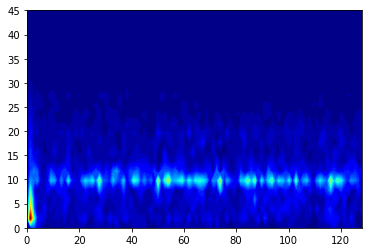

Predicted: 


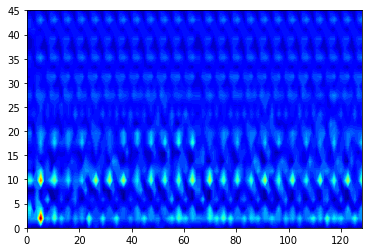

In [100]:
plot_batch_and_outputs(batch, output,show_type ='c')

In [101]:
writer = SummaryWriter('runs/base_autoencoder_v3')

epoch [1/500], train loss:0.7466
epoch [1/500], val loss:1.8853
epoch [1/500], train accuracy:0.5000
epoch [1/500], val accuracy:0.4853


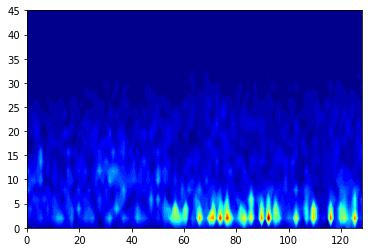

Predicted: 


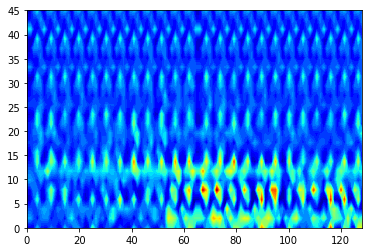

epoch [2/500], train loss:0.7422
epoch [2/500], val loss:1.8792
epoch [2/500], train accuracy:0.4655
epoch [2/500], val accuracy:0.4853


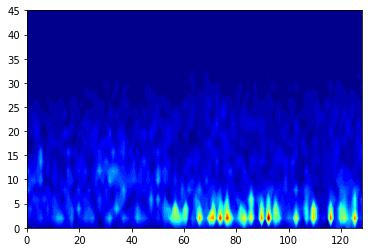

Predicted: 


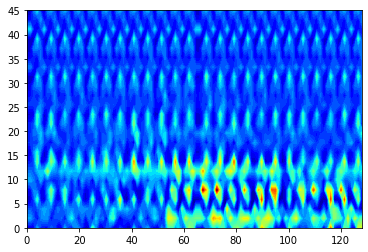

epoch [3/500], train loss:0.7333
epoch [3/500], val loss:1.8732
epoch [3/500], train accuracy:0.4871
epoch [3/500], val accuracy:0.4706


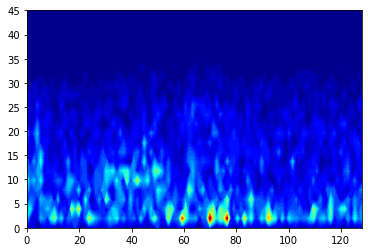

Predicted: 


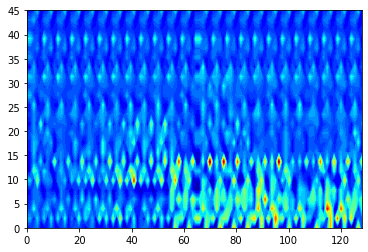

epoch [4/500], train loss:0.7286
epoch [4/500], val loss:1.8684
epoch [4/500], train accuracy:0.5086
epoch [4/500], val accuracy:0.4853


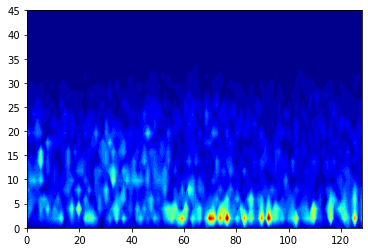

Predicted: 


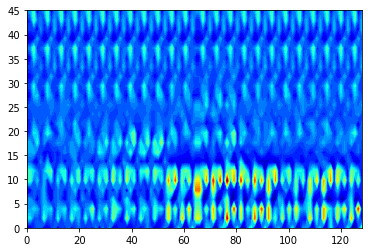

epoch [5/500], train loss:0.7238
epoch [5/500], val loss:1.8644
epoch [5/500], train accuracy:0.5259
epoch [5/500], val accuracy:0.4853


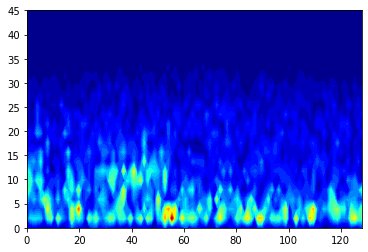

Predicted: 


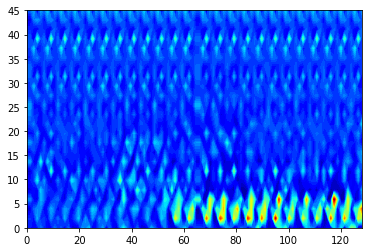

epoch [6/500], train loss:0.7202
epoch [6/500], val loss:1.8600
epoch [6/500], train accuracy:0.4957
epoch [6/500], val accuracy:0.4853


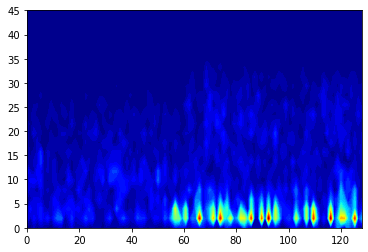

Predicted: 


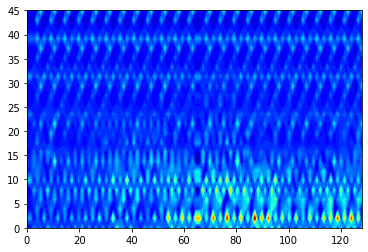

epoch [7/500], train loss:0.7164
epoch [7/500], val loss:1.8560
epoch [7/500], train accuracy:0.5172
epoch [7/500], val accuracy:0.4853


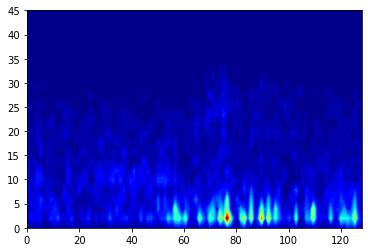

Predicted: 


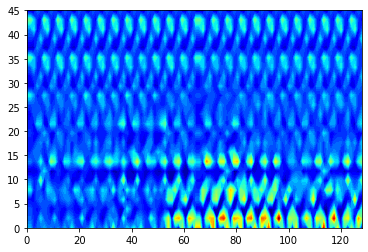

epoch [8/500], train loss:0.7118
epoch [8/500], val loss:1.8521
epoch [8/500], train accuracy:0.5086
epoch [8/500], val accuracy:0.4853


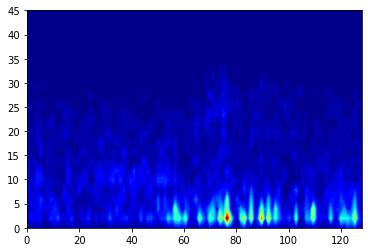

Predicted: 


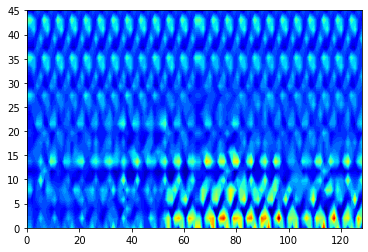

epoch [9/500], train loss:0.7106
epoch [9/500], val loss:1.8476
epoch [9/500], train accuracy:0.5129
epoch [9/500], val accuracy:0.5000


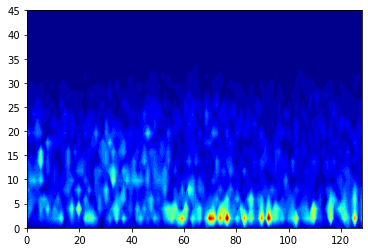

Predicted: 


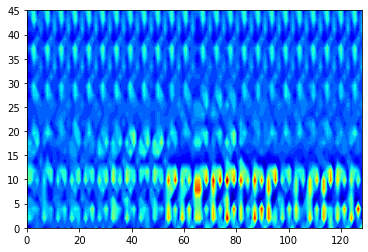

epoch [10/500], train loss:0.7066
epoch [10/500], val loss:1.8442
epoch [10/500], train accuracy:0.5388
epoch [10/500], val accuracy:0.4853


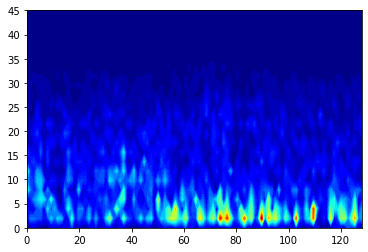

Predicted: 


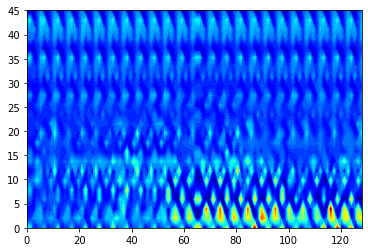

epoch [11/500], train loss:0.7029
epoch [11/500], val loss:1.8404
epoch [11/500], train accuracy:0.5302
epoch [11/500], val accuracy:0.5000


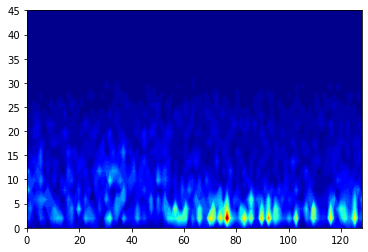

Predicted: 


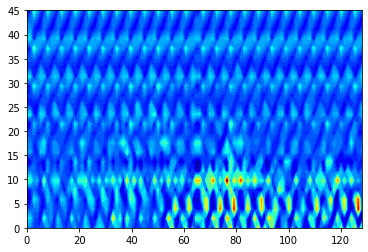

epoch [12/500], train loss:0.7045
epoch [12/500], val loss:1.8369
epoch [12/500], train accuracy:0.5388
epoch [12/500], val accuracy:0.4853


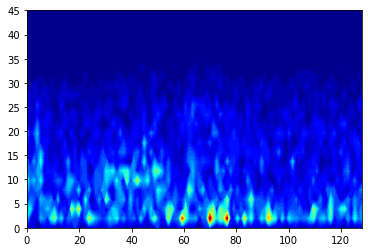

Predicted: 


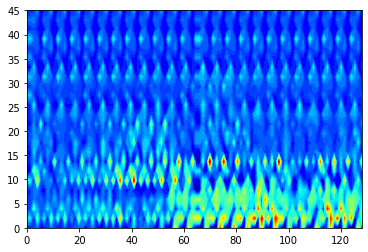

epoch [13/500], train loss:0.6942
epoch [13/500], val loss:1.8333
epoch [13/500], train accuracy:0.5259
epoch [13/500], val accuracy:0.5000


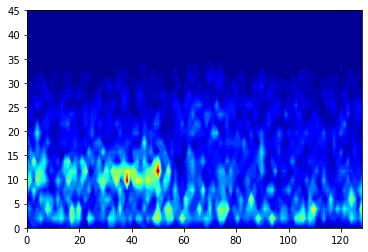

Predicted: 


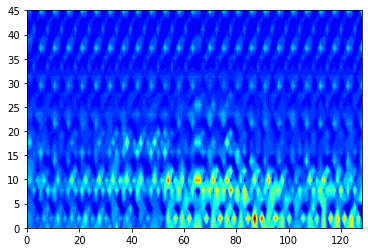

epoch [14/500], train loss:0.6919
epoch [14/500], val loss:1.8298
epoch [14/500], train accuracy:0.5216
epoch [14/500], val accuracy:0.5000


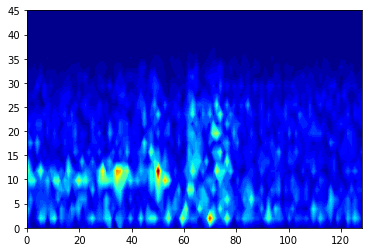

Predicted: 


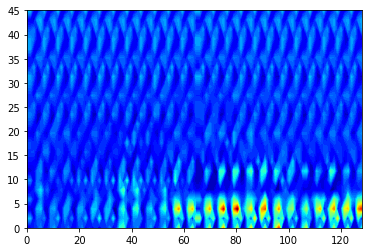

epoch [15/500], train loss:0.6848
epoch [15/500], val loss:1.8262
epoch [15/500], train accuracy:0.5560
epoch [15/500], val accuracy:0.5000


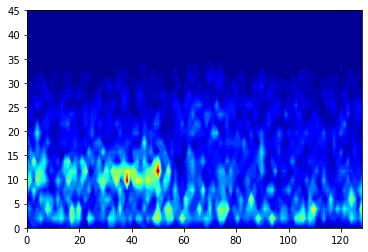

Predicted: 


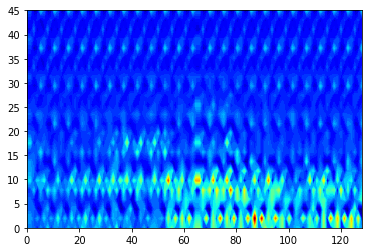

epoch [16/500], train loss:0.6847
epoch [16/500], val loss:1.8229
epoch [16/500], train accuracy:0.5603
epoch [16/500], val accuracy:0.5147


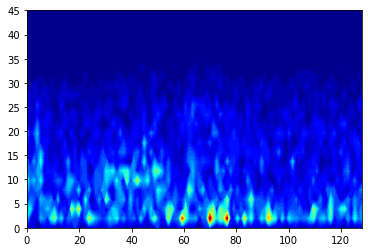

Predicted: 


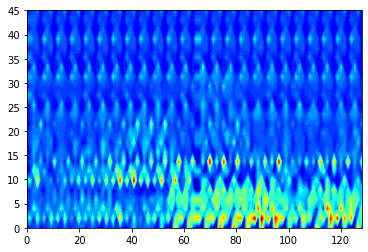

epoch [17/500], train loss:0.6835
epoch [17/500], val loss:1.8203
epoch [17/500], train accuracy:0.5302
epoch [17/500], val accuracy:0.4853


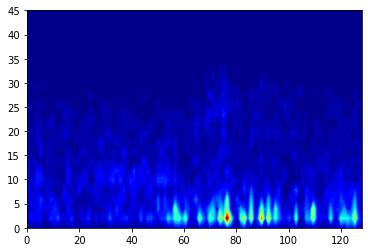

Predicted: 


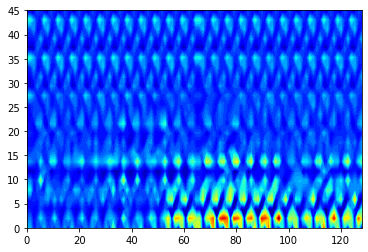

epoch [18/500], train loss:0.6765
epoch [18/500], val loss:1.8171
epoch [18/500], train accuracy:0.5474
epoch [18/500], val accuracy:0.5000


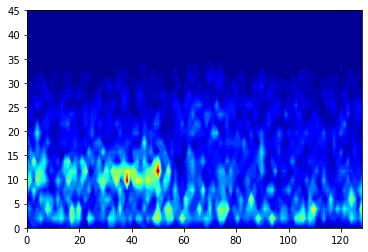

Predicted: 


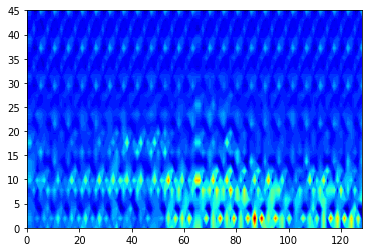

epoch [19/500], train loss:0.6741
epoch [19/500], val loss:1.8138
epoch [19/500], train accuracy:0.5560
epoch [19/500], val accuracy:0.5000


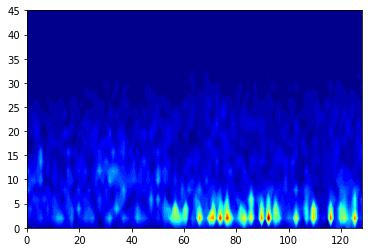

Predicted: 


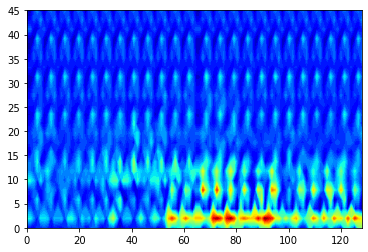

epoch [20/500], train loss:0.6727
epoch [20/500], val loss:1.8106
epoch [20/500], train accuracy:0.5474
epoch [20/500], val accuracy:0.5000


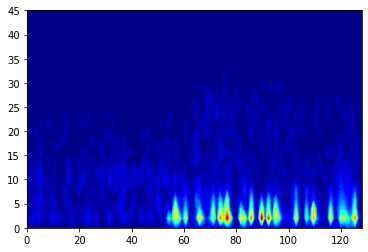

Predicted: 


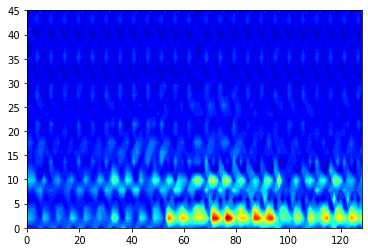

epoch [21/500], train loss:0.6698
epoch [21/500], val loss:1.8073
epoch [21/500], train accuracy:0.5647
epoch [21/500], val accuracy:0.5147


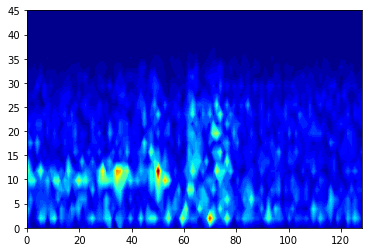

Predicted: 


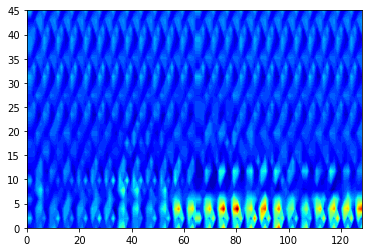

epoch [22/500], train loss:0.6666
epoch [22/500], val loss:1.8044
epoch [22/500], train accuracy:0.5474
epoch [22/500], val accuracy:0.5147


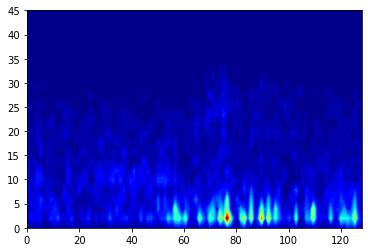

Predicted: 


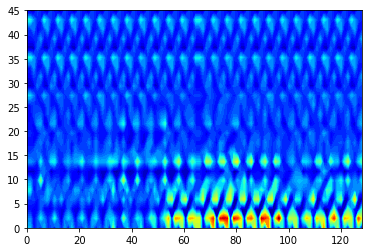

epoch [23/500], train loss:0.6617
epoch [23/500], val loss:1.8011
epoch [23/500], train accuracy:0.5776
epoch [23/500], val accuracy:0.5294


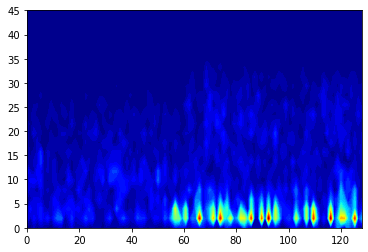

Predicted: 


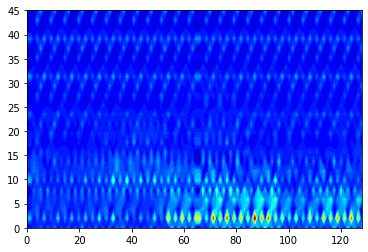

epoch [24/500], train loss:0.6603
epoch [24/500], val loss:1.7988
epoch [24/500], train accuracy:0.5647
epoch [24/500], val accuracy:0.5000


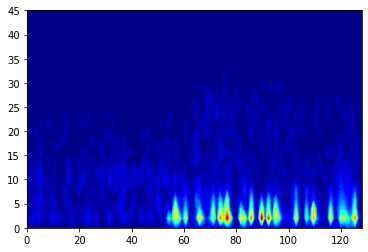

Predicted: 


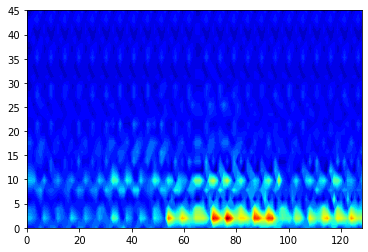

epoch [25/500], train loss:0.6595
epoch [25/500], val loss:1.7959
epoch [25/500], train accuracy:0.5603
epoch [25/500], val accuracy:0.5000


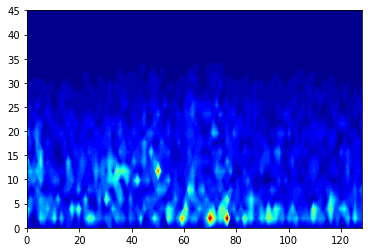

Predicted: 


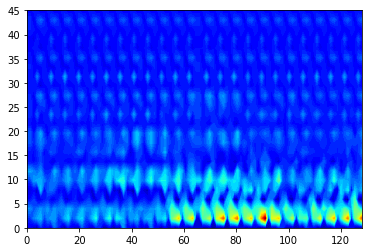

epoch [26/500], train loss:0.6559
epoch [26/500], val loss:1.7923
epoch [26/500], train accuracy:0.5690
epoch [26/500], val accuracy:0.5147


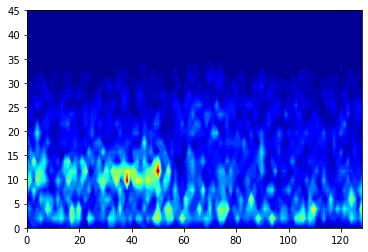

Predicted: 


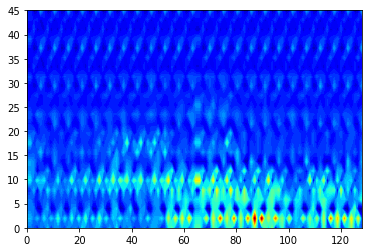

epoch [27/500], train loss:0.6495
epoch [27/500], val loss:1.7899
epoch [27/500], train accuracy:0.5819
epoch [27/500], val accuracy:0.5147


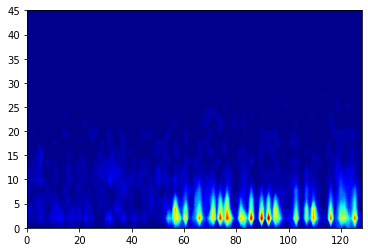

Predicted: 


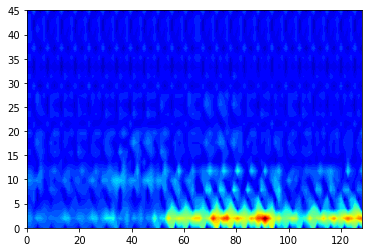

epoch [28/500], train loss:0.6491
epoch [28/500], val loss:1.7869
epoch [28/500], train accuracy:0.5690
epoch [28/500], val accuracy:0.5000


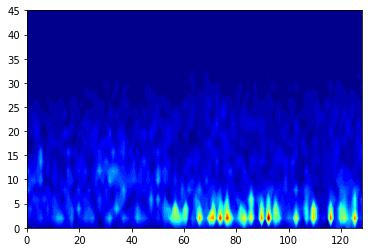

Predicted: 


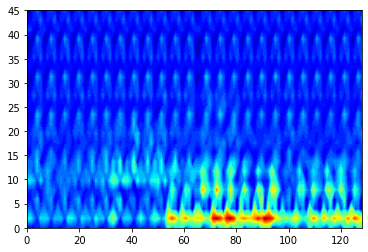

epoch [29/500], train loss:0.6458
epoch [29/500], val loss:1.7844
epoch [29/500], train accuracy:0.5948
epoch [29/500], val accuracy:0.5147


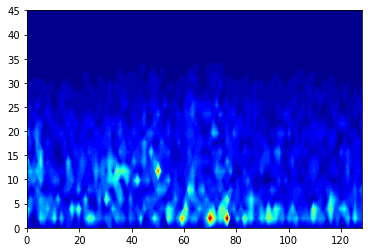

Predicted: 


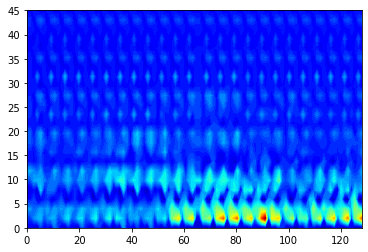

epoch [30/500], train loss:0.6428
epoch [30/500], val loss:1.7819
epoch [30/500], train accuracy:0.5560
epoch [30/500], val accuracy:0.5147


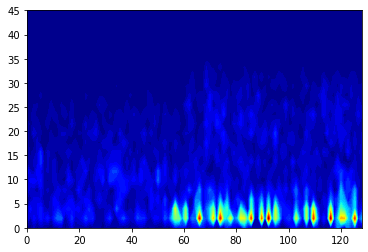

Predicted: 


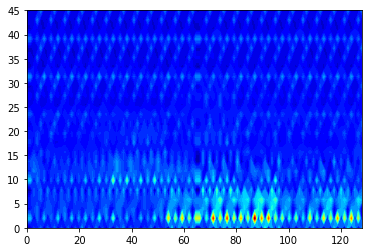

epoch [31/500], train loss:0.6413
epoch [31/500], val loss:1.7790
epoch [31/500], train accuracy:0.5776
epoch [31/500], val accuracy:0.5000


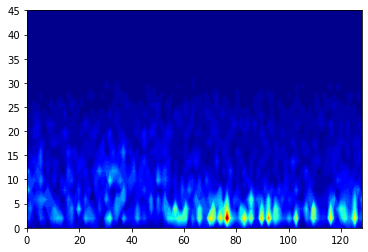

Predicted: 


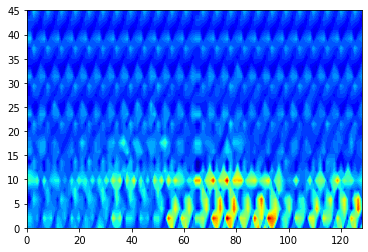

epoch [32/500], train loss:0.6364
epoch [32/500], val loss:1.7766
epoch [32/500], train accuracy:0.5819
epoch [32/500], val accuracy:0.5000


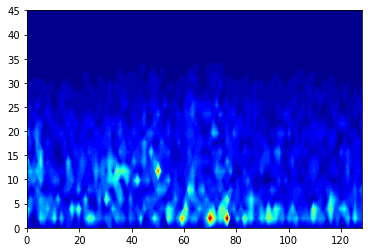

Predicted: 


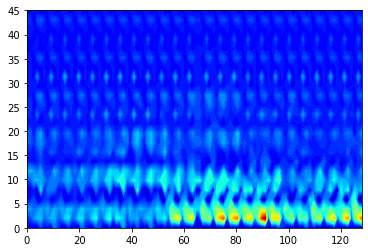

epoch [33/500], train loss:0.6363
epoch [33/500], val loss:1.7748
epoch [33/500], train accuracy:0.5647
epoch [33/500], val accuracy:0.5000


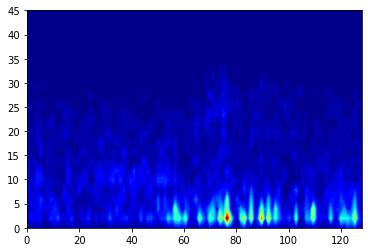

Predicted: 


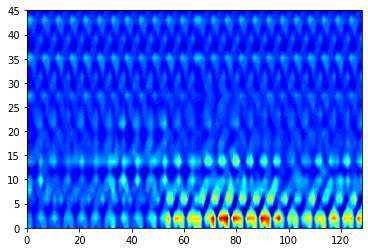

epoch [34/500], train loss:0.6307
epoch [34/500], val loss:1.7719
epoch [34/500], train accuracy:0.5819
epoch [34/500], val accuracy:0.5294


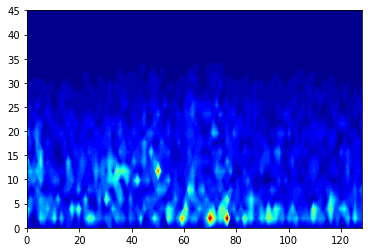

Predicted: 


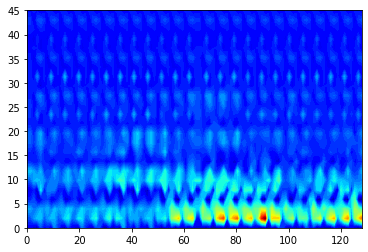

epoch [35/500], train loss:0.6304
epoch [35/500], val loss:1.7694
epoch [35/500], train accuracy:0.5991
epoch [35/500], val accuracy:0.5147


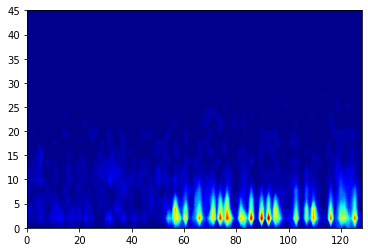

Predicted: 


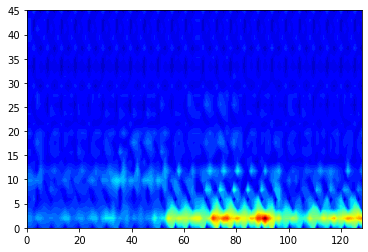

epoch [36/500], train loss:0.6389
epoch [36/500], val loss:1.7674
epoch [36/500], train accuracy:0.5862
epoch [36/500], val accuracy:0.4853


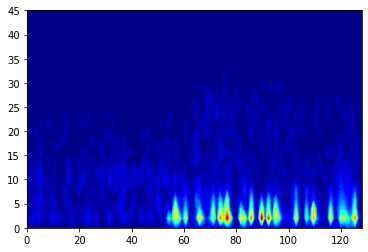

Predicted: 


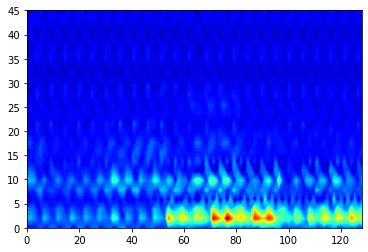

epoch [37/500], train loss:0.6271
epoch [37/500], val loss:1.7647
epoch [37/500], train accuracy:0.6121
epoch [37/500], val accuracy:0.5000


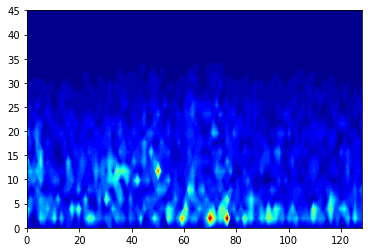

Predicted: 


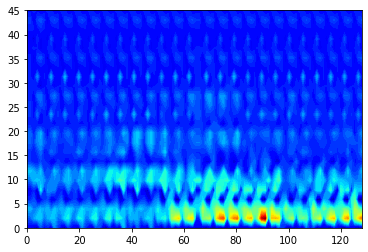

epoch [38/500], train loss:0.6307
epoch [38/500], val loss:1.7620
epoch [38/500], train accuracy:0.5776
epoch [38/500], val accuracy:0.5147


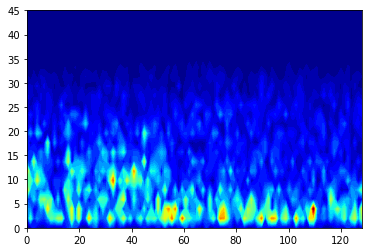

Predicted: 


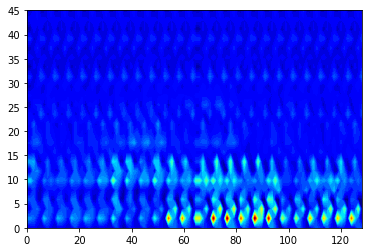

epoch [39/500], train loss:0.6226
epoch [39/500], val loss:1.7597
epoch [39/500], train accuracy:0.5948
epoch [39/500], val accuracy:0.5147


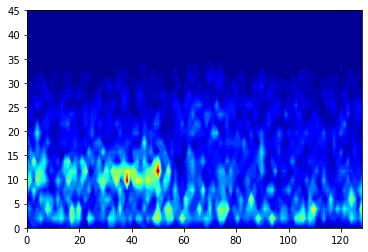

Predicted: 


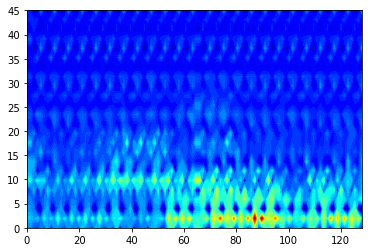

epoch [40/500], train loss:0.6222
epoch [40/500], val loss:1.7575
epoch [40/500], train accuracy:0.5948
epoch [40/500], val accuracy:0.5000


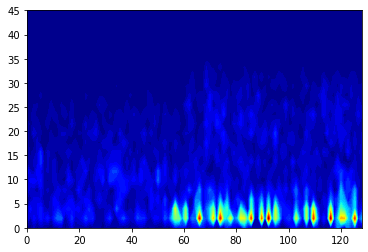

Predicted: 


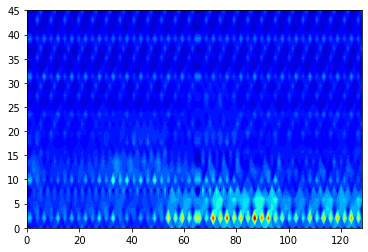

epoch [41/500], train loss:0.6228
epoch [41/500], val loss:1.7550
epoch [41/500], train accuracy:0.5862
epoch [41/500], val accuracy:0.5147


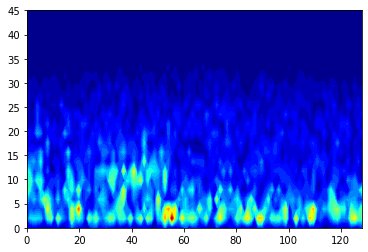

Predicted: 


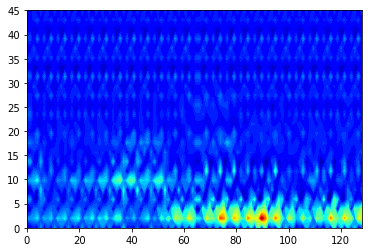

epoch [42/500], train loss:0.6139
epoch [42/500], val loss:1.7529
epoch [42/500], train accuracy:0.6034
epoch [42/500], val accuracy:0.5000


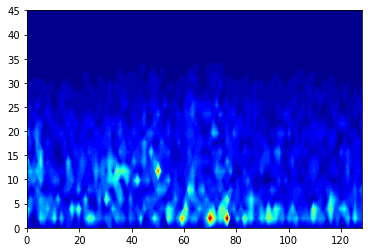

Predicted: 


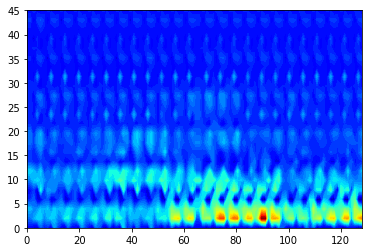

epoch [43/500], train loss:0.6138
epoch [43/500], val loss:1.7504
epoch [43/500], train accuracy:0.5991
epoch [43/500], val accuracy:0.5147


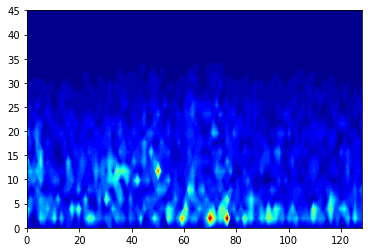

Predicted: 


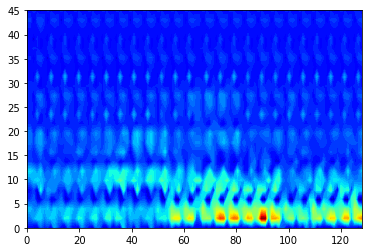

epoch [44/500], train loss:0.6145
epoch [44/500], val loss:1.7483
epoch [44/500], train accuracy:0.6034
epoch [44/500], val accuracy:0.5147


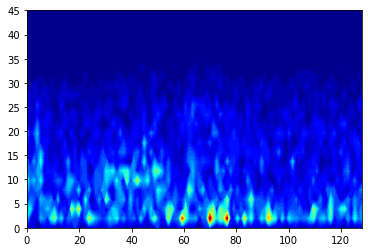

Predicted: 


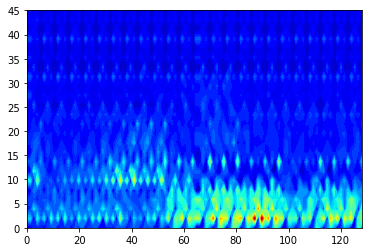

epoch [45/500], train loss:0.6078
epoch [45/500], val loss:1.7461
epoch [45/500], train accuracy:0.5776
epoch [45/500], val accuracy:0.5000


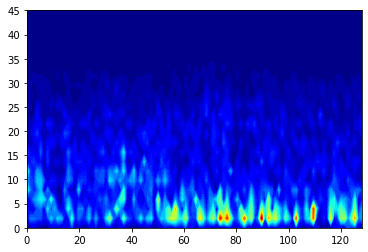

Predicted: 


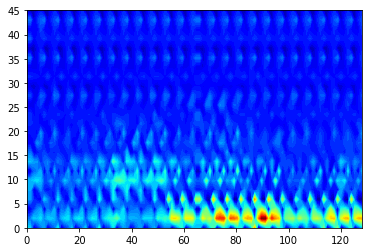

epoch [46/500], train loss:0.6174
epoch [46/500], val loss:1.7441
epoch [46/500], train accuracy:0.6293
epoch [46/500], val accuracy:0.5000


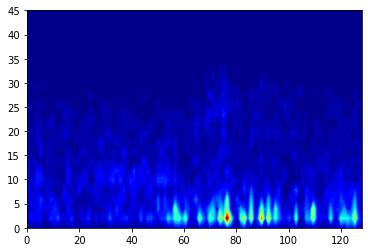

Predicted: 


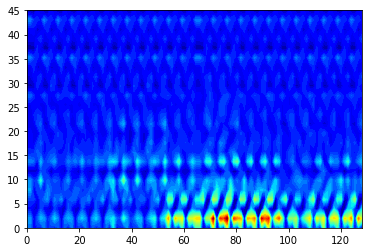

epoch [47/500], train loss:0.6055
epoch [47/500], val loss:1.7421
epoch [47/500], train accuracy:0.6078
epoch [47/500], val accuracy:0.5000


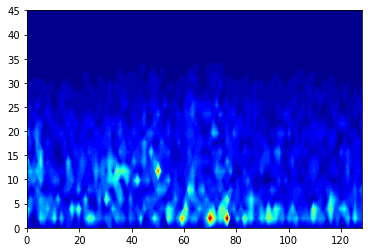

Predicted: 


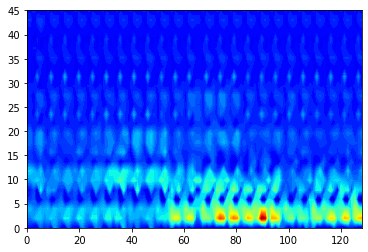

epoch [48/500], train loss:0.6032
epoch [48/500], val loss:1.7398
epoch [48/500], train accuracy:0.6078
epoch [48/500], val accuracy:0.5147


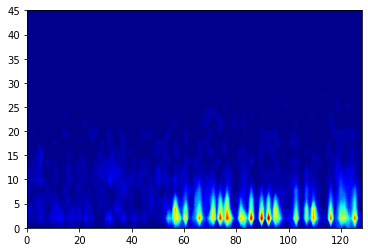

Predicted: 


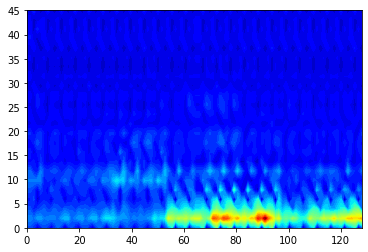

epoch [49/500], train loss:0.6045
epoch [49/500], val loss:1.7382
epoch [49/500], train accuracy:0.5991
epoch [49/500], val accuracy:0.5147


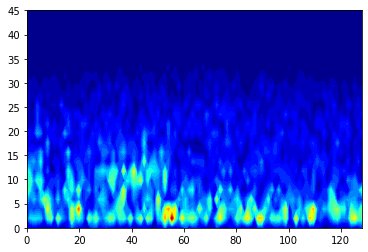

Predicted: 


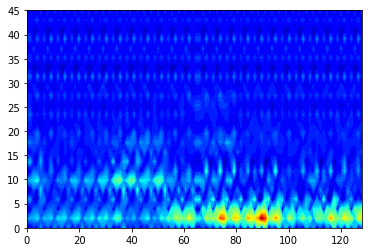

epoch [50/500], train loss:0.5978
epoch [50/500], val loss:1.7363
epoch [50/500], train accuracy:0.6250
epoch [50/500], val accuracy:0.5147


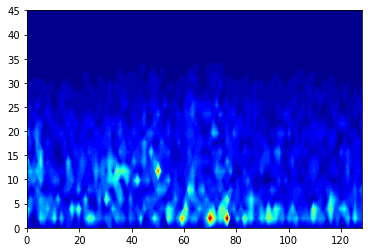

Predicted: 


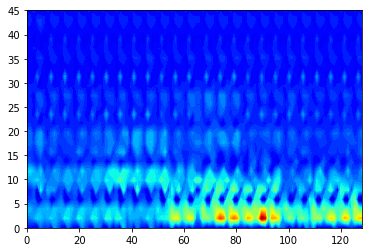

epoch [51/500], train loss:0.5975
epoch [51/500], val loss:1.7339
epoch [51/500], train accuracy:0.6121
epoch [51/500], val accuracy:0.5294


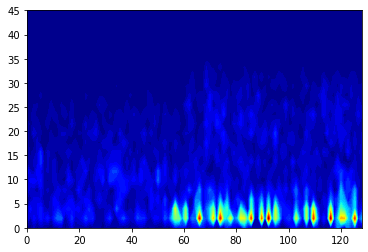

Predicted: 


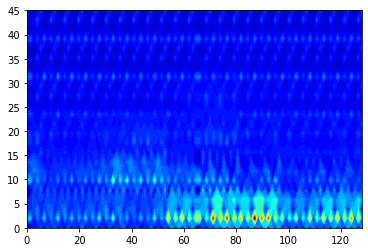

epoch [52/500], train loss:0.5979
epoch [52/500], val loss:1.7321
epoch [52/500], train accuracy:0.6379
epoch [52/500], val accuracy:0.5294


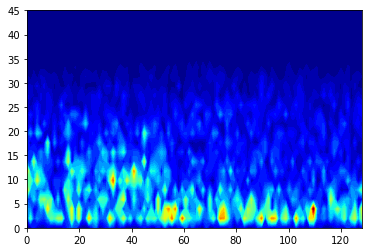

Predicted: 


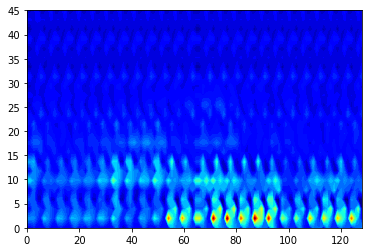

epoch [53/500], train loss:0.5930
epoch [53/500], val loss:1.7304
epoch [53/500], train accuracy:0.5862
epoch [53/500], val accuracy:0.5294


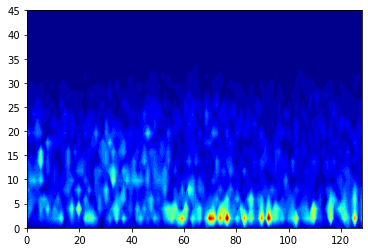

Predicted: 


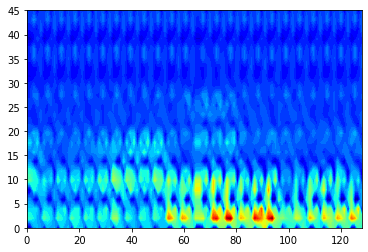

epoch [54/500], train loss:0.5928
epoch [54/500], val loss:1.7290
epoch [54/500], train accuracy:0.6078
epoch [54/500], val accuracy:0.5588


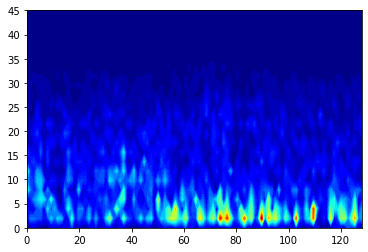

Predicted: 


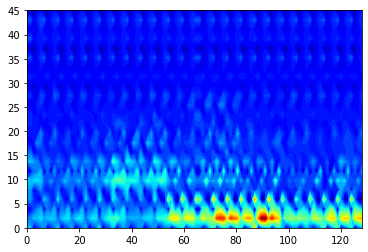

epoch [55/500], train loss:0.5896
epoch [55/500], val loss:1.7276
epoch [55/500], train accuracy:0.6121
epoch [55/500], val accuracy:0.5441


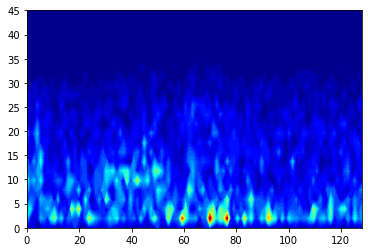

Predicted: 


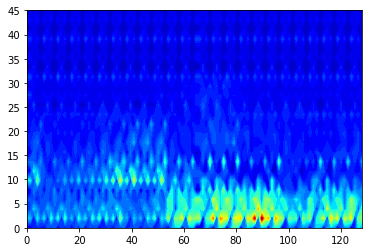

epoch [56/500], train loss:0.5873
epoch [56/500], val loss:1.7257
epoch [56/500], train accuracy:0.6250
epoch [56/500], val accuracy:0.5588


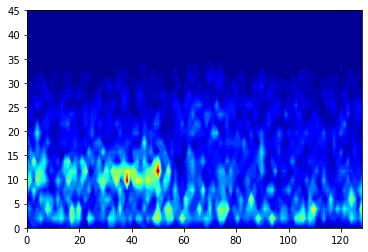

Predicted: 


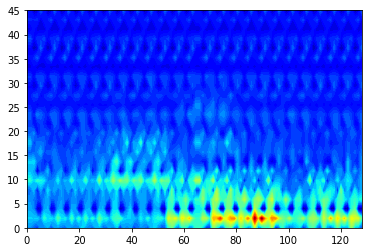

epoch [57/500], train loss:0.5897
epoch [57/500], val loss:1.7240
epoch [57/500], train accuracy:0.6250
epoch [57/500], val accuracy:0.5588


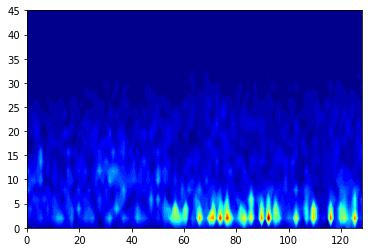

Predicted: 


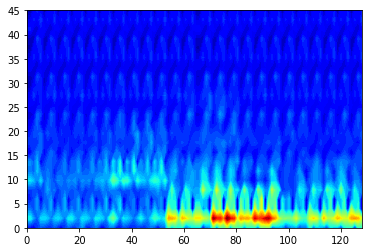

epoch [58/500], train loss:0.5905
epoch [58/500], val loss:1.7227
epoch [58/500], train accuracy:0.6379
epoch [58/500], val accuracy:0.5294


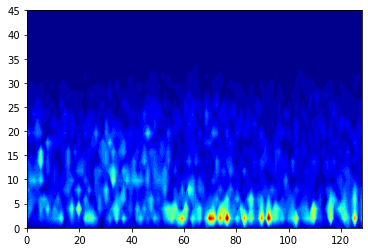

Predicted: 


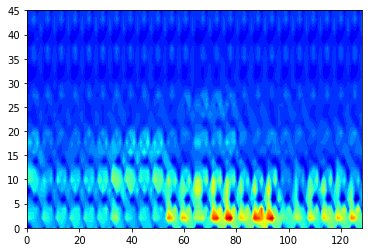

epoch [59/500], train loss:0.5854
epoch [59/500], val loss:1.7208
epoch [59/500], train accuracy:0.6207
epoch [59/500], val accuracy:0.5588


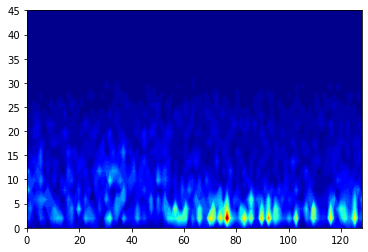

Predicted: 


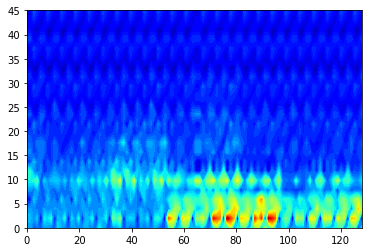

epoch [60/500], train loss:0.5809
epoch [60/500], val loss:1.7193
epoch [60/500], train accuracy:0.6422
epoch [60/500], val accuracy:0.5588


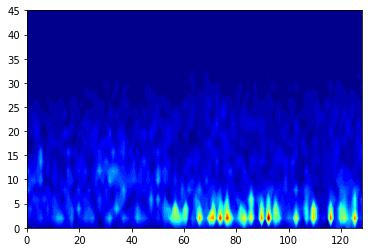

Predicted: 


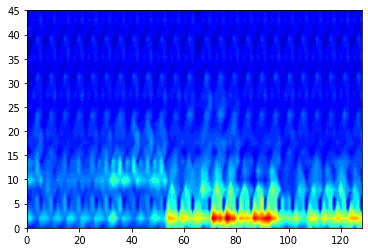

epoch [61/500], train loss:0.5803
epoch [61/500], val loss:1.7175
epoch [61/500], train accuracy:0.6422
epoch [61/500], val accuracy:0.5588


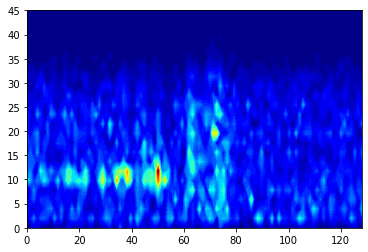

Predicted: 


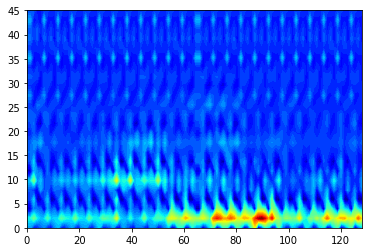

epoch [62/500], train loss:0.5877
epoch [62/500], val loss:1.7162
epoch [62/500], train accuracy:0.6207
epoch [62/500], val accuracy:0.5588


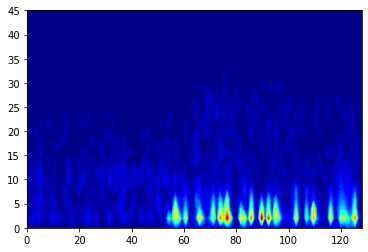

Predicted: 


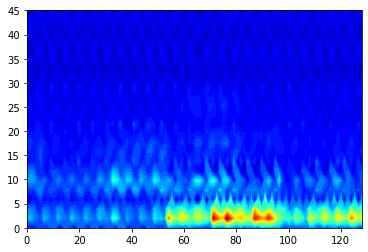

epoch [63/500], train loss:0.5782
epoch [63/500], val loss:1.7147
epoch [63/500], train accuracy:0.6422
epoch [63/500], val accuracy:0.5588


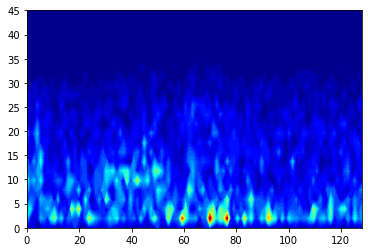

Predicted: 


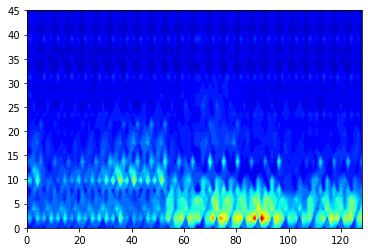

epoch [64/500], train loss:0.5764
epoch [64/500], val loss:1.7131
epoch [64/500], train accuracy:0.6379
epoch [64/500], val accuracy:0.5735


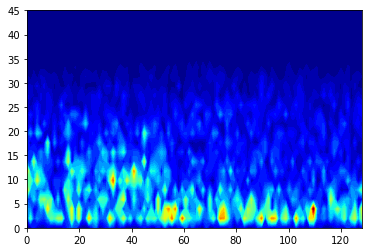

Predicted: 


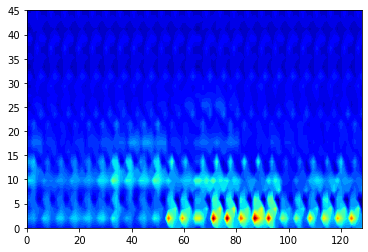

epoch [65/500], train loss:0.5757
epoch [65/500], val loss:1.7119
epoch [65/500], train accuracy:0.6509
epoch [65/500], val accuracy:0.5588


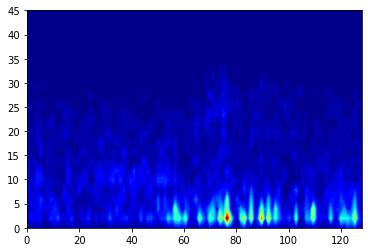

Predicted: 


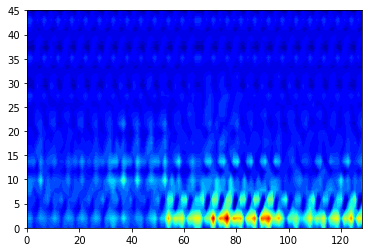

epoch [66/500], train loss:0.5725
epoch [66/500], val loss:1.7103
epoch [66/500], train accuracy:0.6336
epoch [66/500], val accuracy:0.5588


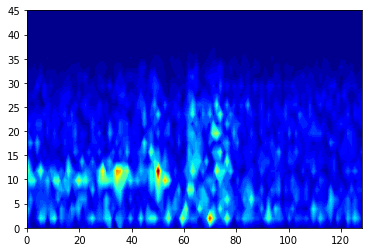

Predicted: 


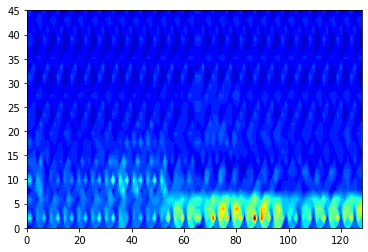

epoch [67/500], train loss:0.5734
epoch [67/500], val loss:1.7089
epoch [67/500], train accuracy:0.6207
epoch [67/500], val accuracy:0.5588


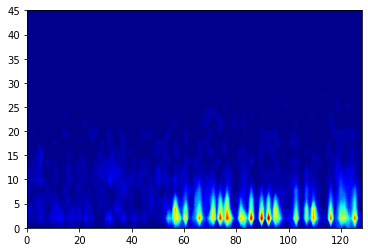

Predicted: 


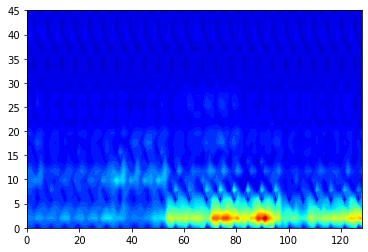

epoch [68/500], train loss:0.5705
epoch [68/500], val loss:1.7077
epoch [68/500], train accuracy:0.6552
epoch [68/500], val accuracy:0.5588


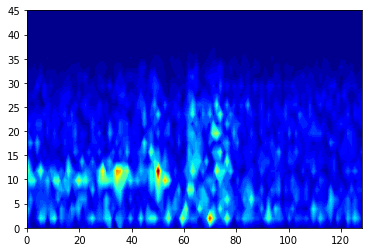

Predicted: 


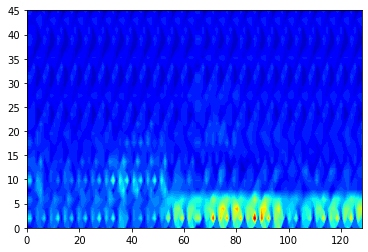

epoch [69/500], train loss:0.5704
epoch [69/500], val loss:1.7061
epoch [69/500], train accuracy:0.6595
epoch [69/500], val accuracy:0.5588


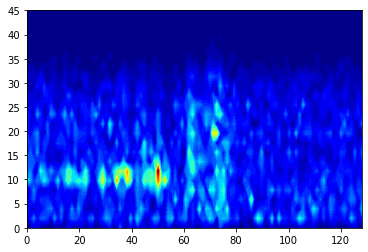

Predicted: 


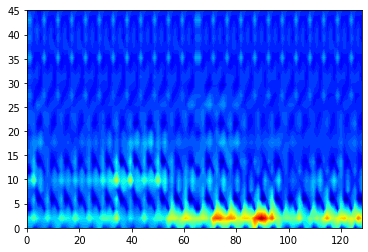

epoch [70/500], train loss:0.5696
epoch [70/500], val loss:1.7048
epoch [70/500], train accuracy:0.6466
epoch [70/500], val accuracy:0.5588


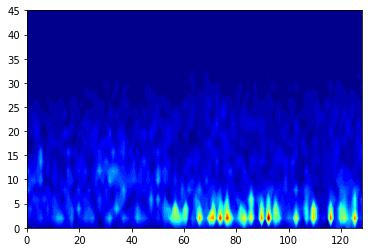

Predicted: 


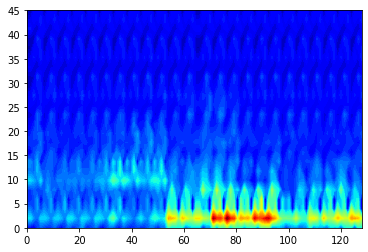

epoch [71/500], train loss:0.5676
epoch [71/500], val loss:1.7035
epoch [71/500], train accuracy:0.6422
epoch [71/500], val accuracy:0.5588


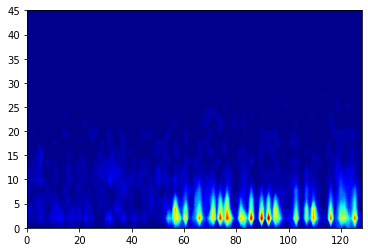

Predicted: 


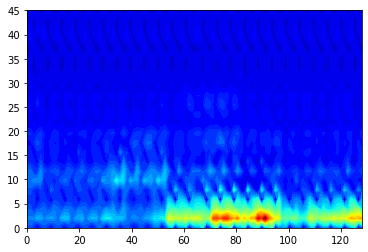

epoch [72/500], train loss:0.5679
epoch [72/500], val loss:1.7019
epoch [72/500], train accuracy:0.6466
epoch [72/500], val accuracy:0.5735


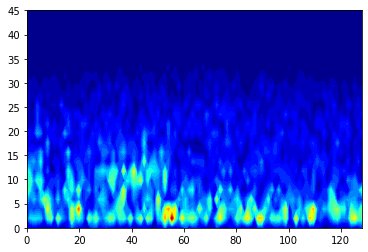

Predicted: 


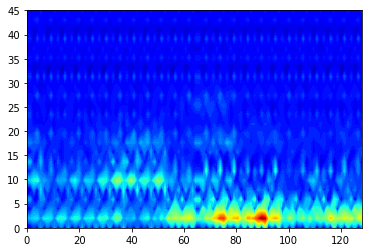

epoch [73/500], train loss:0.5656
epoch [73/500], val loss:1.7013
epoch [73/500], train accuracy:0.6724
epoch [73/500], val accuracy:0.5441


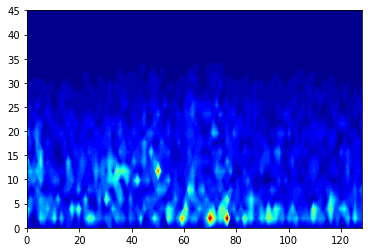

Predicted: 


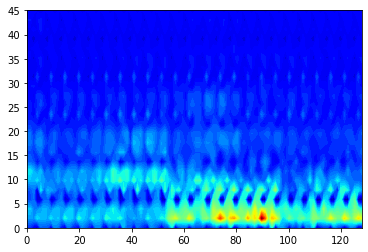

epoch [74/500], train loss:0.5648
epoch [74/500], val loss:1.6998
epoch [74/500], train accuracy:0.6466
epoch [74/500], val accuracy:0.5441


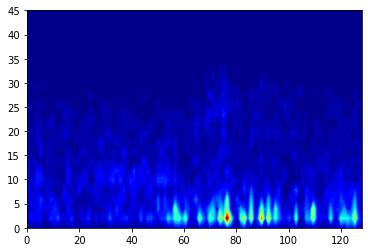

Predicted: 


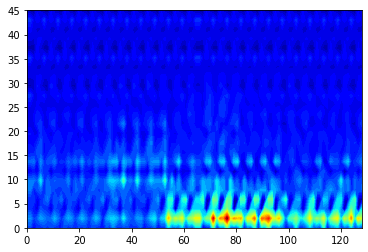

epoch [75/500], train loss:0.5657
epoch [75/500], val loss:1.6987
epoch [75/500], train accuracy:0.6681
epoch [75/500], val accuracy:0.5441


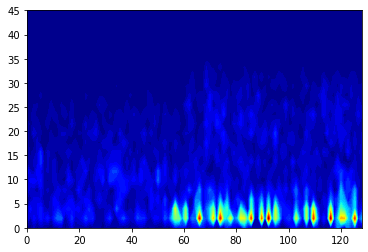

Predicted: 


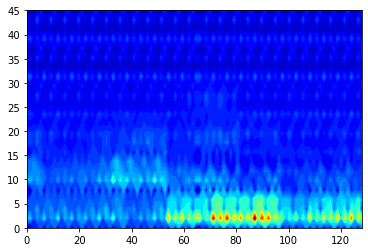

epoch [76/500], train loss:0.5629
epoch [76/500], val loss:1.6976
epoch [76/500], train accuracy:0.6552
epoch [76/500], val accuracy:0.5441


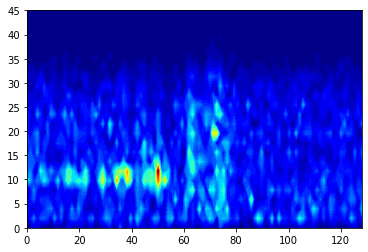

Predicted: 


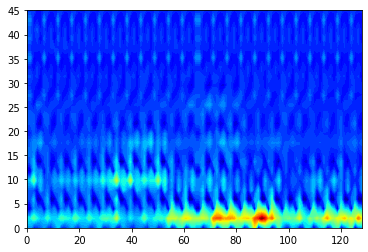

epoch [77/500], train loss:0.5628
epoch [77/500], val loss:1.6962
epoch [77/500], train accuracy:0.6466
epoch [77/500], val accuracy:0.5441


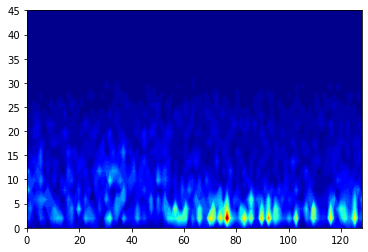

Predicted: 


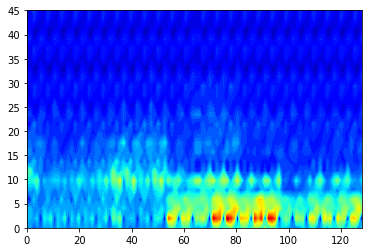

epoch [78/500], train loss:0.5681
epoch [78/500], val loss:1.6954
epoch [78/500], train accuracy:0.6509
epoch [78/500], val accuracy:0.5441


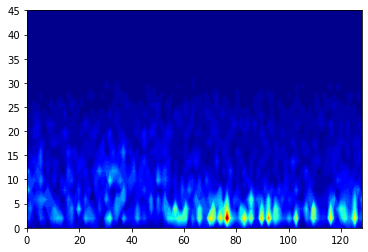

Predicted: 


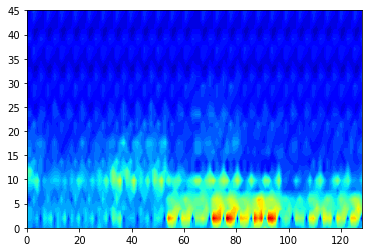

epoch [79/500], train loss:0.5620
epoch [79/500], val loss:1.6937
epoch [79/500], train accuracy:0.6422
epoch [79/500], val accuracy:0.5735


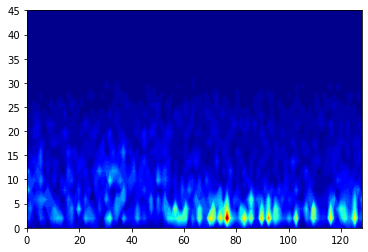

Predicted: 


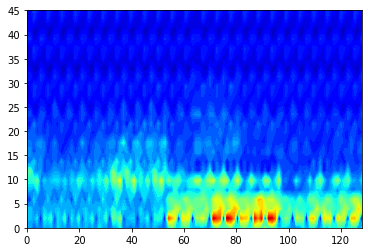

epoch [80/500], train loss:0.5776
epoch [80/500], val loss:1.6925
epoch [80/500], train accuracy:0.6681
epoch [80/500], val accuracy:0.5735


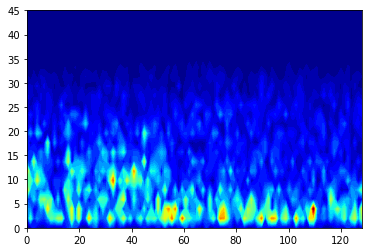

Predicted: 


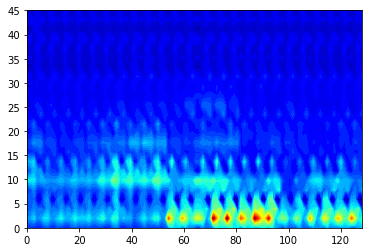

epoch [81/500], train loss:0.5568
epoch [81/500], val loss:1.6917
epoch [81/500], train accuracy:0.6940
epoch [81/500], val accuracy:0.5588


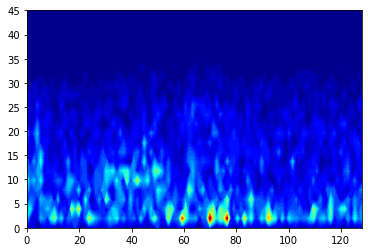

Predicted: 


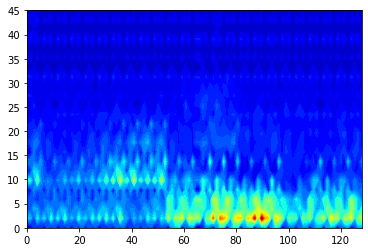

epoch [82/500], train loss:0.5568
epoch [82/500], val loss:1.6910
epoch [82/500], train accuracy:0.6595
epoch [82/500], val accuracy:0.5441


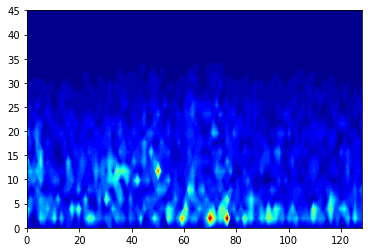

Predicted: 


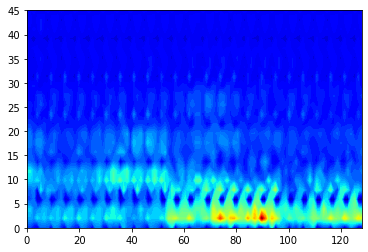

epoch [83/500], train loss:0.5560
epoch [83/500], val loss:1.6893
epoch [83/500], train accuracy:0.6724
epoch [83/500], val accuracy:0.5735


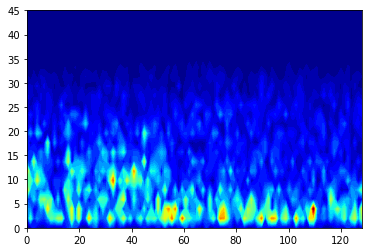

Predicted: 


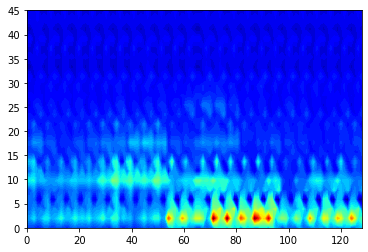

epoch [84/500], train loss:0.5550
epoch [84/500], val loss:1.6889
epoch [84/500], train accuracy:0.6595
epoch [84/500], val accuracy:0.5441


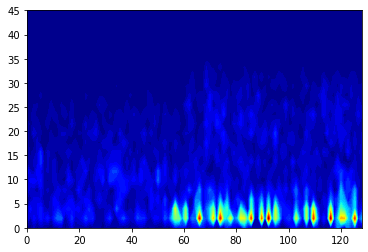

Predicted: 


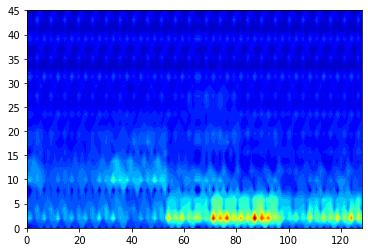

epoch [85/500], train loss:0.5508
epoch [85/500], val loss:1.6881
epoch [85/500], train accuracy:0.6810
epoch [85/500], val accuracy:0.5441


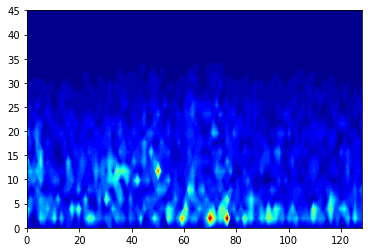

Predicted: 


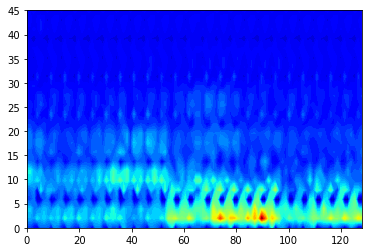

epoch [86/500], train loss:0.5494
epoch [86/500], val loss:1.6868
epoch [86/500], train accuracy:0.6983
epoch [86/500], val accuracy:0.5588


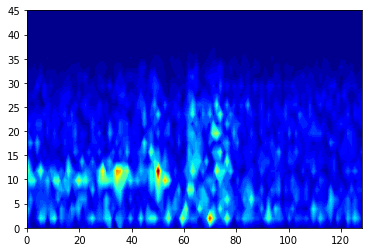

Predicted: 


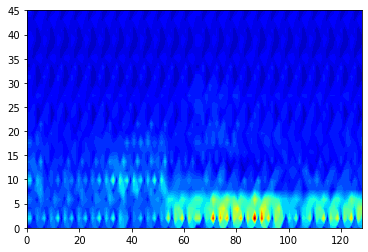

epoch [87/500], train loss:0.5524
epoch [87/500], val loss:1.6863
epoch [87/500], train accuracy:0.6810
epoch [87/500], val accuracy:0.5441


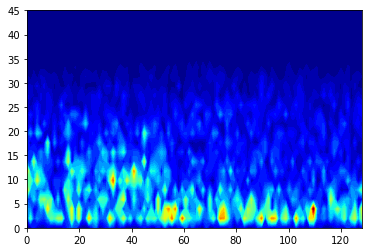

Predicted: 


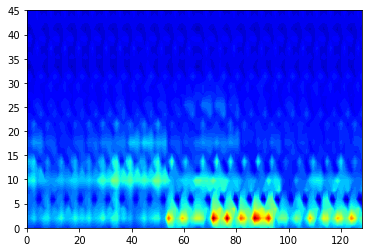

epoch [88/500], train loss:0.5510
epoch [88/500], val loss:1.6849
epoch [88/500], train accuracy:0.6466
epoch [88/500], val accuracy:0.5588


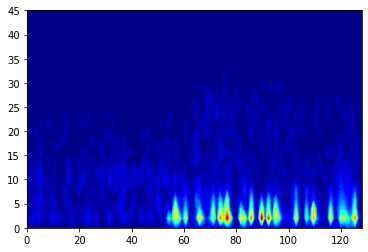

Predicted: 


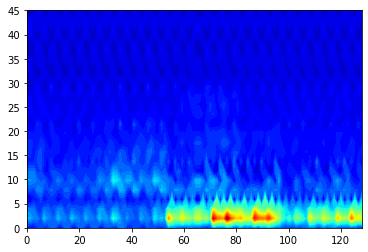

epoch [89/500], train loss:0.5481
epoch [89/500], val loss:1.6839
epoch [89/500], train accuracy:0.6767
epoch [89/500], val accuracy:0.5588


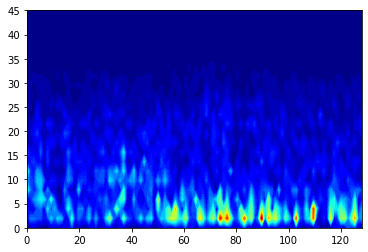

Predicted: 


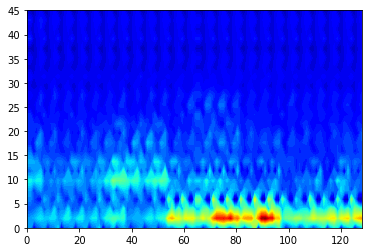

epoch [90/500], train loss:0.5514
epoch [90/500], val loss:1.6830
epoch [90/500], train accuracy:0.6724
epoch [90/500], val accuracy:0.5588


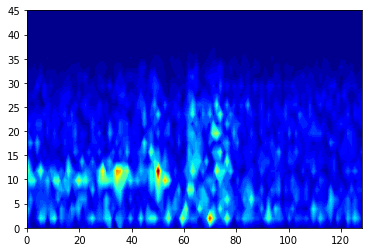

Predicted: 


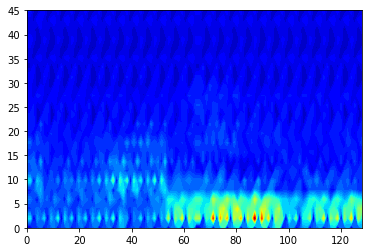

epoch [91/500], train loss:0.5465
epoch [91/500], val loss:1.6820
epoch [91/500], train accuracy:0.7026
epoch [91/500], val accuracy:0.5588


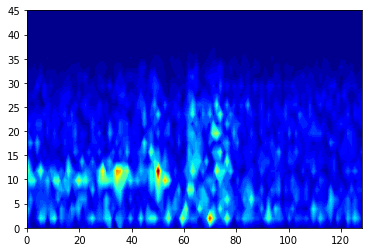

Predicted: 


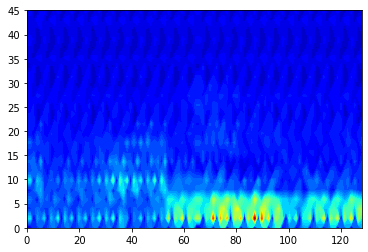

epoch [92/500], train loss:0.5472
epoch [92/500], val loss:1.6814
epoch [92/500], train accuracy:0.7069
epoch [92/500], val accuracy:0.5588


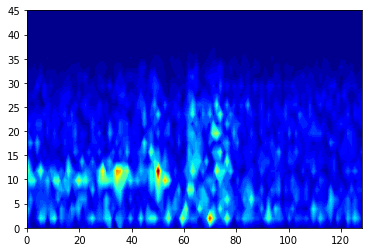

Predicted: 


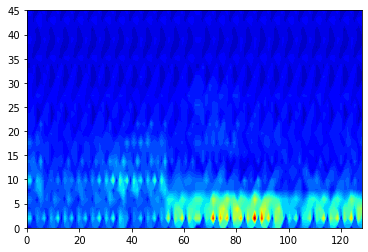

epoch [93/500], train loss:0.5462
epoch [93/500], val loss:1.6807
epoch [93/500], train accuracy:0.6724
epoch [93/500], val accuracy:0.5441


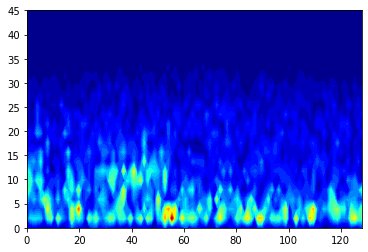

Predicted: 


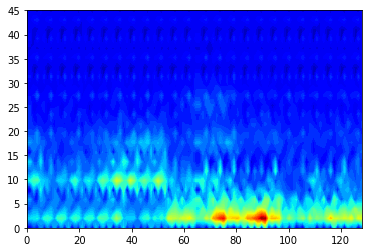

epoch [94/500], train loss:0.5444
epoch [94/500], val loss:1.6792
epoch [94/500], train accuracy:0.7026
epoch [94/500], val accuracy:0.5588


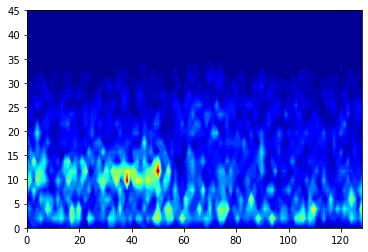

Predicted: 


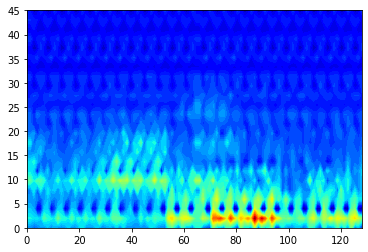

epoch [95/500], train loss:0.5442
epoch [95/500], val loss:1.6785
epoch [95/500], train accuracy:0.6810
epoch [95/500], val accuracy:0.5588


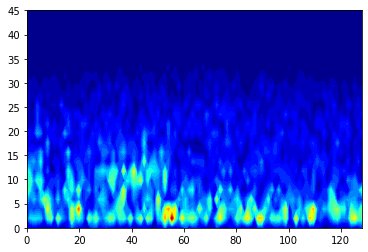

Predicted: 


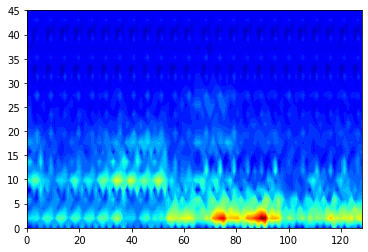

epoch [96/500], train loss:0.5416
epoch [96/500], val loss:1.6778
epoch [96/500], train accuracy:0.6638
epoch [96/500], val accuracy:0.5588


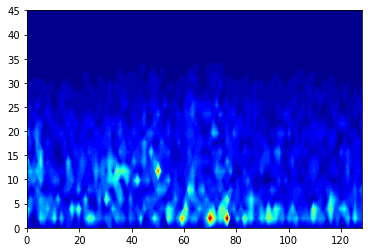

Predicted: 


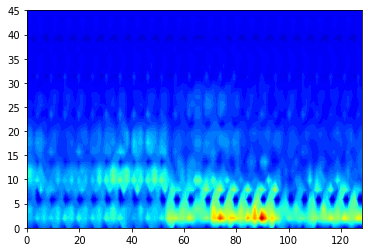

epoch [97/500], train loss:0.5480
epoch [97/500], val loss:1.6771
epoch [97/500], train accuracy:0.6897
epoch [97/500], val accuracy:0.5588


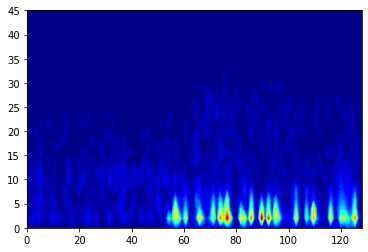

Predicted: 


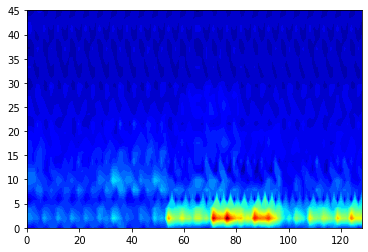

epoch [98/500], train loss:0.5458
epoch [98/500], val loss:1.6759
epoch [98/500], train accuracy:0.7026
epoch [98/500], val accuracy:0.5588


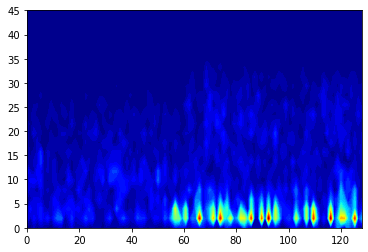

Predicted: 


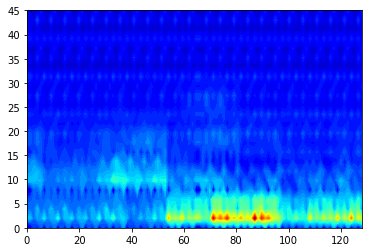

epoch [99/500], train loss:0.5422
epoch [99/500], val loss:1.6750
epoch [99/500], train accuracy:0.6767
epoch [99/500], val accuracy:0.5588


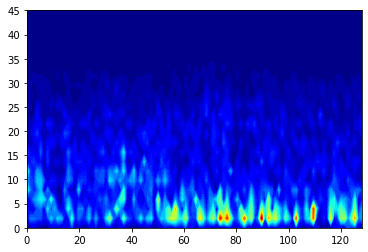

Predicted: 


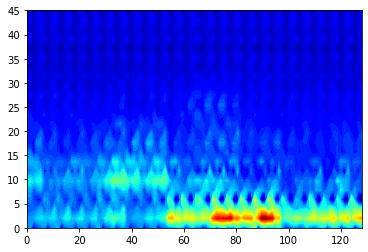

epoch [100/500], train loss:0.5400
epoch [100/500], val loss:1.6744
epoch [100/500], train accuracy:0.6940
epoch [100/500], val accuracy:0.5588


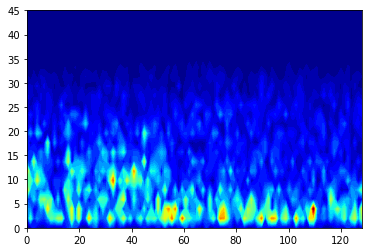

Predicted: 


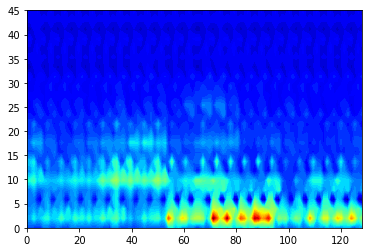

epoch [101/500], train loss:0.5382
epoch [101/500], val loss:1.6732
epoch [101/500], train accuracy:0.7026
epoch [101/500], val accuracy:0.5588


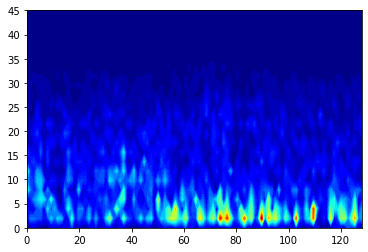

Predicted: 


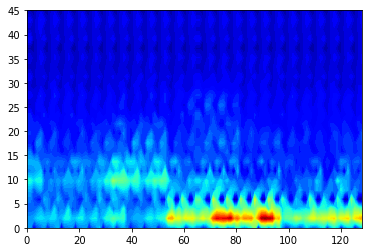

epoch [102/500], train loss:0.5383
epoch [102/500], val loss:1.6727
epoch [102/500], train accuracy:0.6810
epoch [102/500], val accuracy:0.5588


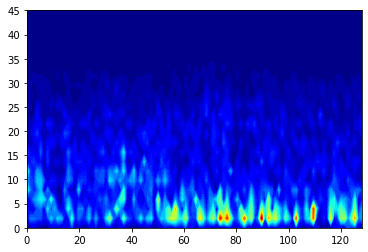

Predicted: 


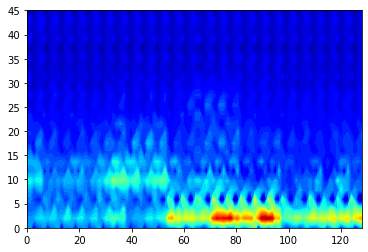

epoch [103/500], train loss:0.5351
epoch [103/500], val loss:1.6715
epoch [103/500], train accuracy:0.6724
epoch [103/500], val accuracy:0.5588


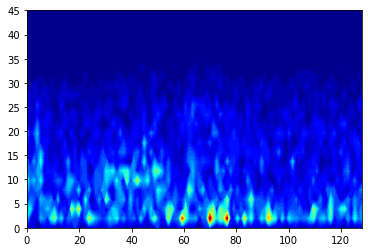

Predicted: 


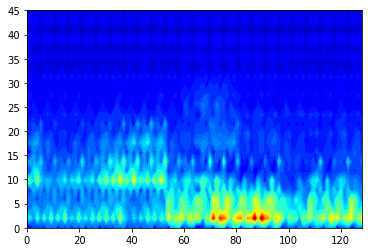

epoch [104/500], train loss:0.5353
epoch [104/500], val loss:1.6709
epoch [104/500], train accuracy:0.6853
epoch [104/500], val accuracy:0.5588


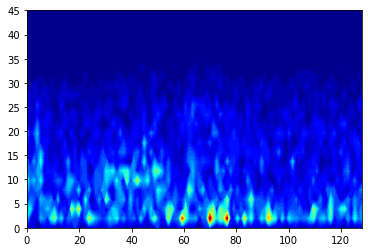

Predicted: 


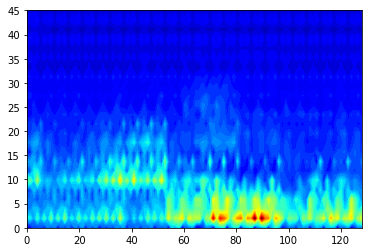

epoch [105/500], train loss:0.5363
epoch [105/500], val loss:1.6702
epoch [105/500], train accuracy:0.6724
epoch [105/500], val accuracy:0.5588


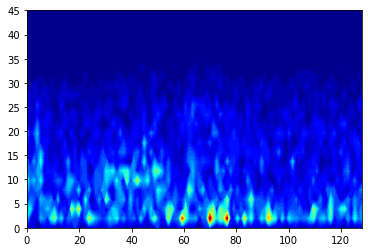

Predicted: 


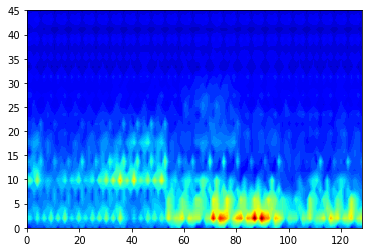

epoch [106/500], train loss:0.5324
epoch [106/500], val loss:1.6691
epoch [106/500], train accuracy:0.6940
epoch [106/500], val accuracy:0.5588


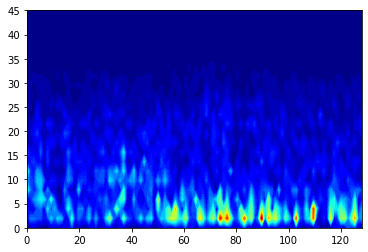

Predicted: 


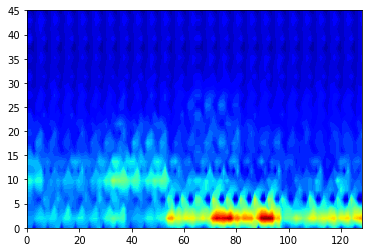

epoch [107/500], train loss:0.5306
epoch [107/500], val loss:1.6684
epoch [107/500], train accuracy:0.7026
epoch [107/500], val accuracy:0.5588


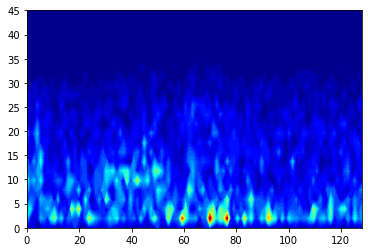

Predicted: 


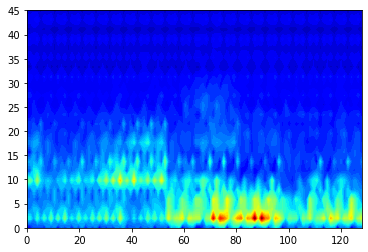

epoch [108/500], train loss:0.5323
epoch [108/500], val loss:1.6673
epoch [108/500], train accuracy:0.7155
epoch [108/500], val accuracy:0.5588


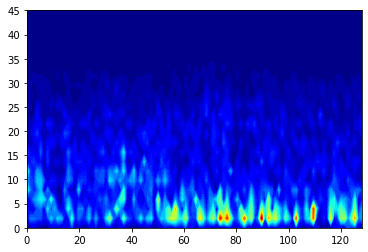

Predicted: 


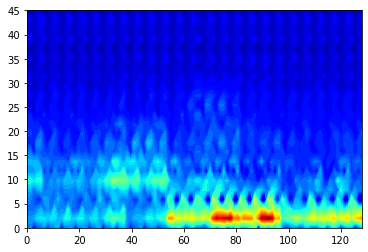

epoch [109/500], train loss:0.5307
epoch [109/500], val loss:1.6664
epoch [109/500], train accuracy:0.7026
epoch [109/500], val accuracy:0.5882


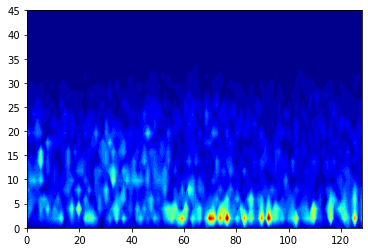

Predicted: 


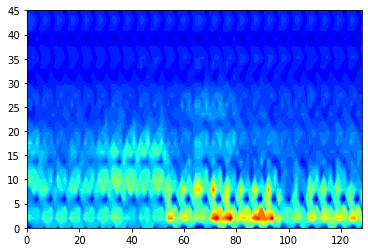

epoch [110/500], train loss:0.5286
epoch [110/500], val loss:1.6657
epoch [110/500], train accuracy:0.7069
epoch [110/500], val accuracy:0.5735


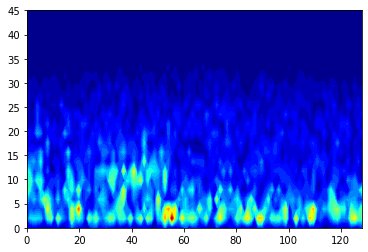

Predicted: 


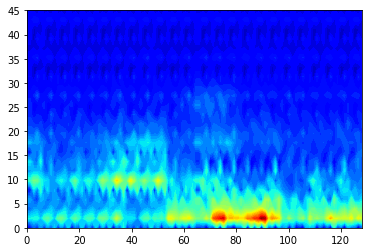

epoch [111/500], train loss:0.5318
epoch [111/500], val loss:1.6649
epoch [111/500], train accuracy:0.7069
epoch [111/500], val accuracy:0.5735


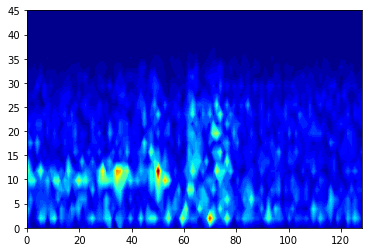

Predicted: 


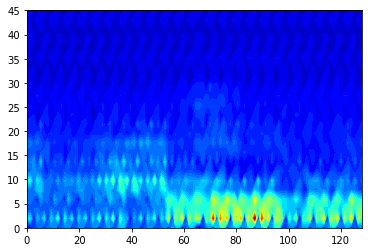

epoch [112/500], train loss:0.5271
epoch [112/500], val loss:1.6645
epoch [112/500], train accuracy:0.6724
epoch [112/500], val accuracy:0.5588


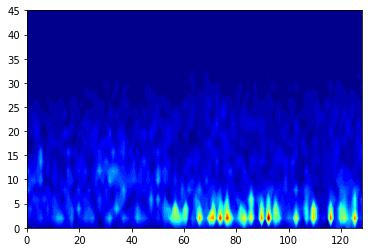

Predicted: 


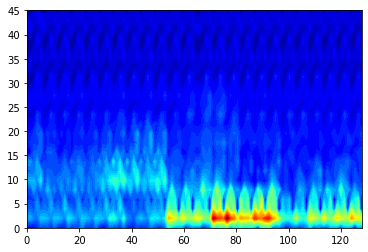

epoch [113/500], train loss:0.5260
epoch [113/500], val loss:1.6639
epoch [113/500], train accuracy:0.7112
epoch [113/500], val accuracy:0.5588


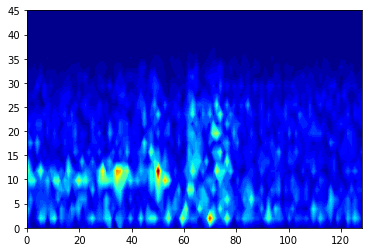

Predicted: 


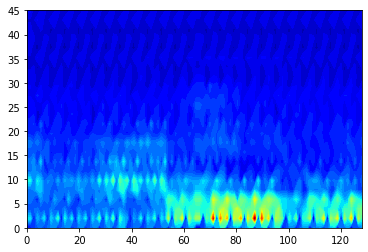

epoch [114/500], train loss:0.5246
epoch [114/500], val loss:1.6627
epoch [114/500], train accuracy:0.7371
epoch [114/500], val accuracy:0.5588


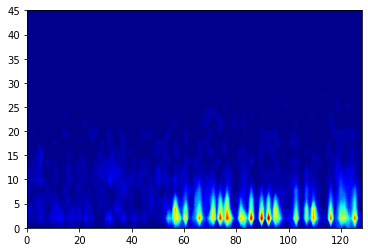

Predicted: 


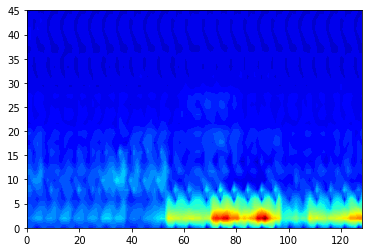

epoch [115/500], train loss:0.5242
epoch [115/500], val loss:1.6622
epoch [115/500], train accuracy:0.7112
epoch [115/500], val accuracy:0.5588


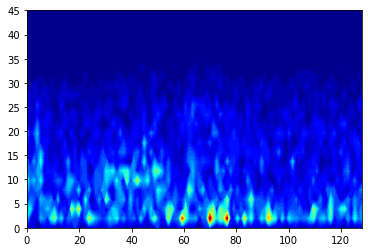

Predicted: 


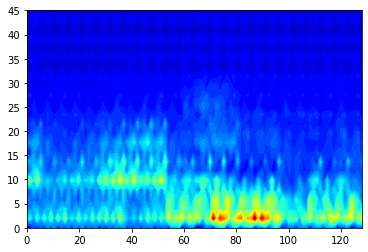

epoch [116/500], train loss:0.8470
epoch [116/500], val loss:1.6613
epoch [116/500], train accuracy:0.7241
epoch [116/500], val accuracy:0.5735


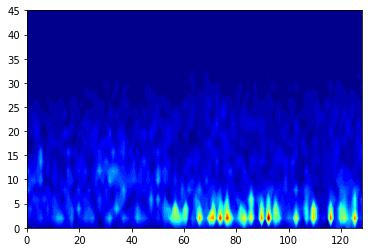

Predicted: 


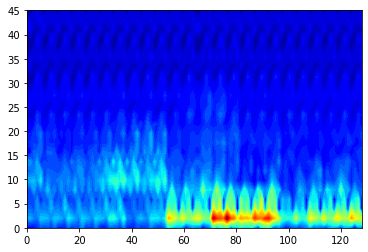

epoch [117/500], train loss:0.5279
epoch [117/500], val loss:1.6608
epoch [117/500], train accuracy:0.7155
epoch [117/500], val accuracy:0.5882


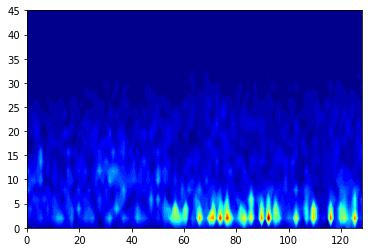

Predicted: 


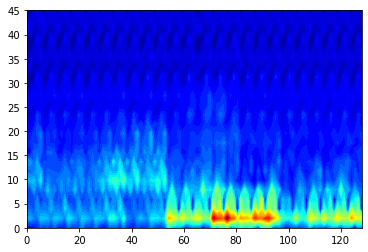

epoch [118/500], train loss:0.5237
epoch [118/500], val loss:1.6600
epoch [118/500], train accuracy:0.7069
epoch [118/500], val accuracy:0.5882


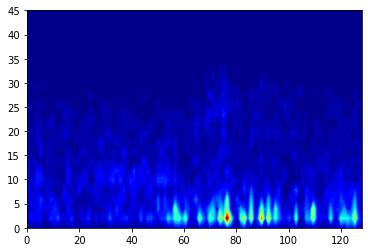

Predicted: 


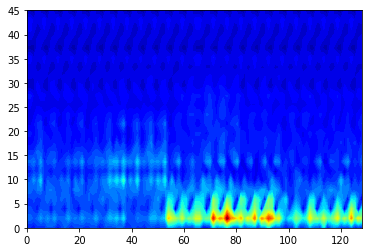

epoch [119/500], train loss:0.5231
epoch [119/500], val loss:1.6590
epoch [119/500], train accuracy:0.7155
epoch [119/500], val accuracy:0.6029


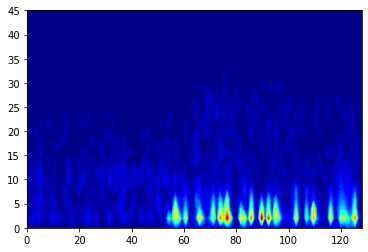

Predicted: 


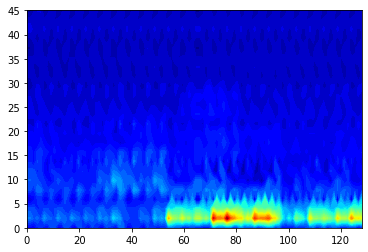

epoch [120/500], train loss:0.5271
epoch [120/500], val loss:1.6588
epoch [120/500], train accuracy:0.7112
epoch [120/500], val accuracy:0.5882


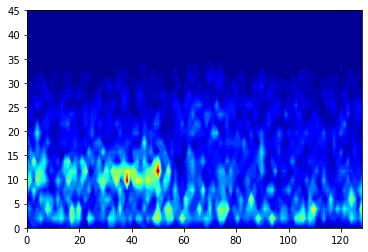

Predicted: 


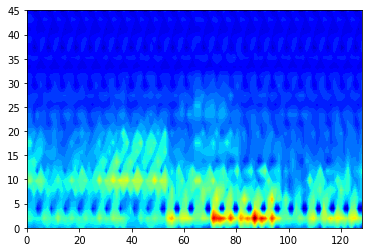

epoch [121/500], train loss:0.5198
epoch [121/500], val loss:1.6570
epoch [121/500], train accuracy:0.7371
epoch [121/500], val accuracy:0.6029


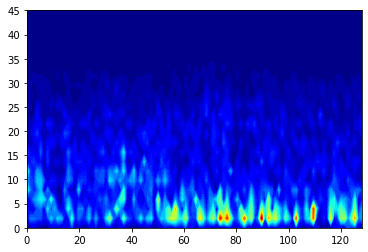

Predicted: 


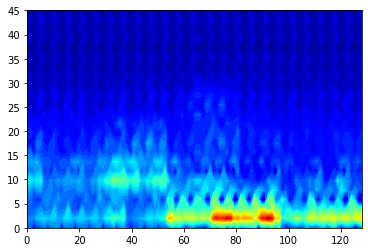

epoch [122/500], train loss:0.5242
epoch [122/500], val loss:1.6567
epoch [122/500], train accuracy:0.7155
epoch [122/500], val accuracy:0.6029


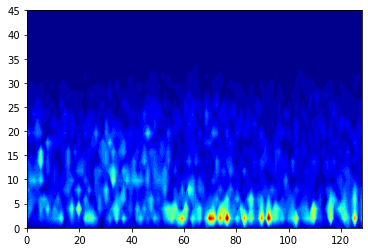

Predicted: 


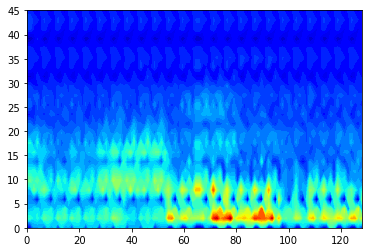

epoch [123/500], train loss:0.5176
epoch [123/500], val loss:1.6564
epoch [123/500], train accuracy:0.7112
epoch [123/500], val accuracy:0.6029


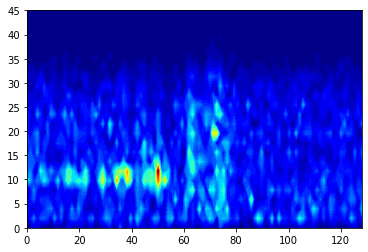

Predicted: 


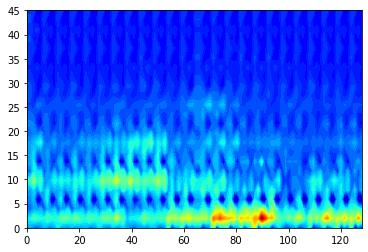

epoch [124/500], train loss:0.5165
epoch [124/500], val loss:1.6548
epoch [124/500], train accuracy:0.7155
epoch [124/500], val accuracy:0.6176


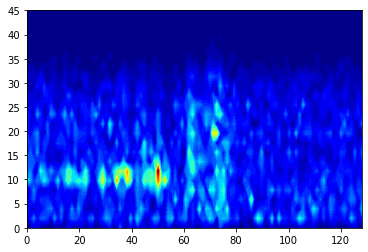

Predicted: 


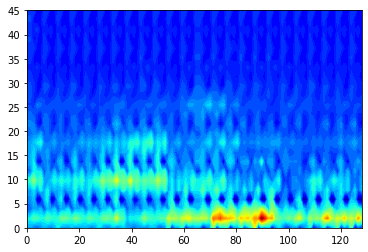

epoch [125/500], train loss:0.5141
epoch [125/500], val loss:1.6540
epoch [125/500], train accuracy:0.7371
epoch [125/500], val accuracy:0.6324


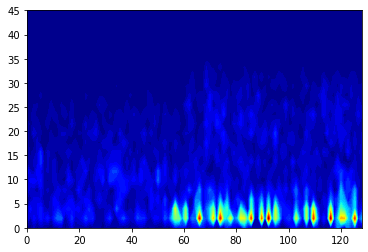

Predicted: 


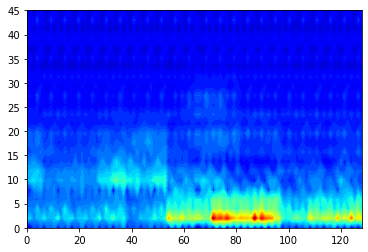

epoch [126/500], train loss:0.5161
epoch [126/500], val loss:1.6539
epoch [126/500], train accuracy:0.7155
epoch [126/500], val accuracy:0.6176


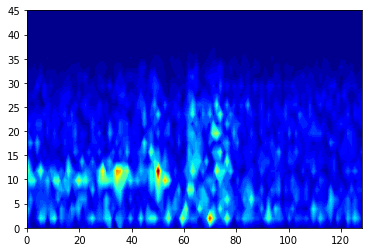

Predicted: 


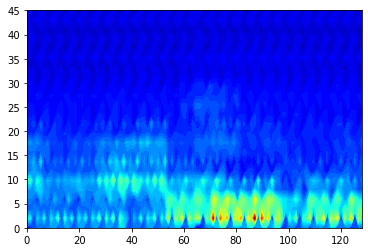

epoch [127/500], train loss:0.5155
epoch [127/500], val loss:1.6535
epoch [127/500], train accuracy:0.7328
epoch [127/500], val accuracy:0.6029


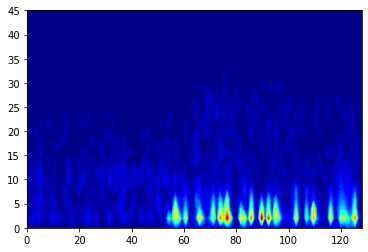

Predicted: 


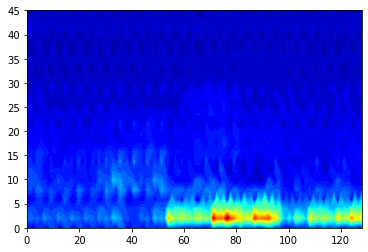

epoch [128/500], train loss:0.5174
epoch [128/500], val loss:1.6526
epoch [128/500], train accuracy:0.7155
epoch [128/500], val accuracy:0.6029


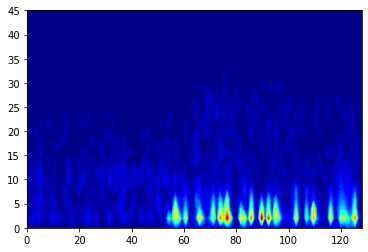

Predicted: 


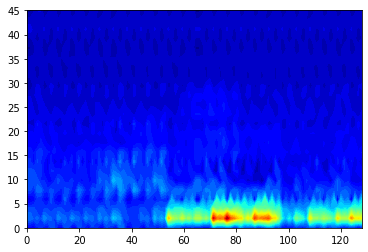

epoch [129/500], train loss:0.5138
epoch [129/500], val loss:1.6519
epoch [129/500], train accuracy:0.7457
epoch [129/500], val accuracy:0.6176


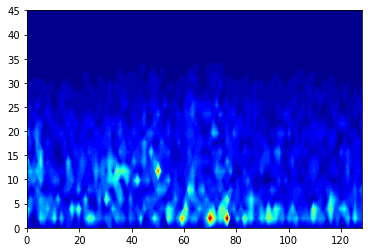

Predicted: 


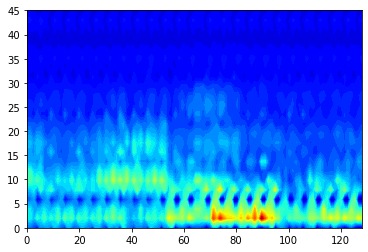

epoch [130/500], train loss:0.5117
epoch [130/500], val loss:1.6510
epoch [130/500], train accuracy:0.7198
epoch [130/500], val accuracy:0.6176


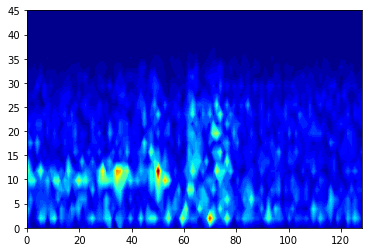

Predicted: 


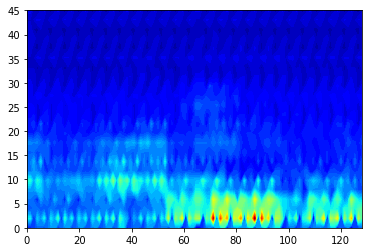

epoch [131/500], train loss:0.5128
epoch [131/500], val loss:1.6512
epoch [131/500], train accuracy:0.7328
epoch [131/500], val accuracy:0.5882


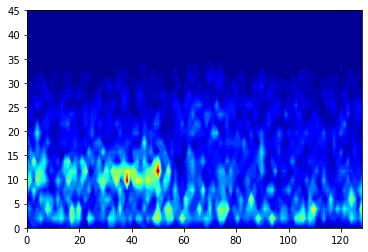

Predicted: 


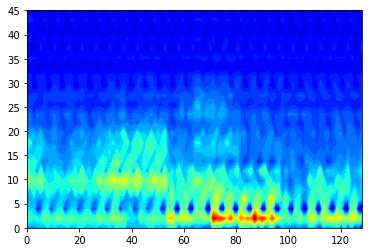

epoch [132/500], train loss:0.5168
epoch [132/500], val loss:1.6498
epoch [132/500], train accuracy:0.7241
epoch [132/500], val accuracy:0.6324


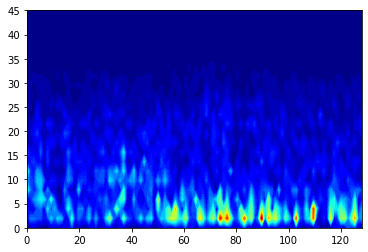

Predicted: 


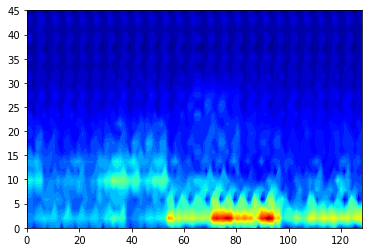

epoch [133/500], train loss:0.5112
epoch [133/500], val loss:1.6490
epoch [133/500], train accuracy:0.7241
epoch [133/500], val accuracy:0.6471


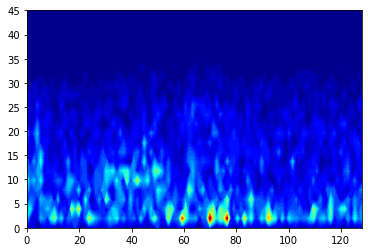

Predicted: 


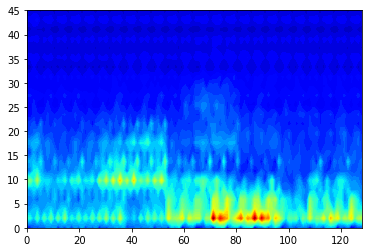

epoch [134/500], train loss:0.5089
epoch [134/500], val loss:1.6484
epoch [134/500], train accuracy:0.7543
epoch [134/500], val accuracy:0.6471


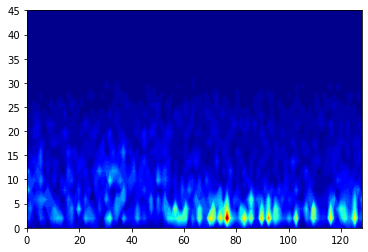

Predicted: 


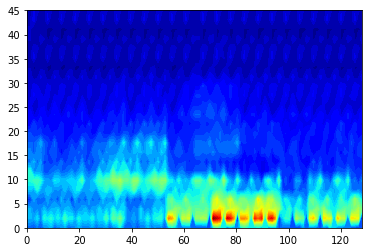

epoch [135/500], train loss:0.5115
epoch [135/500], val loss:1.6476
epoch [135/500], train accuracy:0.7500
epoch [135/500], val accuracy:0.6471


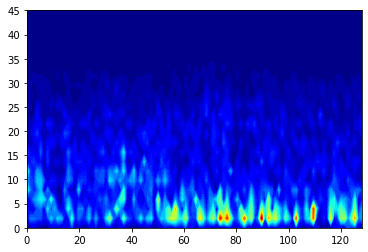

Predicted: 


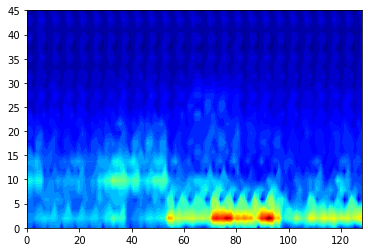

epoch [136/500], train loss:0.5091
epoch [136/500], val loss:1.6475
epoch [136/500], train accuracy:0.7414
epoch [136/500], val accuracy:0.6324


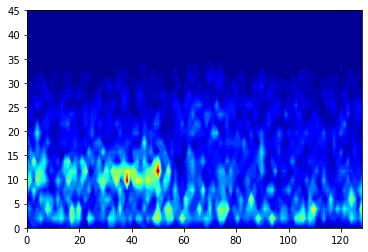

Predicted: 


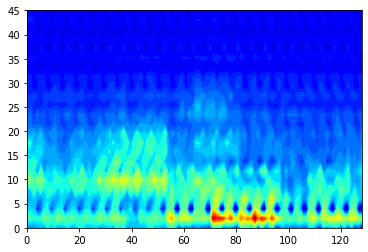

epoch [137/500], train loss:0.5096
epoch [137/500], val loss:1.6465
epoch [137/500], train accuracy:0.7284
epoch [137/500], val accuracy:0.6471


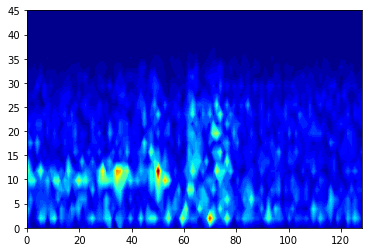

Predicted: 


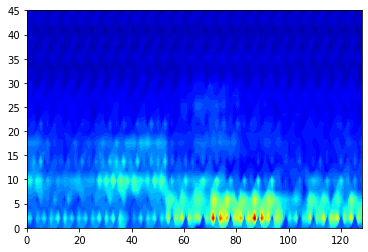

epoch [138/500], train loss:0.5065
epoch [138/500], val loss:1.6465
epoch [138/500], train accuracy:0.7284
epoch [138/500], val accuracy:0.6324


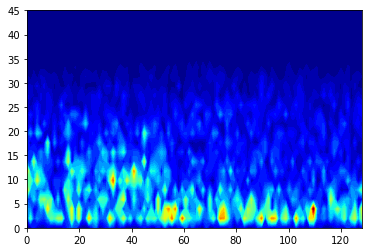

Predicted: 


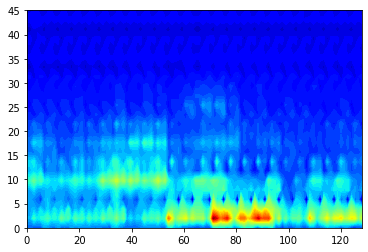

epoch [139/500], train loss:0.5060
epoch [139/500], val loss:1.6459
epoch [139/500], train accuracy:0.7198
epoch [139/500], val accuracy:0.6324


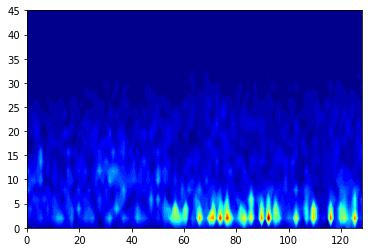

Predicted: 


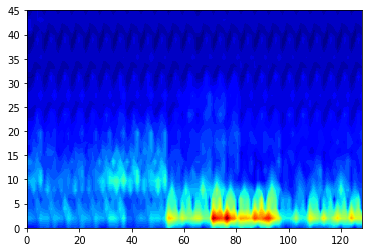

epoch [140/500], train loss:0.5112
epoch [140/500], val loss:1.6452
epoch [140/500], train accuracy:0.7586
epoch [140/500], val accuracy:0.6471


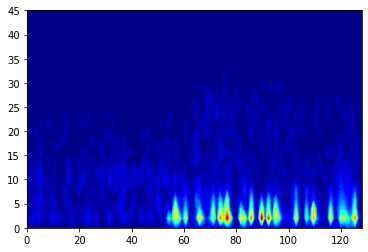

Predicted: 


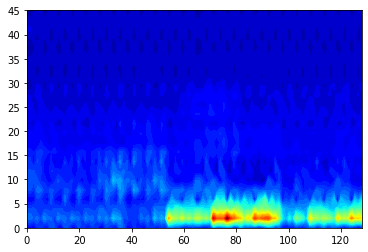

epoch [141/500], train loss:0.5058
epoch [141/500], val loss:1.6446
epoch [141/500], train accuracy:0.7241
epoch [141/500], val accuracy:0.6471


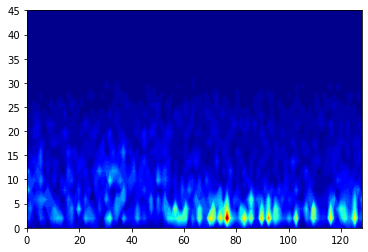

Predicted: 


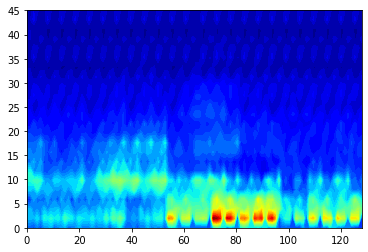

epoch [142/500], train loss:0.5028
epoch [142/500], val loss:1.6444
epoch [142/500], train accuracy:0.7629
epoch [142/500], val accuracy:0.6176


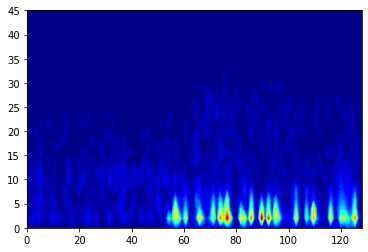

Predicted: 


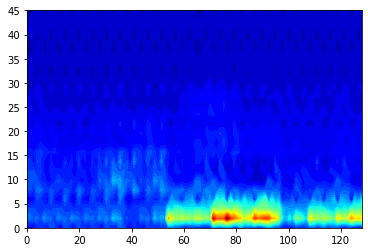

epoch [143/500], train loss:0.5021
epoch [143/500], val loss:1.6436
epoch [143/500], train accuracy:0.7457
epoch [143/500], val accuracy:0.6324


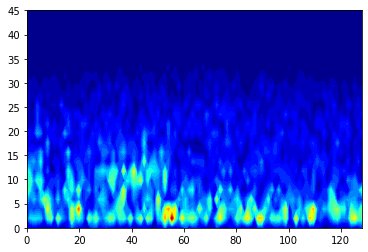

Predicted: 


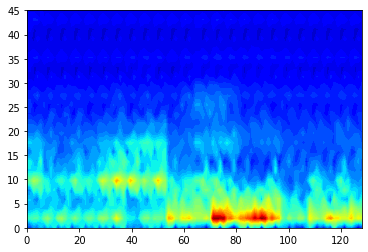

epoch [144/500], train loss:0.5037
epoch [144/500], val loss:1.6435
epoch [144/500], train accuracy:0.7586
epoch [144/500], val accuracy:0.6029


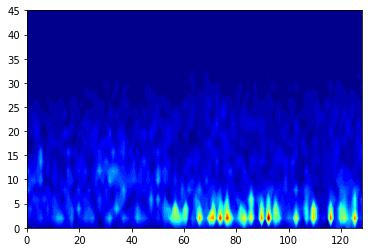

Predicted: 


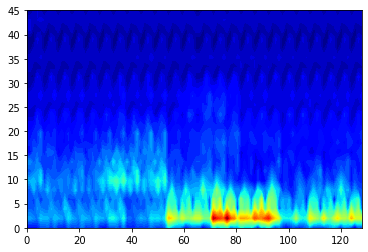

epoch [145/500], train loss:0.5011
epoch [145/500], val loss:1.6420
epoch [145/500], train accuracy:0.7414
epoch [145/500], val accuracy:0.6618


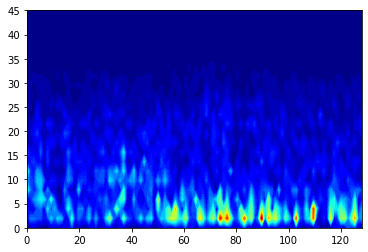

Predicted: 


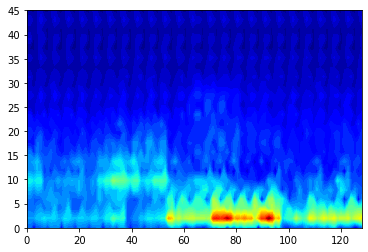

epoch [146/500], train loss:0.5006
epoch [146/500], val loss:1.6415
epoch [146/500], train accuracy:0.7543
epoch [146/500], val accuracy:0.6618


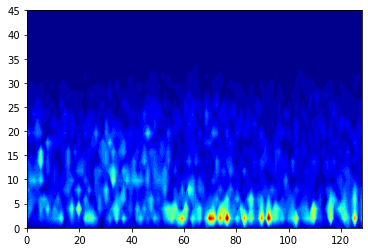

Predicted: 


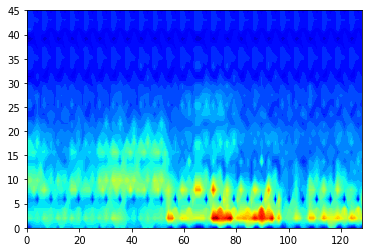

epoch [147/500], train loss:0.5020
epoch [147/500], val loss:1.6410
epoch [147/500], train accuracy:0.7328
epoch [147/500], val accuracy:0.6618


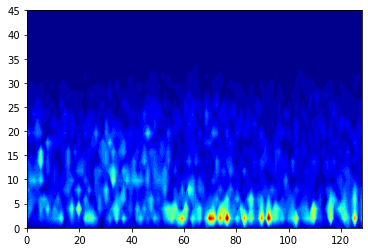

Predicted: 


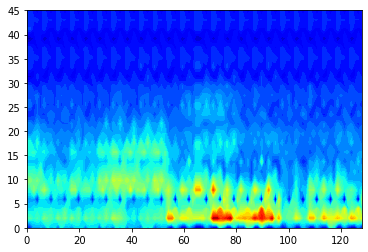

epoch [148/500], train loss:0.5101
epoch [148/500], val loss:1.6410
epoch [148/500], train accuracy:0.7414
epoch [148/500], val accuracy:0.6324


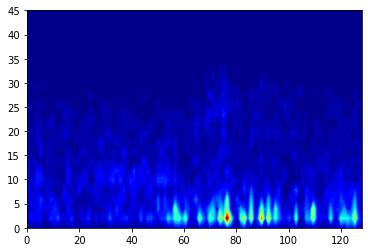

Predicted: 


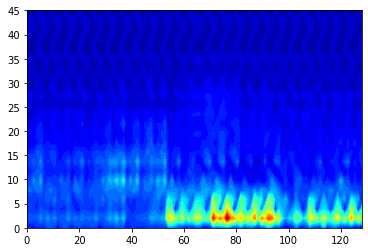

epoch [149/500], train loss:0.5000
epoch [149/500], val loss:1.6402
epoch [149/500], train accuracy:0.7457
epoch [149/500], val accuracy:0.6471


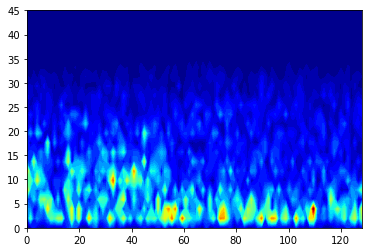

Predicted: 


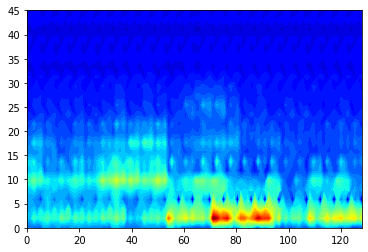

epoch [150/500], train loss:0.4996
epoch [150/500], val loss:1.6398
epoch [150/500], train accuracy:0.7586
epoch [150/500], val accuracy:0.6324


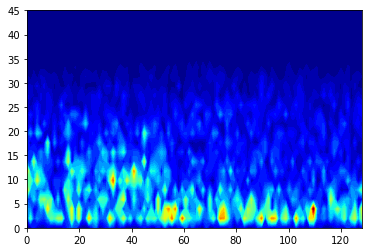

Predicted: 


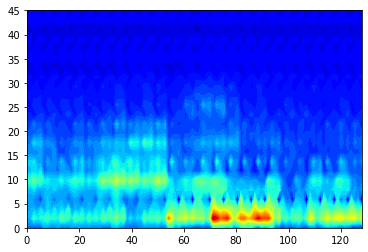

epoch [151/500], train loss:0.4976
epoch [151/500], val loss:1.6388
epoch [151/500], train accuracy:0.7371
epoch [151/500], val accuracy:0.6618


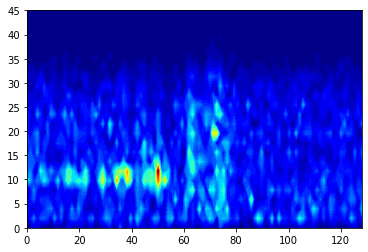

Predicted: 


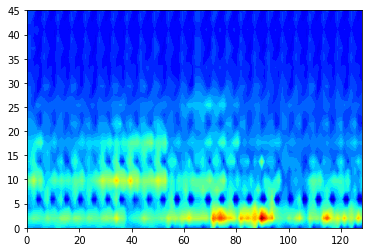

epoch [152/500], train loss:0.4996
epoch [152/500], val loss:1.6384
epoch [152/500], train accuracy:0.7586
epoch [152/500], val accuracy:0.6618


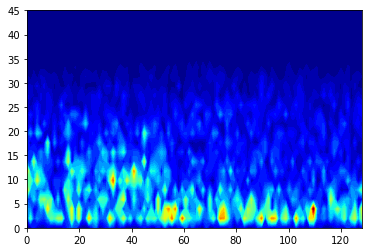

Predicted: 


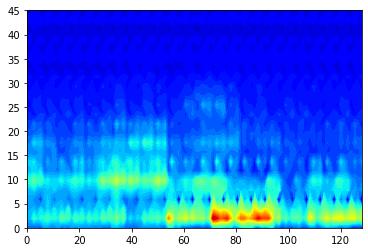

epoch [153/500], train loss:0.4981
epoch [153/500], val loss:1.6379
epoch [153/500], train accuracy:0.7457
epoch [153/500], val accuracy:0.6618


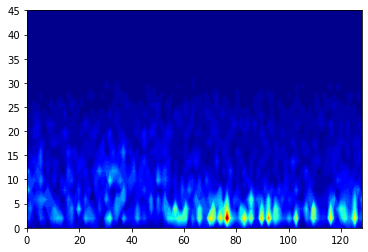

Predicted: 


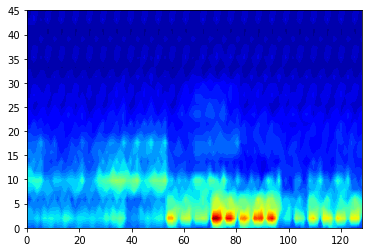

epoch [154/500], train loss:0.5012
epoch [154/500], val loss:1.6379
epoch [154/500], train accuracy:0.7629
epoch [154/500], val accuracy:0.6324


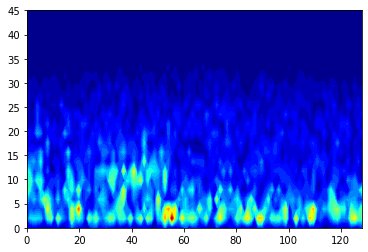

Predicted: 


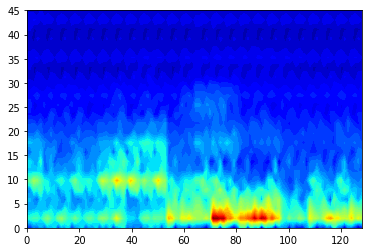

epoch [155/500], train loss:0.5047
epoch [155/500], val loss:1.6373
epoch [155/500], train accuracy:0.7284
epoch [155/500], val accuracy:0.6618


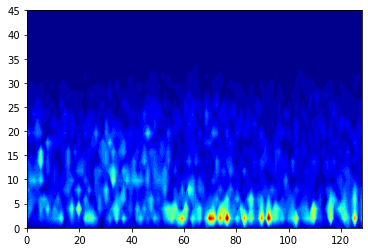

Predicted: 


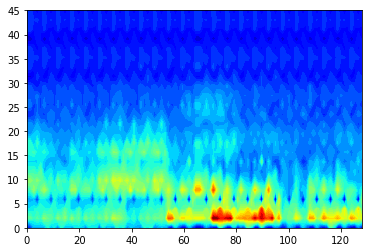

epoch [156/500], train loss:0.4953
epoch [156/500], val loss:1.6363
epoch [156/500], train accuracy:0.7672
epoch [156/500], val accuracy:0.6618


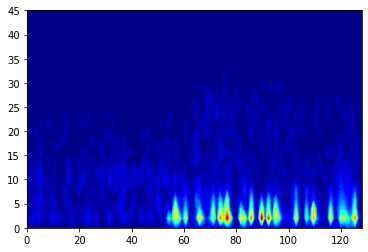

Predicted: 


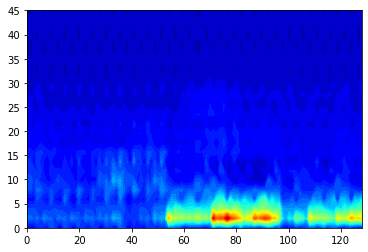

epoch [157/500], train loss:0.4996
epoch [157/500], val loss:1.6359
epoch [157/500], train accuracy:0.7457
epoch [157/500], val accuracy:0.6618


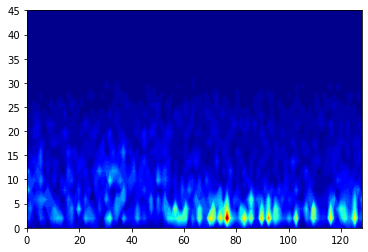

Predicted: 


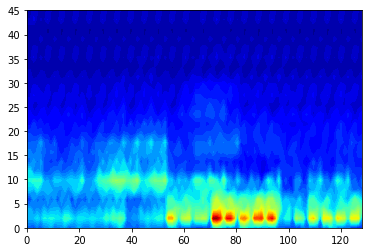

epoch [158/500], train loss:0.4954
epoch [158/500], val loss:1.6356
epoch [158/500], train accuracy:0.7586
epoch [158/500], val accuracy:0.6471


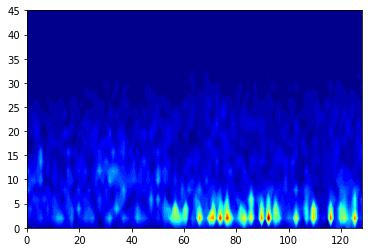

Predicted: 


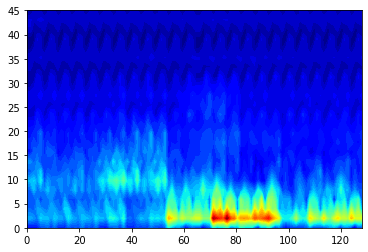

epoch [159/500], train loss:0.4962
epoch [159/500], val loss:1.6349
epoch [159/500], train accuracy:0.7974
epoch [159/500], val accuracy:0.6618


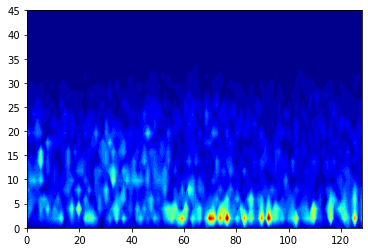

Predicted: 


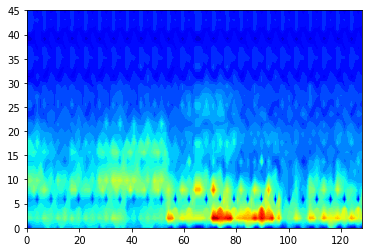

epoch [160/500], train loss:0.4944
epoch [160/500], val loss:1.6351
epoch [160/500], train accuracy:0.7629
epoch [160/500], val accuracy:0.6471


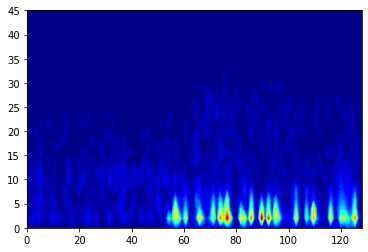

Predicted: 


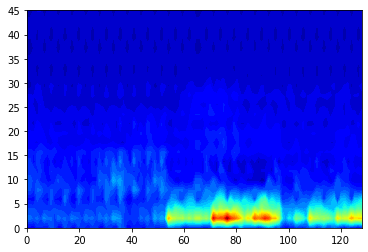

epoch [161/500], train loss:0.4916
epoch [161/500], val loss:1.6345
epoch [161/500], train accuracy:0.7931
epoch [161/500], val accuracy:0.6471


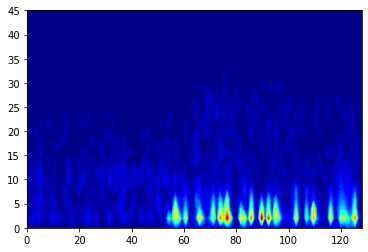

Predicted: 


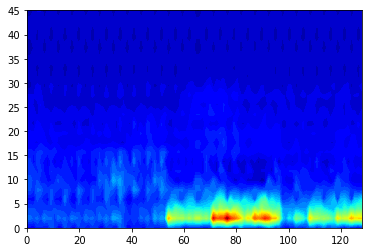

epoch [162/500], train loss:0.4963
epoch [162/500], val loss:1.6341
epoch [162/500], train accuracy:0.7586
epoch [162/500], val accuracy:0.6471


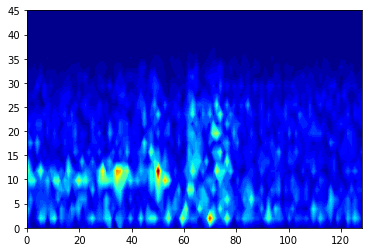

Predicted: 


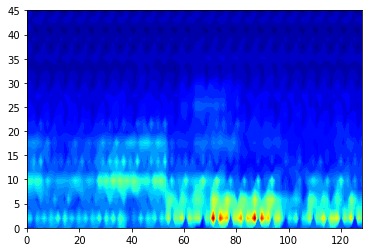

epoch [163/500], train loss:0.4920
epoch [163/500], val loss:1.6335
epoch [163/500], train accuracy:0.7586
epoch [163/500], val accuracy:0.6471


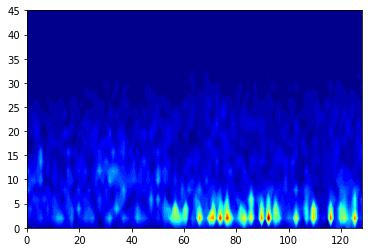

Predicted: 


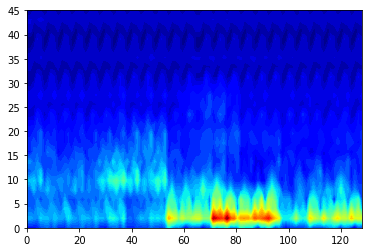

epoch [164/500], train loss:0.4903
epoch [164/500], val loss:1.6330
epoch [164/500], train accuracy:0.7759
epoch [164/500], val accuracy:0.6471


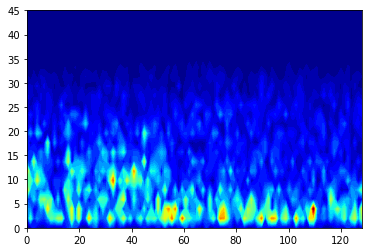

Predicted: 


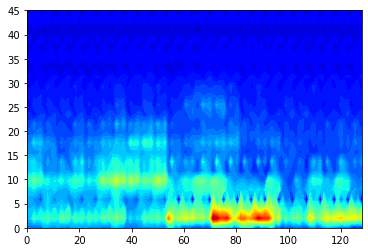

epoch [165/500], train loss:0.4908
epoch [165/500], val loss:1.6326
epoch [165/500], train accuracy:0.7802
epoch [165/500], val accuracy:0.6618


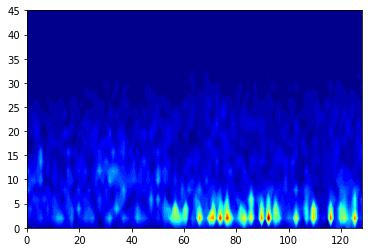

Predicted: 


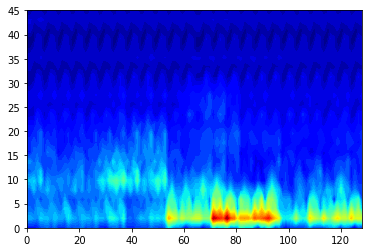

epoch [166/500], train loss:0.4927
epoch [166/500], val loss:1.6323
epoch [166/500], train accuracy:0.7586
epoch [166/500], val accuracy:0.6471


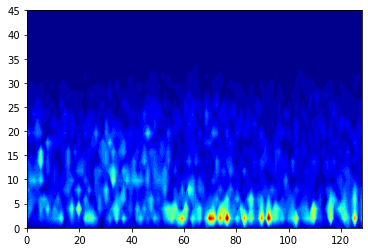

Predicted: 


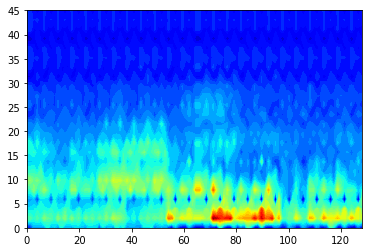

epoch [167/500], train loss:0.4900
epoch [167/500], val loss:1.6319
epoch [167/500], train accuracy:0.7802
epoch [167/500], val accuracy:0.6618


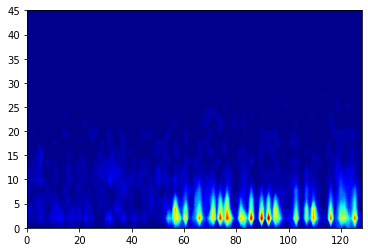

Predicted: 


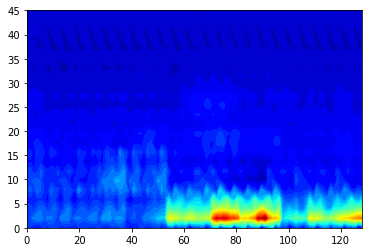

epoch [168/500], train loss:0.4910
epoch [168/500], val loss:1.6310
epoch [168/500], train accuracy:0.7716
epoch [168/500], val accuracy:0.6618


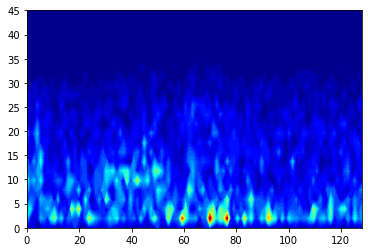

Predicted: 


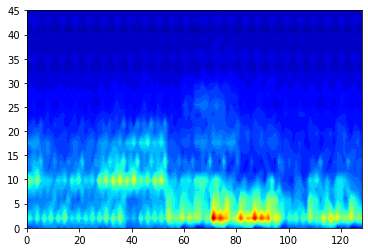

epoch [169/500], train loss:0.4915
epoch [169/500], val loss:1.6305
epoch [169/500], train accuracy:0.7543
epoch [169/500], val accuracy:0.6912


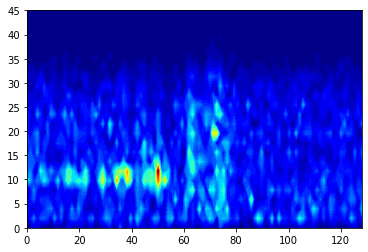

Predicted: 


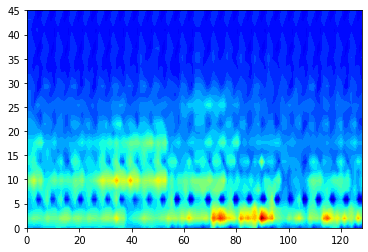

epoch [170/500], train loss:0.4894
epoch [170/500], val loss:1.6302
epoch [170/500], train accuracy:0.7629
epoch [170/500], val accuracy:0.6765


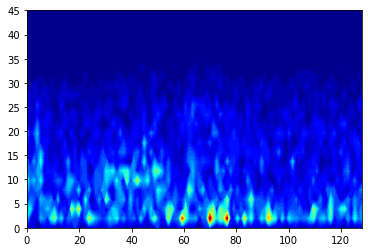

Predicted: 


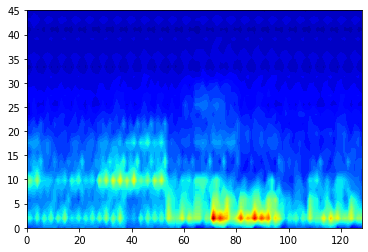

epoch [171/500], train loss:0.8102
epoch [171/500], val loss:1.6303
epoch [171/500], train accuracy:0.7586
epoch [171/500], val accuracy:0.6618


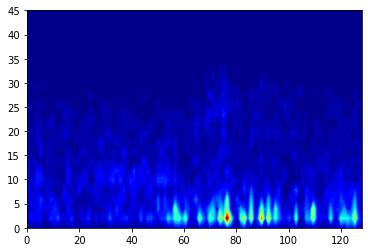

Predicted: 


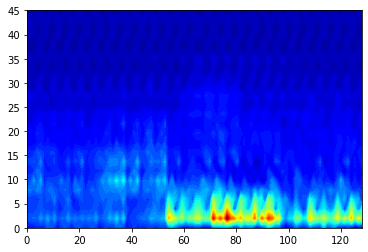

epoch [172/500], train loss:0.4887
epoch [172/500], val loss:1.6296
epoch [172/500], train accuracy:0.7802
epoch [172/500], val accuracy:0.6618


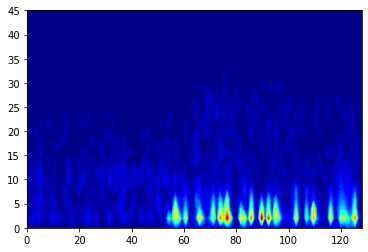

Predicted: 


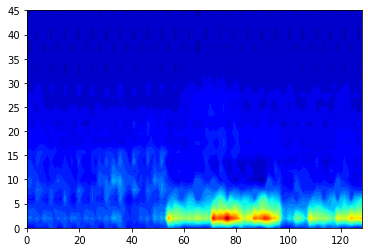

epoch [173/500], train loss:0.4889
epoch [173/500], val loss:1.6297
epoch [173/500], train accuracy:0.7672
epoch [173/500], val accuracy:0.6618


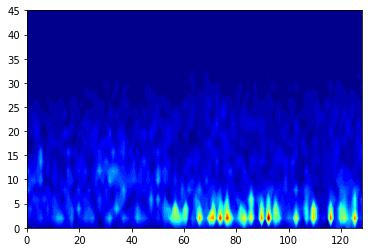

Predicted: 


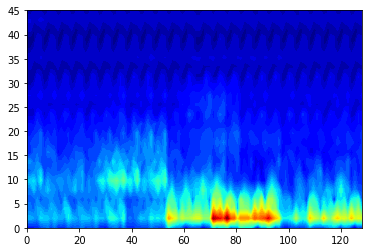

epoch [174/500], train loss:0.4872
epoch [174/500], val loss:1.6290
epoch [174/500], train accuracy:0.7802
epoch [174/500], val accuracy:0.6618


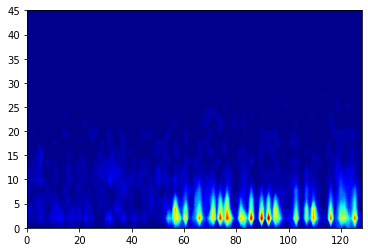

Predicted: 


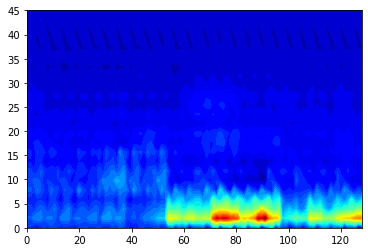

epoch [175/500], train loss:0.4862
epoch [175/500], val loss:1.6286
epoch [175/500], train accuracy:0.7586
epoch [175/500], val accuracy:0.6618


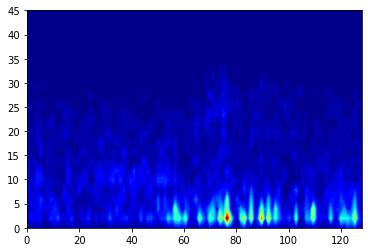

Predicted: 


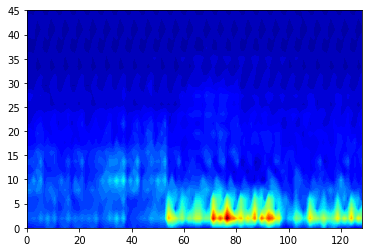

epoch [176/500], train loss:0.4864
epoch [176/500], val loss:1.6290
epoch [176/500], train accuracy:0.7672
epoch [176/500], val accuracy:0.6618


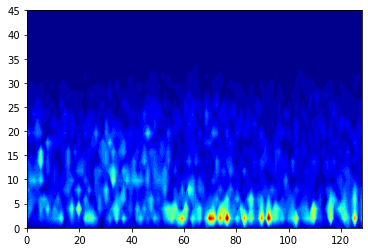

Predicted: 


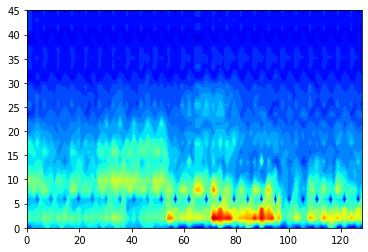

epoch [177/500], train loss:0.4873
epoch [177/500], val loss:1.6288
epoch [177/500], train accuracy:0.7629
epoch [177/500], val accuracy:0.6618


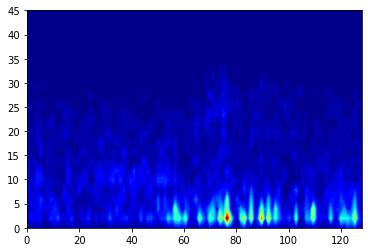

Predicted: 


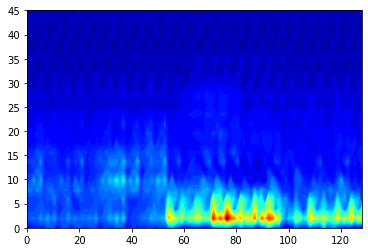

epoch [178/500], train loss:0.4853
epoch [178/500], val loss:1.6278
epoch [178/500], train accuracy:0.7845
epoch [178/500], val accuracy:0.6618


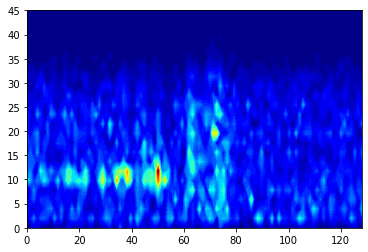

Predicted: 


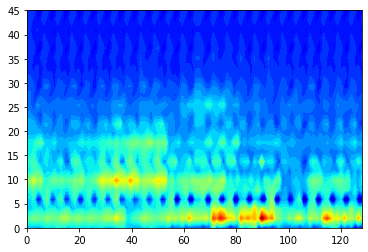

epoch [179/500], train loss:0.4840
epoch [179/500], val loss:1.6268
epoch [179/500], train accuracy:0.8060
epoch [179/500], val accuracy:0.6765


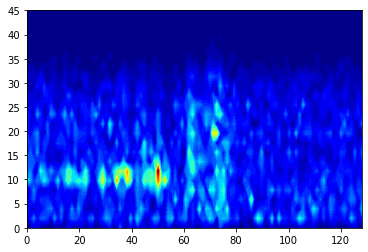

Predicted: 


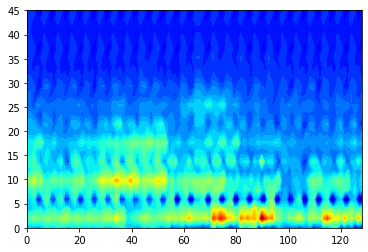

epoch [180/500], train loss:0.4856
epoch [180/500], val loss:1.6272
epoch [180/500], train accuracy:0.7931
epoch [180/500], val accuracy:0.6618


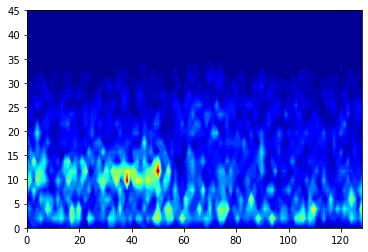

Predicted: 


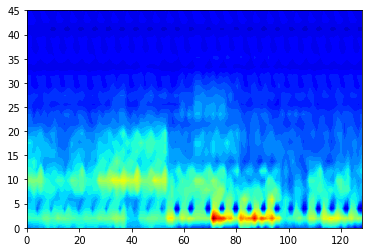

epoch [181/500], train loss:0.4831
epoch [181/500], val loss:1.6270
epoch [181/500], train accuracy:0.7629
epoch [181/500], val accuracy:0.6618


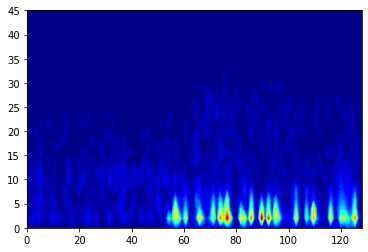

Predicted: 


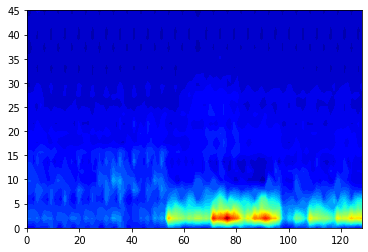

epoch [182/500], train loss:0.4829
epoch [182/500], val loss:1.6262
epoch [182/500], train accuracy:0.8017
epoch [182/500], val accuracy:0.6765


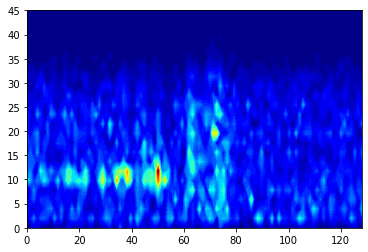

Predicted: 


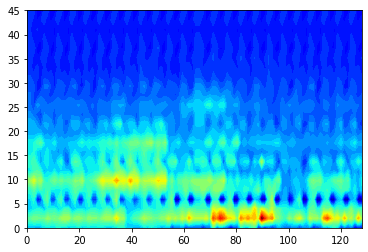

epoch [183/500], train loss:0.4854
epoch [183/500], val loss:1.6263
epoch [183/500], train accuracy:0.7974
epoch [183/500], val accuracy:0.6618


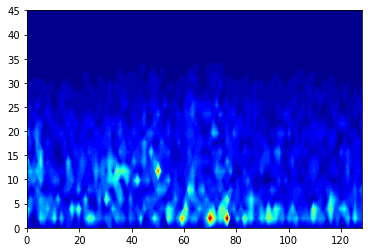

Predicted: 


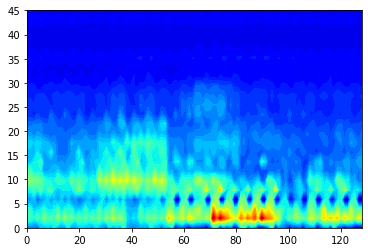

epoch [184/500], train loss:0.4844
epoch [184/500], val loss:1.6258
epoch [184/500], train accuracy:0.7931
epoch [184/500], val accuracy:0.6618


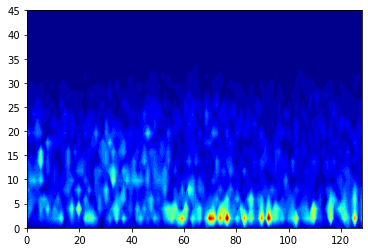

Predicted: 


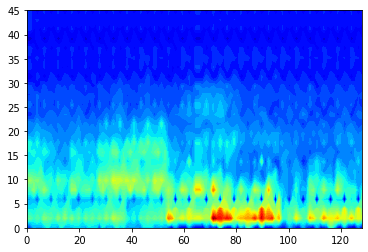

epoch [185/500], train loss:0.4818
epoch [185/500], val loss:1.6255
epoch [185/500], train accuracy:0.7931
epoch [185/500], val accuracy:0.6618


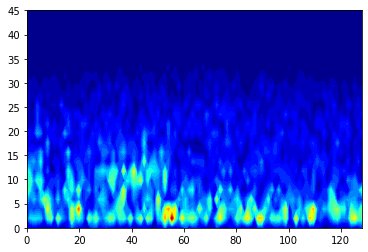

Predicted: 


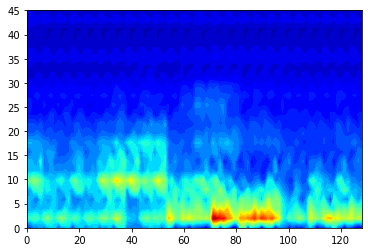

epoch [186/500], train loss:0.4821
epoch [186/500], val loss:1.6253
epoch [186/500], train accuracy:0.7888
epoch [186/500], val accuracy:0.6618


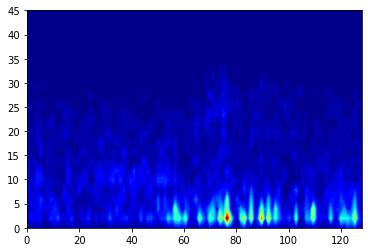

Predicted: 


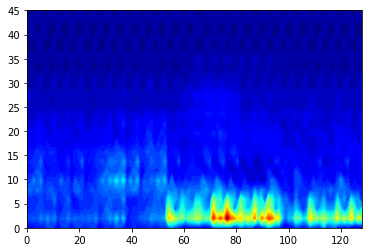

epoch [187/500], train loss:0.5026
epoch [187/500], val loss:1.6247
epoch [187/500], train accuracy:0.7629
epoch [187/500], val accuracy:0.6618


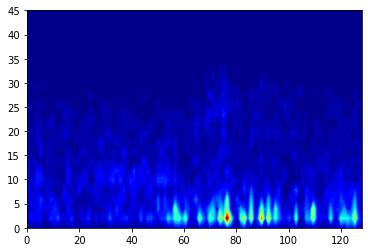

Predicted: 


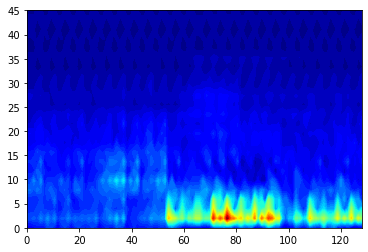

epoch [188/500], train loss:0.4812
epoch [188/500], val loss:1.6239
epoch [188/500], train accuracy:0.7845
epoch [188/500], val accuracy:0.6765


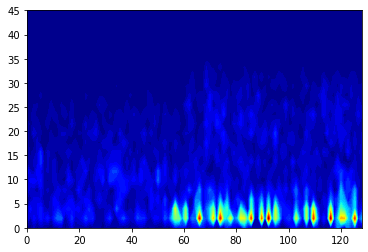

Predicted: 


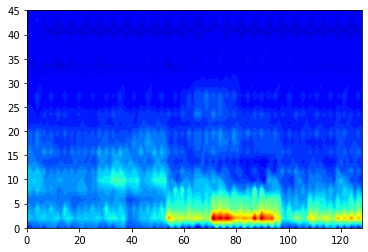

epoch [189/500], train loss:0.4827
epoch [189/500], val loss:1.6240
epoch [189/500], train accuracy:0.7629
epoch [189/500], val accuracy:0.6765


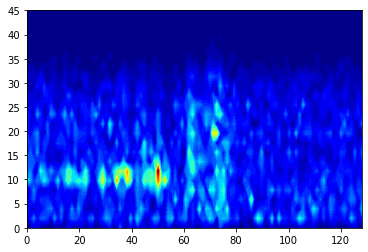

Predicted: 


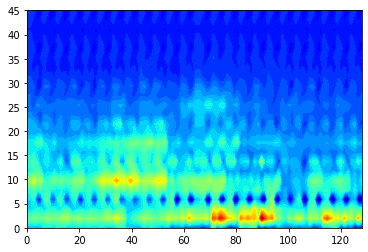

epoch [190/500], train loss:0.4802
epoch [190/500], val loss:1.6237
epoch [190/500], train accuracy:0.7931
epoch [190/500], val accuracy:0.6765


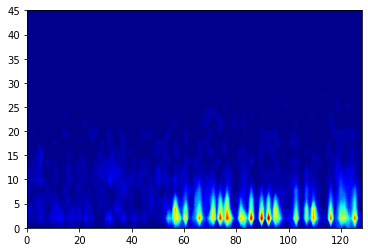

Predicted: 


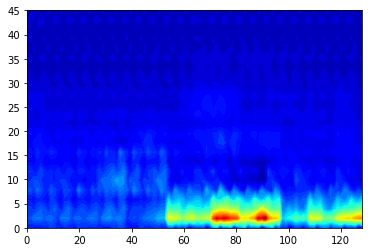

epoch [191/500], train loss:0.4810
epoch [191/500], val loss:1.6237
epoch [191/500], train accuracy:0.7802
epoch [191/500], val accuracy:0.6765


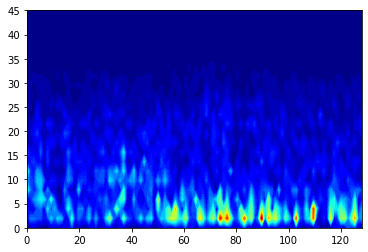

Predicted: 


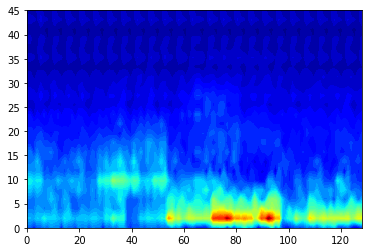

epoch [192/500], train loss:0.4808
epoch [192/500], val loss:1.6240
epoch [192/500], train accuracy:0.7672
epoch [192/500], val accuracy:0.6618


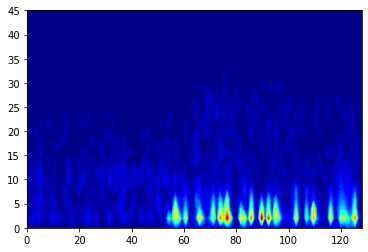

Predicted: 


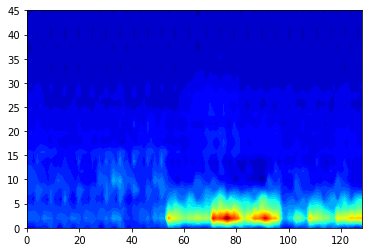

epoch [193/500], train loss:0.4786
epoch [193/500], val loss:1.6226
epoch [193/500], train accuracy:0.7888
epoch [193/500], val accuracy:0.6765


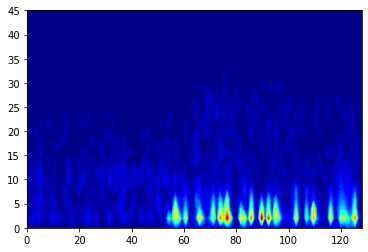

Predicted: 


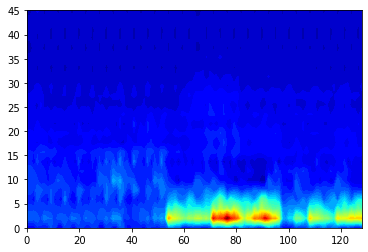

epoch [194/500], train loss:0.4800
epoch [194/500], val loss:1.6221
epoch [194/500], train accuracy:0.7802
epoch [194/500], val accuracy:0.6765


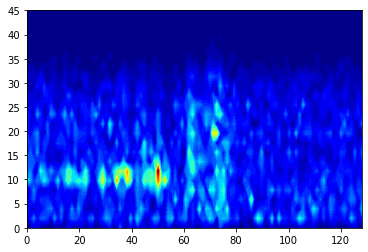

Predicted: 


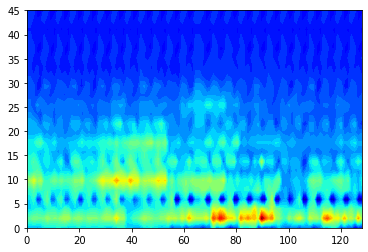

epoch [195/500], train loss:0.4773
epoch [195/500], val loss:1.6224
epoch [195/500], train accuracy:0.8060
epoch [195/500], val accuracy:0.6765


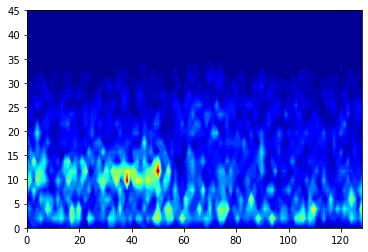

Predicted: 


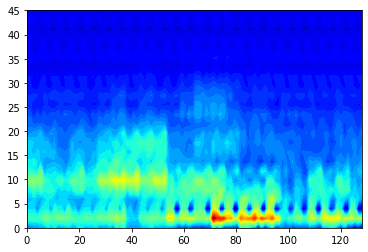

epoch [196/500], train loss:0.4764
epoch [196/500], val loss:1.6224
epoch [196/500], train accuracy:0.8103
epoch [196/500], val accuracy:0.6765


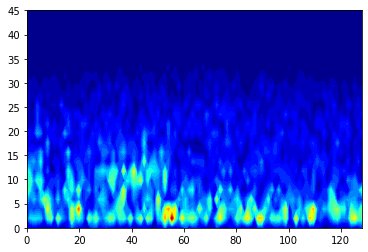

Predicted: 


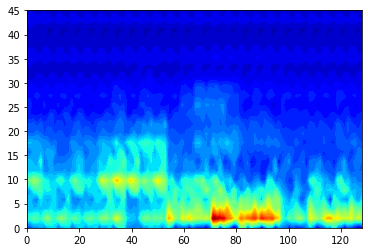

epoch [197/500], train loss:0.4752
epoch [197/500], val loss:1.6219
epoch [197/500], train accuracy:0.8103
epoch [197/500], val accuracy:0.6765


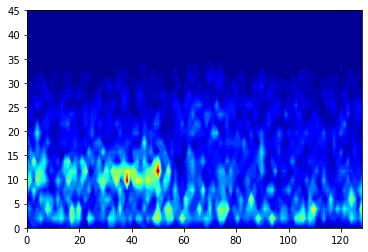

Predicted: 


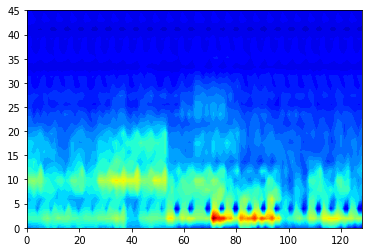

epoch [198/500], train loss:0.4792
epoch [198/500], val loss:1.6215
epoch [198/500], train accuracy:0.7845
epoch [198/500], val accuracy:0.6765


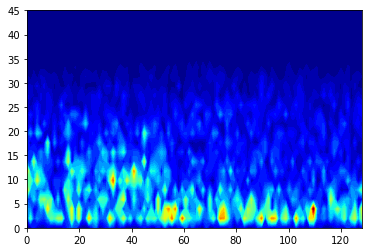

Predicted: 


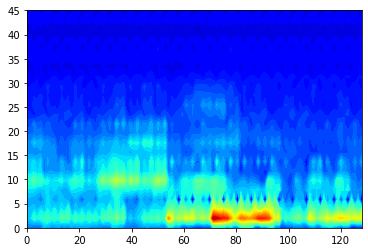

epoch [199/500], train loss:0.4818
epoch [199/500], val loss:1.6211
epoch [199/500], train accuracy:0.7974
epoch [199/500], val accuracy:0.6765


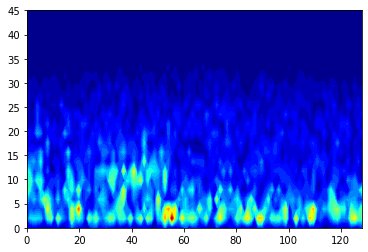

Predicted: 


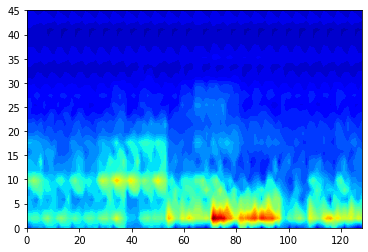

epoch [200/500], train loss:0.4783
epoch [200/500], val loss:1.6206
epoch [200/500], train accuracy:0.7888
epoch [200/500], val accuracy:0.6765


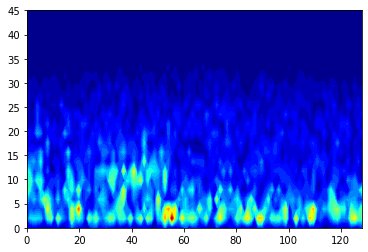

Predicted: 


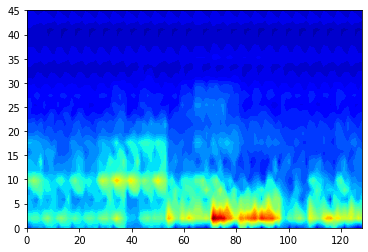

epoch [201/500], train loss:0.4789
epoch [201/500], val loss:1.6206
epoch [201/500], train accuracy:0.8017
epoch [201/500], val accuracy:0.6765


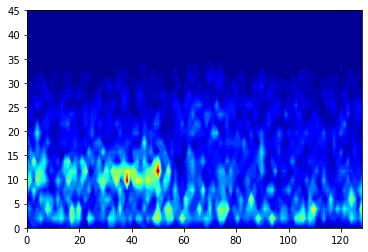

Predicted: 


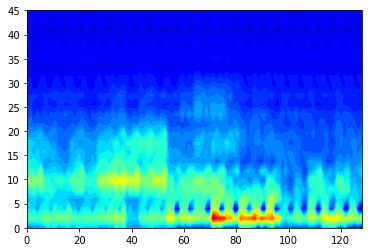

epoch [202/500], train loss:0.4728
epoch [202/500], val loss:1.6204
epoch [202/500], train accuracy:0.7845
epoch [202/500], val accuracy:0.6765


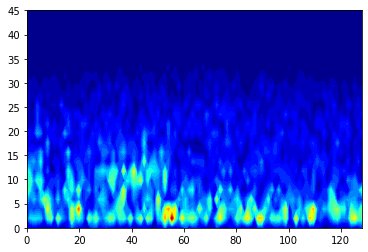

Predicted: 


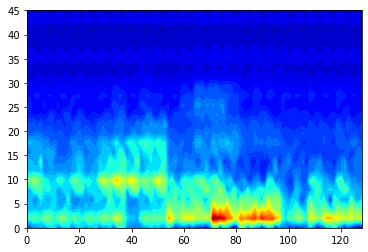

epoch [203/500], train loss:0.4747
epoch [203/500], val loss:1.6198
epoch [203/500], train accuracy:0.8060
epoch [203/500], val accuracy:0.6765


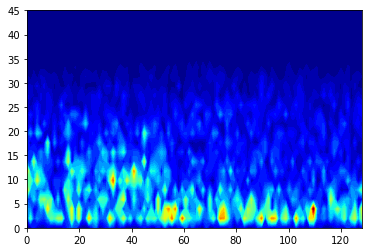

Predicted: 


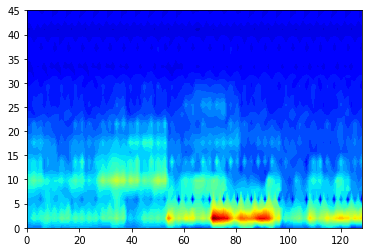

epoch [204/500], train loss:0.7942
epoch [204/500], val loss:1.6195
epoch [204/500], train accuracy:0.7888
epoch [204/500], val accuracy:0.6765


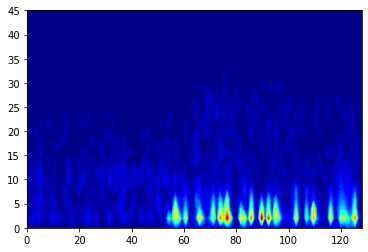

Predicted: 


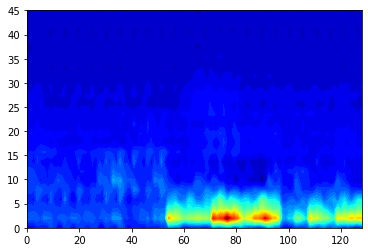

epoch [205/500], train loss:0.4744
epoch [205/500], val loss:1.6197
epoch [205/500], train accuracy:0.8060
epoch [205/500], val accuracy:0.6618


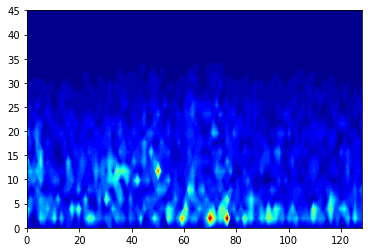

Predicted: 


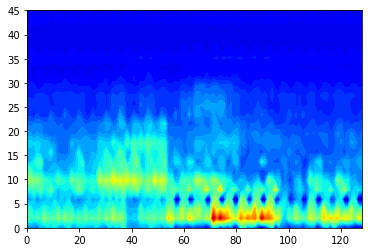

epoch [206/500], train loss:0.4738
epoch [206/500], val loss:1.6199
epoch [206/500], train accuracy:0.8276
epoch [206/500], val accuracy:0.6618


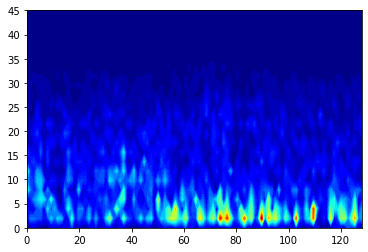

Predicted: 


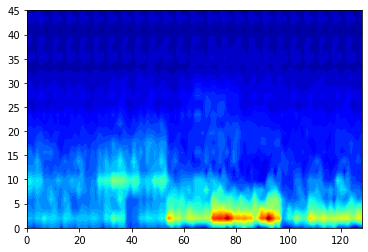

epoch [207/500], train loss:0.4729
epoch [207/500], val loss:1.6196
epoch [207/500], train accuracy:0.8060
epoch [207/500], val accuracy:0.6618


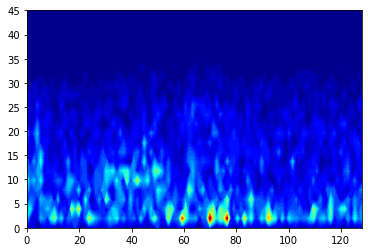

Predicted: 


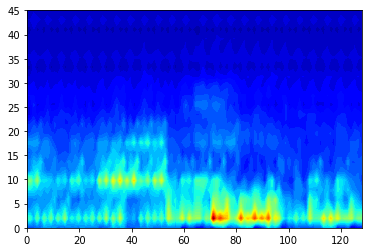

epoch [208/500], train loss:0.4722
epoch [208/500], val loss:1.6189
epoch [208/500], train accuracy:0.8017
epoch [208/500], val accuracy:0.6765


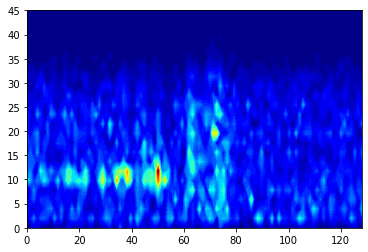

Predicted: 


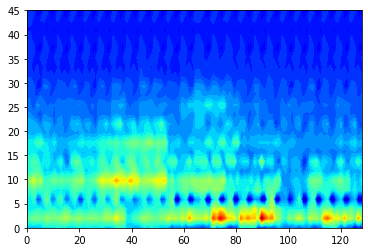

epoch [209/500], train loss:0.4707
epoch [209/500], val loss:1.6183
epoch [209/500], train accuracy:0.8147
epoch [209/500], val accuracy:0.6765


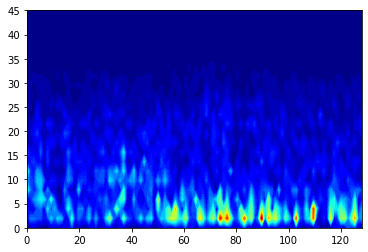

Predicted: 


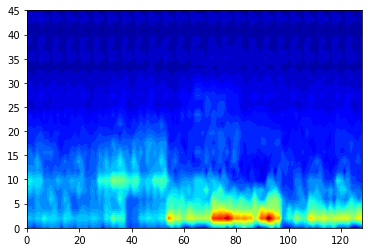

epoch [210/500], train loss:0.4710
epoch [210/500], val loss:1.6182
epoch [210/500], train accuracy:0.8060
epoch [210/500], val accuracy:0.6765


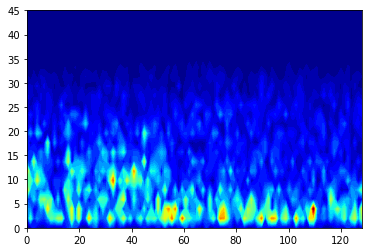

Predicted: 


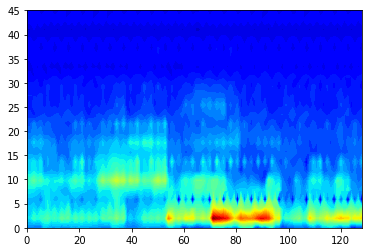

epoch [211/500], train loss:0.4713
epoch [211/500], val loss:1.6181
epoch [211/500], train accuracy:0.8060
epoch [211/500], val accuracy:0.6765


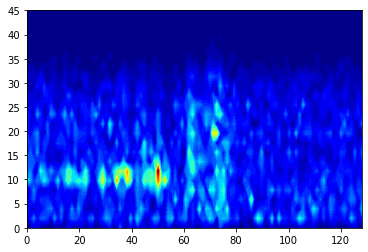

Predicted: 


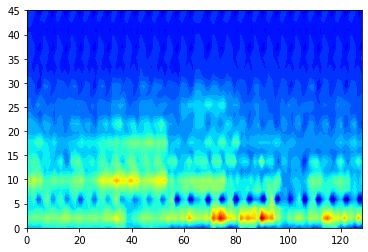

epoch [212/500], train loss:0.5260
epoch [212/500], val loss:1.6175
epoch [212/500], train accuracy:0.7888
epoch [212/500], val accuracy:0.6765


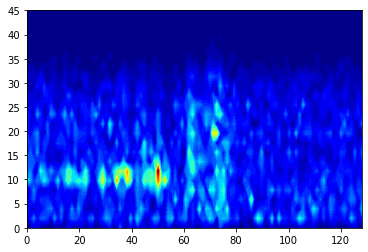

Predicted: 


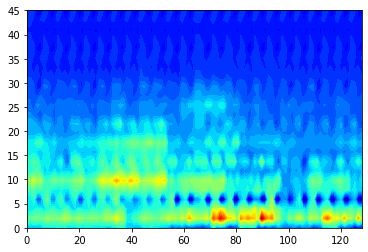

epoch [213/500], train loss:0.4699
epoch [213/500], val loss:1.6173
epoch [213/500], train accuracy:0.8233
epoch [213/500], val accuracy:0.6765


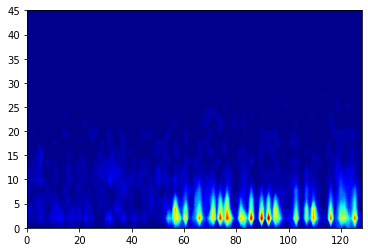

Predicted: 


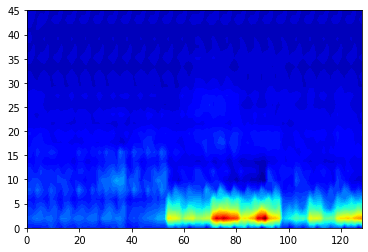

epoch [214/500], train loss:0.4750
epoch [214/500], val loss:1.6170
epoch [214/500], train accuracy:0.8103
epoch [214/500], val accuracy:0.6765


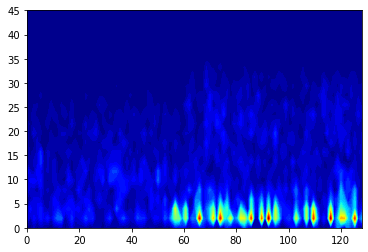

Predicted: 


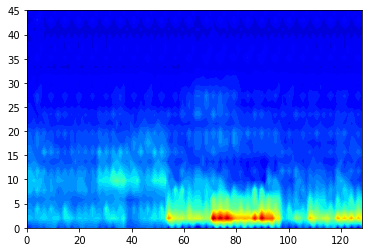

epoch [215/500], train loss:0.4720
epoch [215/500], val loss:1.6173
epoch [215/500], train accuracy:0.8103
epoch [215/500], val accuracy:0.6765


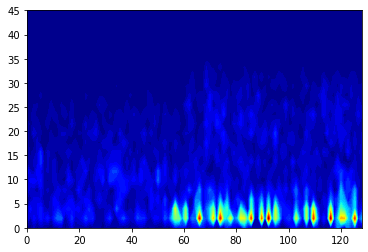

Predicted: 


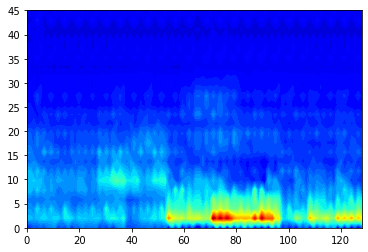

epoch [216/500], train loss:0.4708
epoch [216/500], val loss:1.6173
epoch [216/500], train accuracy:0.8147
epoch [216/500], val accuracy:0.6618


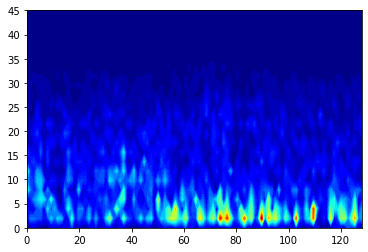

Predicted: 


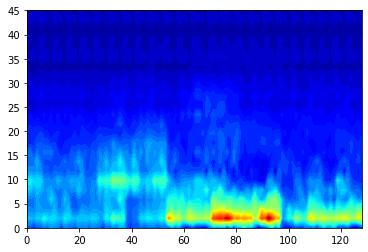

epoch [217/500], train loss:0.4685
epoch [217/500], val loss:1.6165
epoch [217/500], train accuracy:0.8190
epoch [217/500], val accuracy:0.6765


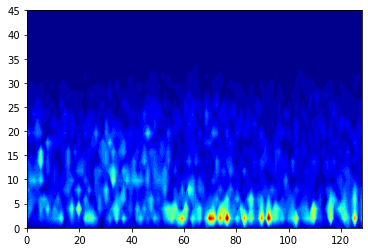

Predicted: 


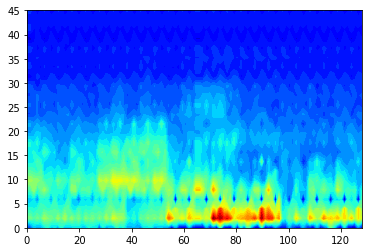

epoch [218/500], train loss:0.4703
epoch [218/500], val loss:1.6161
epoch [218/500], train accuracy:0.8017
epoch [218/500], val accuracy:0.6765


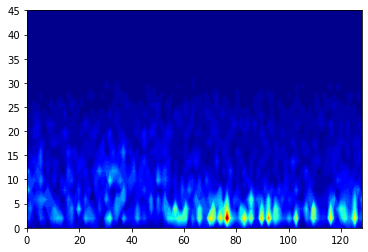

Predicted: 


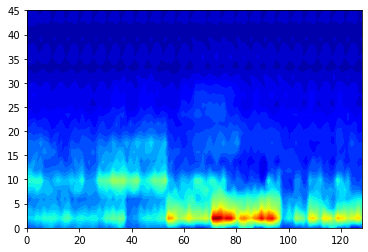

epoch [219/500], train loss:0.4683
epoch [219/500], val loss:1.6159
epoch [219/500], train accuracy:0.8190
epoch [219/500], val accuracy:0.6765


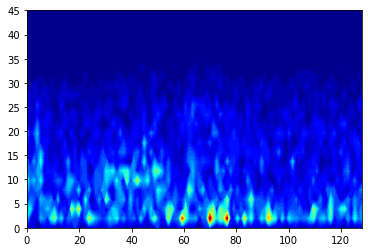

Predicted: 


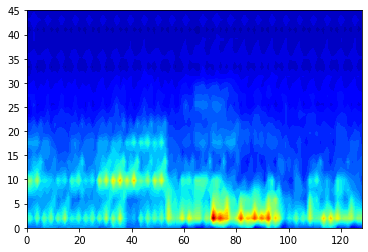

epoch [220/500], train loss:0.4660
epoch [220/500], val loss:1.6162
epoch [220/500], train accuracy:0.8017
epoch [220/500], val accuracy:0.6765


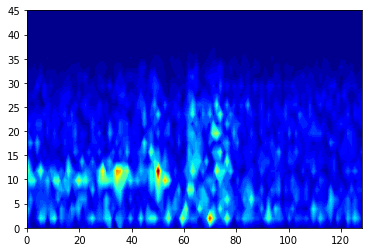

Predicted: 


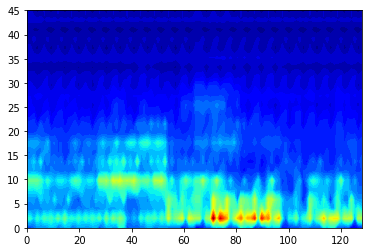

epoch [221/500], train loss:0.4670
epoch [221/500], val loss:1.6167
epoch [221/500], train accuracy:0.7888
epoch [221/500], val accuracy:0.6618


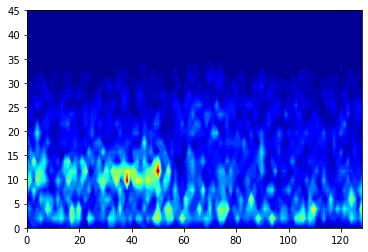

Predicted: 


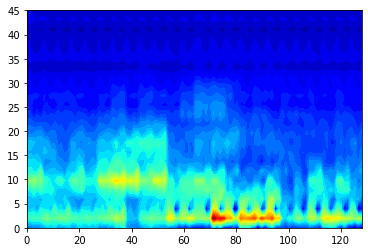

epoch [222/500], train loss:0.4642
epoch [222/500], val loss:1.6159
epoch [222/500], train accuracy:0.8103
epoch [222/500], val accuracy:0.6765


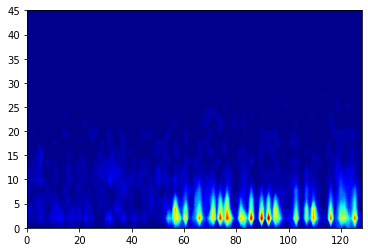

Predicted: 


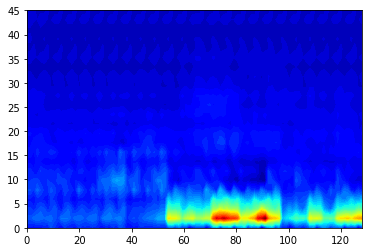

epoch [223/500], train loss:0.4661
epoch [223/500], val loss:1.6160
epoch [223/500], train accuracy:0.8147
epoch [223/500], val accuracy:0.6765


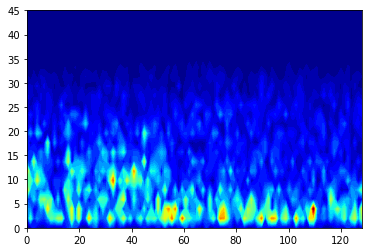

Predicted: 


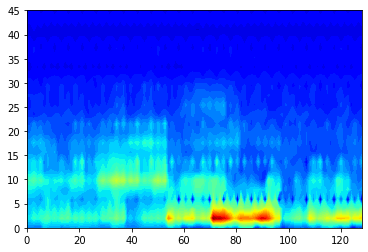

epoch [224/500], train loss:0.4679
epoch [224/500], val loss:1.6151
epoch [224/500], train accuracy:0.8190
epoch [224/500], val accuracy:0.6765


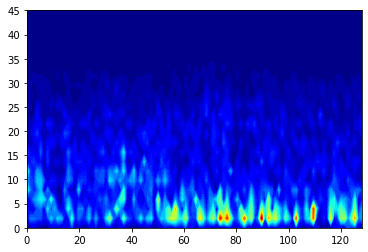

Predicted: 


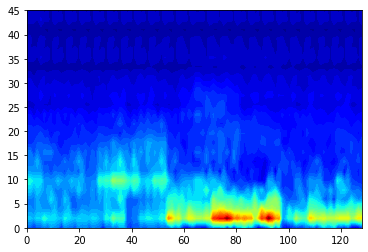

epoch [225/500], train loss:0.4659
epoch [225/500], val loss:1.6151
epoch [225/500], train accuracy:0.7974
epoch [225/500], val accuracy:0.6765


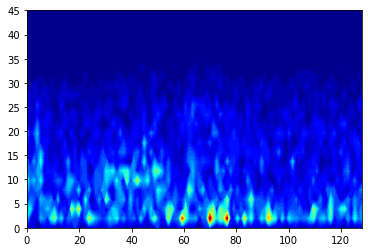

Predicted: 


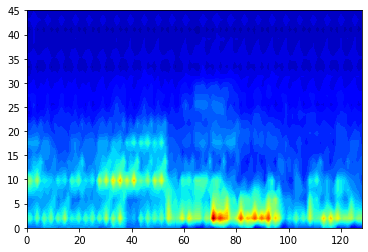

epoch [226/500], train loss:0.4626
epoch [226/500], val loss:1.6150
epoch [226/500], train accuracy:0.8319
epoch [226/500], val accuracy:0.6765


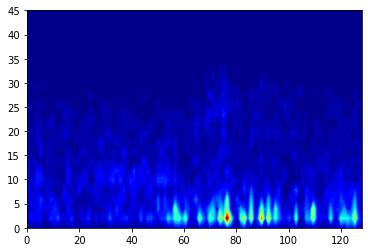

Predicted: 


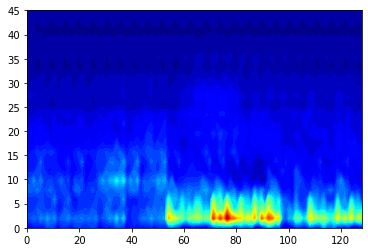

epoch [227/500], train loss:0.4630
epoch [227/500], val loss:1.6146
epoch [227/500], train accuracy:0.8362
epoch [227/500], val accuracy:0.6765


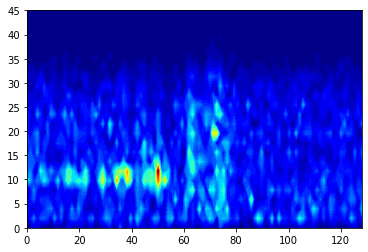

Predicted: 


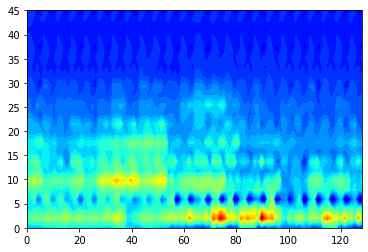

epoch [228/500], train loss:0.4603
epoch [228/500], val loss:1.6143
epoch [228/500], train accuracy:0.8190
epoch [228/500], val accuracy:0.6765


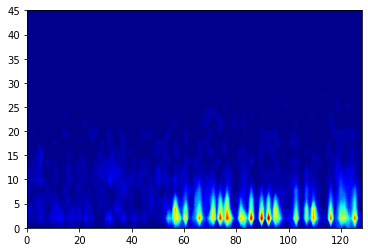

Predicted: 


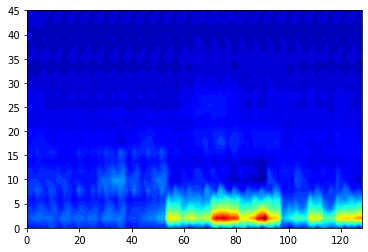

epoch [229/500], train loss:0.4626
epoch [229/500], val loss:1.6144
epoch [229/500], train accuracy:0.8103
epoch [229/500], val accuracy:0.6765


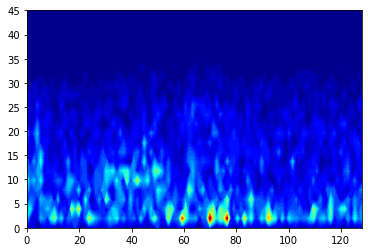

Predicted: 


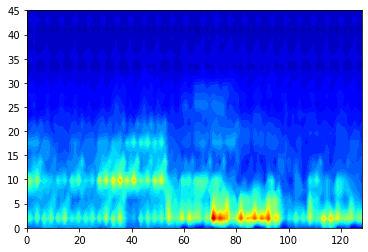

epoch [230/500], train loss:0.4651
epoch [230/500], val loss:1.6139
epoch [230/500], train accuracy:0.8190
epoch [230/500], val accuracy:0.6765


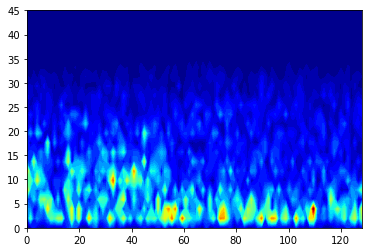

Predicted: 


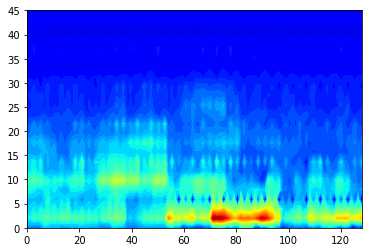

epoch [231/500], train loss:0.4626
epoch [231/500], val loss:1.6135
epoch [231/500], train accuracy:0.7931
epoch [231/500], val accuracy:0.6765


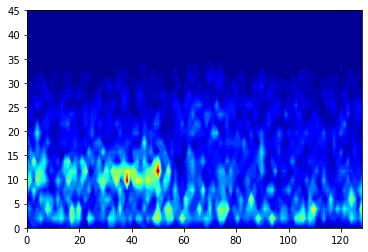

Predicted: 


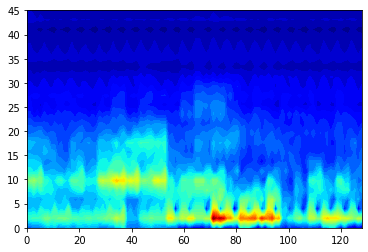

epoch [232/500], train loss:0.4636
epoch [232/500], val loss:1.6132
epoch [232/500], train accuracy:0.7931
epoch [232/500], val accuracy:0.6765


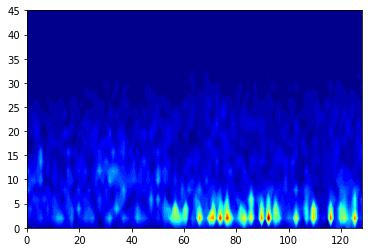

Predicted: 


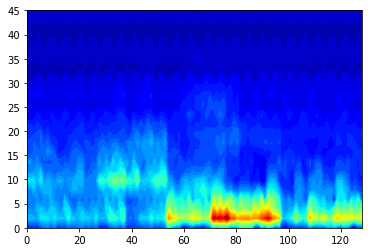

epoch [233/500], train loss:0.4631
epoch [233/500], val loss:1.6136
epoch [233/500], train accuracy:0.8103
epoch [233/500], val accuracy:0.6765


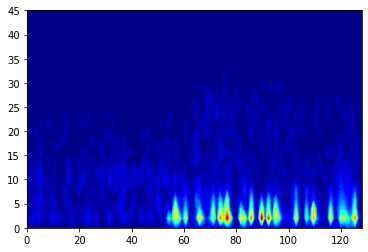

Predicted: 


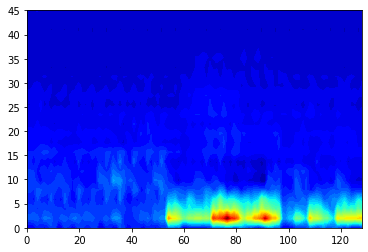

epoch [234/500], train loss:0.4587
epoch [234/500], val loss:1.6135
epoch [234/500], train accuracy:0.8190
epoch [234/500], val accuracy:0.6765


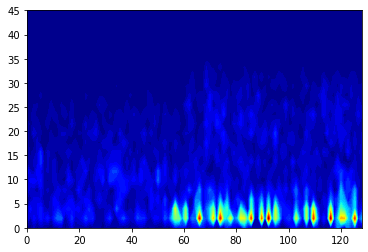

Predicted: 


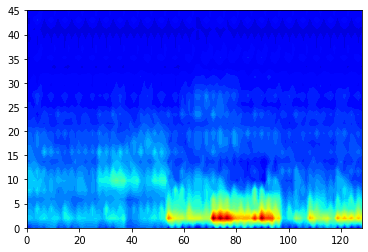

epoch [235/500], train loss:0.4600
epoch [235/500], val loss:1.6131
epoch [235/500], train accuracy:0.8319
epoch [235/500], val accuracy:0.6765


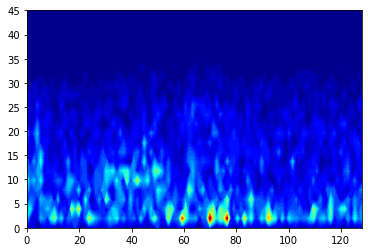

Predicted: 


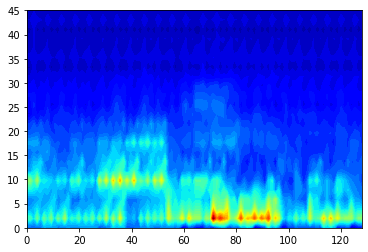

epoch [236/500], train loss:0.4604
epoch [236/500], val loss:1.6128
epoch [236/500], train accuracy:0.8319
epoch [236/500], val accuracy:0.6765


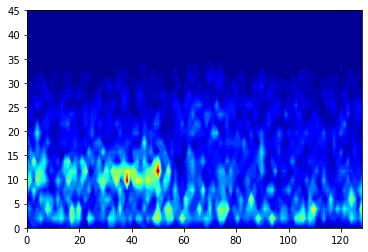

Predicted: 


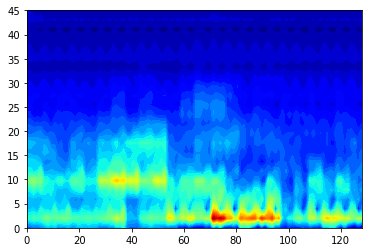

epoch [237/500], train loss:0.4623
epoch [237/500], val loss:1.6123
epoch [237/500], train accuracy:0.8103
epoch [237/500], val accuracy:0.6765


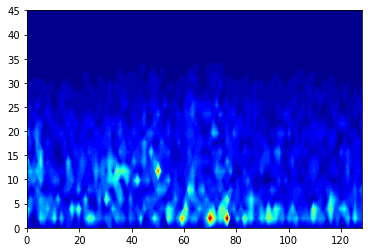

Predicted: 


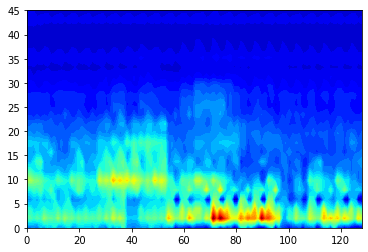

epoch [238/500], train loss:0.4609
epoch [238/500], val loss:1.6121
epoch [238/500], train accuracy:0.8017
epoch [238/500], val accuracy:0.6765


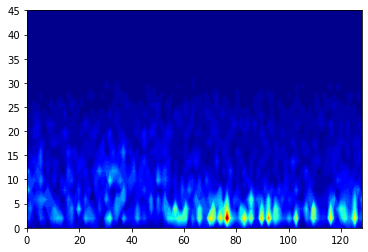

Predicted: 


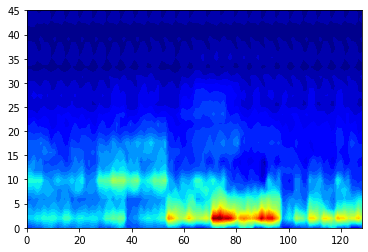

epoch [239/500], train loss:0.4593
epoch [239/500], val loss:1.6116
epoch [239/500], train accuracy:0.8276
epoch [239/500], val accuracy:0.6765


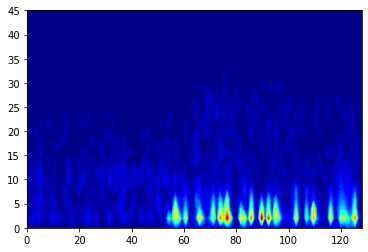

Predicted: 


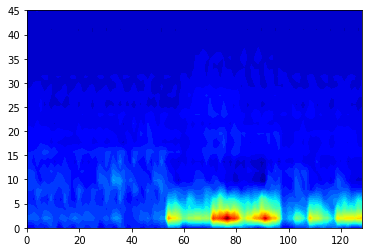

epoch [240/500], train loss:0.4617
epoch [240/500], val loss:1.6116
epoch [240/500], train accuracy:0.8319
epoch [240/500], val accuracy:0.6765


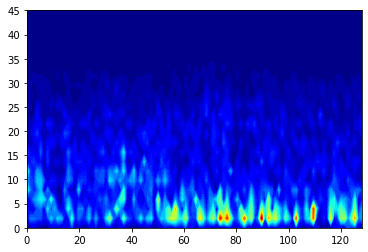

Predicted: 


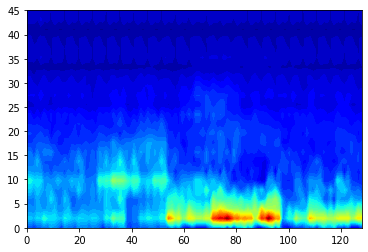

epoch [241/500], train loss:0.4603
epoch [241/500], val loss:1.6113
epoch [241/500], train accuracy:0.8233
epoch [241/500], val accuracy:0.6912


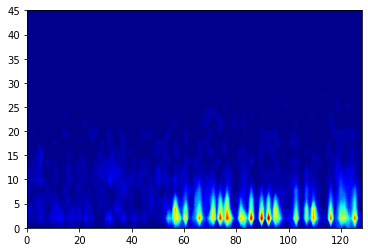

Predicted: 


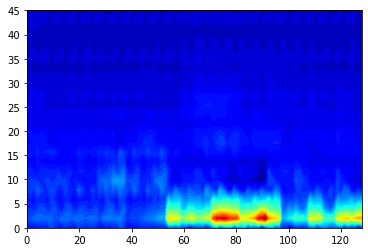

epoch [242/500], train loss:0.4564
epoch [242/500], val loss:1.6110
epoch [242/500], train accuracy:0.8276
epoch [242/500], val accuracy:0.6912


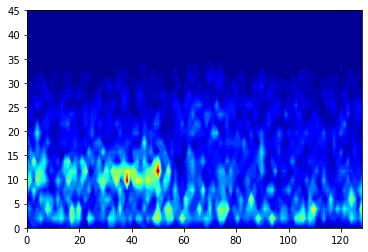

Predicted: 


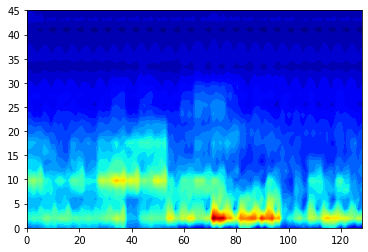

epoch [243/500], train loss:0.4586
epoch [243/500], val loss:1.6111
epoch [243/500], train accuracy:0.8319
epoch [243/500], val accuracy:0.6765


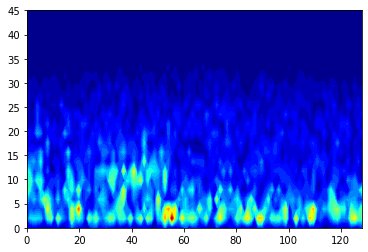

Predicted: 


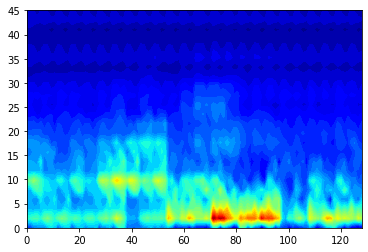

epoch [244/500], train loss:0.4567
epoch [244/500], val loss:1.6105
epoch [244/500], train accuracy:0.8190
epoch [244/500], val accuracy:0.7206


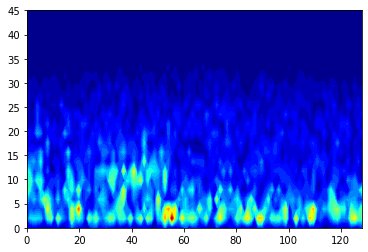

Predicted: 


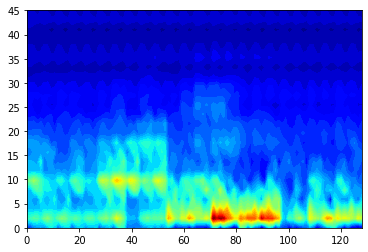

epoch [245/500], train loss:0.4587
epoch [245/500], val loss:1.6117
epoch [245/500], train accuracy:0.8147
epoch [245/500], val accuracy:0.6471


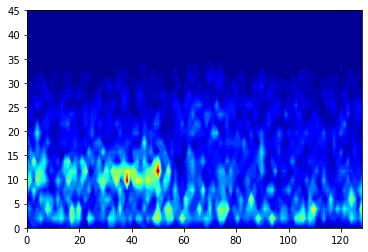

Predicted: 


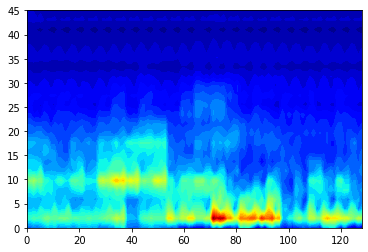

epoch [246/500], train loss:0.4584
epoch [246/500], val loss:1.6105
epoch [246/500], train accuracy:0.8319
epoch [246/500], val accuracy:0.7059


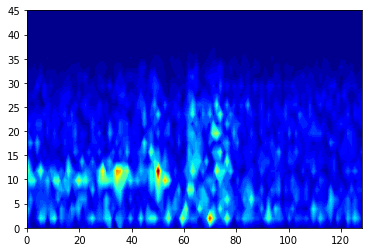

Predicted: 


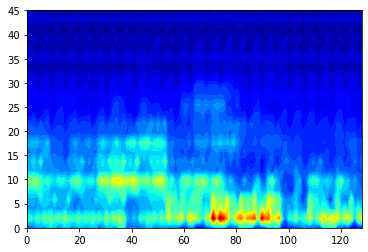

epoch [247/500], train loss:0.4565
epoch [247/500], val loss:1.6104
epoch [247/500], train accuracy:0.8147
epoch [247/500], val accuracy:0.7059


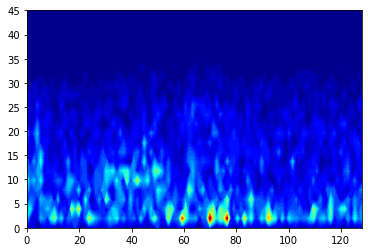

Predicted: 


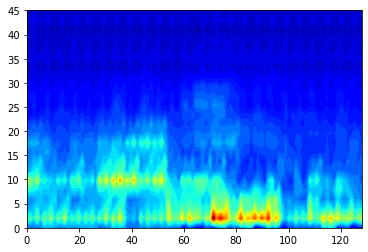

epoch [248/500], train loss:0.4744
epoch [248/500], val loss:1.6098
epoch [248/500], train accuracy:0.8190
epoch [248/500], val accuracy:0.7206


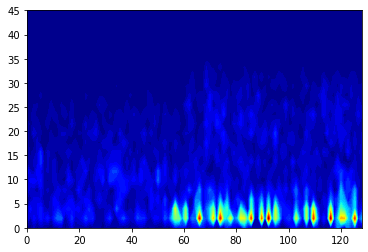

Predicted: 


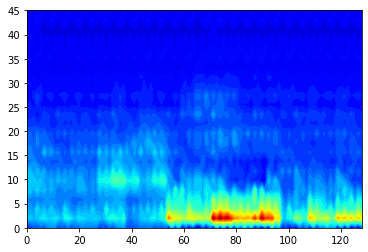

epoch [249/500], train loss:0.4553
epoch [249/500], val loss:1.6104
epoch [249/500], train accuracy:0.8017
epoch [249/500], val accuracy:0.6618


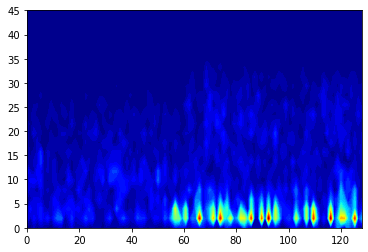

Predicted: 


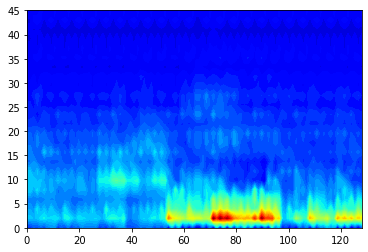

epoch [250/500], train loss:0.4554
epoch [250/500], val loss:1.6097
epoch [250/500], train accuracy:0.8233
epoch [250/500], val accuracy:0.7206


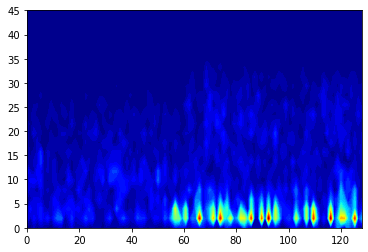

Predicted: 


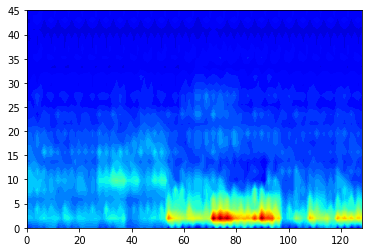

epoch [251/500], train loss:0.4594
epoch [251/500], val loss:1.6108
epoch [251/500], train accuracy:0.8190
epoch [251/500], val accuracy:0.6471


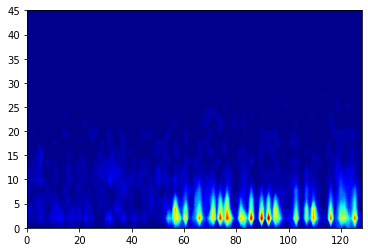

Predicted: 


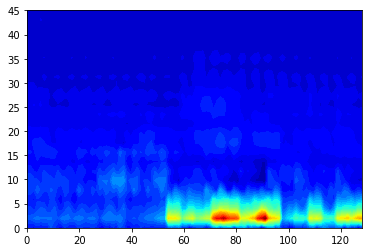

epoch [252/500], train loss:0.4558
epoch [252/500], val loss:1.6090
epoch [252/500], train accuracy:0.8103
epoch [252/500], val accuracy:0.7206


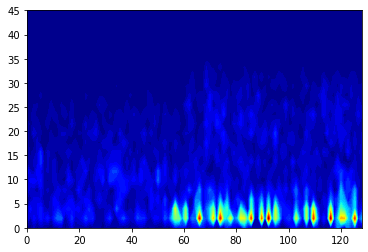

Predicted: 


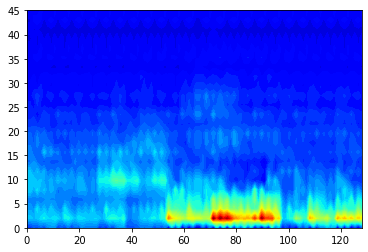

epoch [253/500], train loss:0.4543
epoch [253/500], val loss:1.6098
epoch [253/500], train accuracy:0.8276
epoch [253/500], val accuracy:0.6765


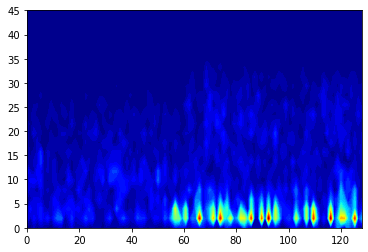

Predicted: 


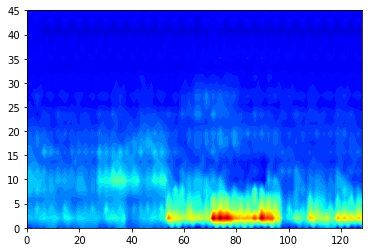

epoch [254/500], train loss:0.4549
epoch [254/500], val loss:1.6089
epoch [254/500], train accuracy:0.8190
epoch [254/500], val accuracy:0.7206


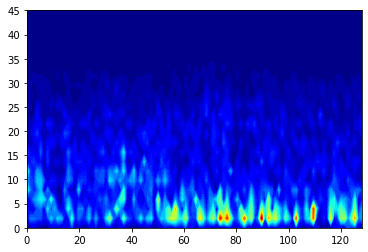

Predicted: 


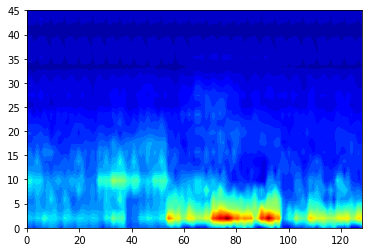

epoch [255/500], train loss:0.4496
epoch [255/500], val loss:1.6086
epoch [255/500], train accuracy:0.8233
epoch [255/500], val accuracy:0.7206


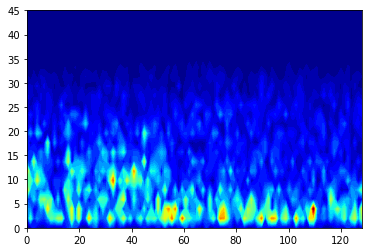

Predicted: 


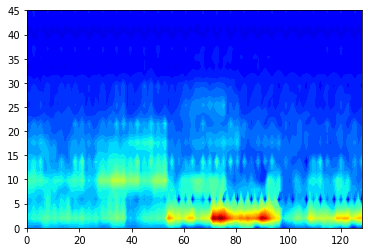

epoch [256/500], train loss:0.4509
epoch [256/500], val loss:1.6085
epoch [256/500], train accuracy:0.8276
epoch [256/500], val accuracy:0.7206


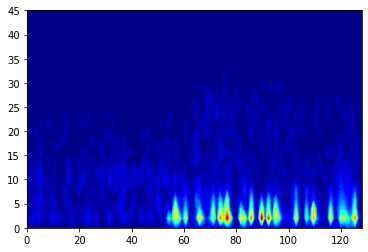

Predicted: 


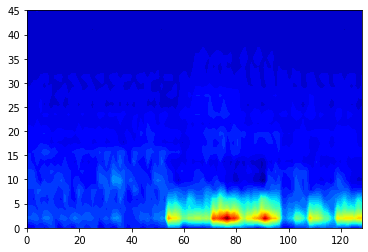

epoch [257/500], train loss:0.4531
epoch [257/500], val loss:1.6082
epoch [257/500], train accuracy:0.8190
epoch [257/500], val accuracy:0.7206


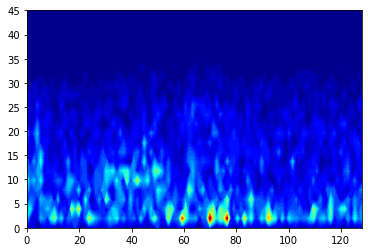

Predicted: 


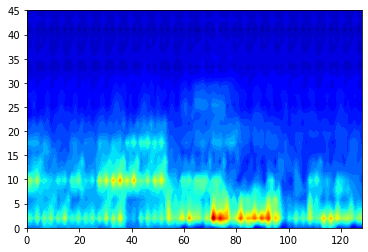

epoch [258/500], train loss:0.4534
epoch [258/500], val loss:1.6080
epoch [258/500], train accuracy:0.8276
epoch [258/500], val accuracy:0.7206


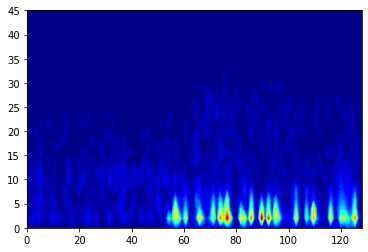

Predicted: 


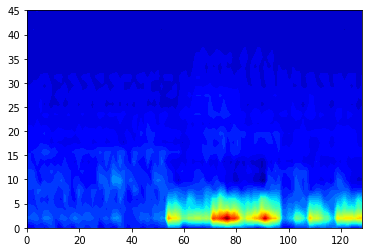

epoch [259/500], train loss:0.4528
epoch [259/500], val loss:1.6076
epoch [259/500], train accuracy:0.8276
epoch [259/500], val accuracy:0.7206


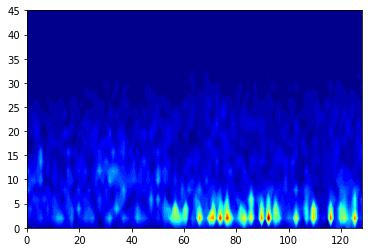

Predicted: 


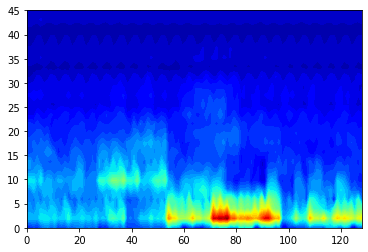

epoch [260/500], train loss:0.4547
epoch [260/500], val loss:1.6071
epoch [260/500], train accuracy:0.8233
epoch [260/500], val accuracy:0.7059


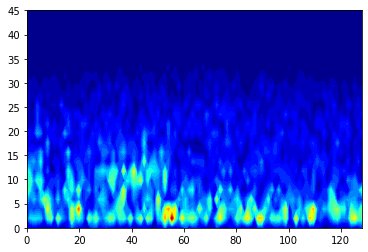

Predicted: 


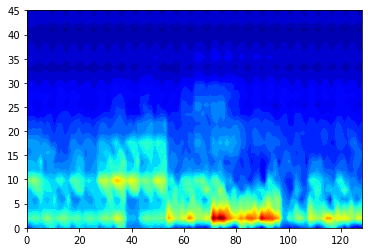

epoch [261/500], train loss:0.4486
epoch [261/500], val loss:1.6073
epoch [261/500], train accuracy:0.8448
epoch [261/500], val accuracy:0.7206


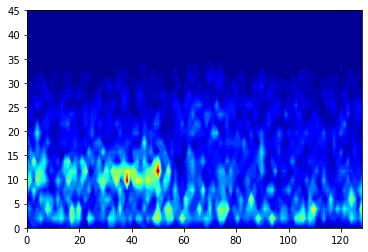

Predicted: 


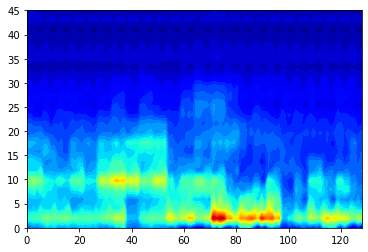

epoch [262/500], train loss:0.4486
epoch [262/500], val loss:1.6071
epoch [262/500], train accuracy:0.8060
epoch [262/500], val accuracy:0.7206


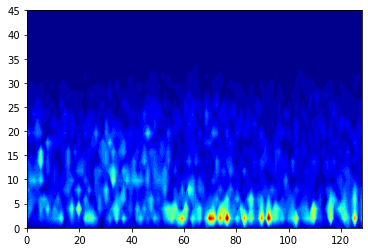

Predicted: 


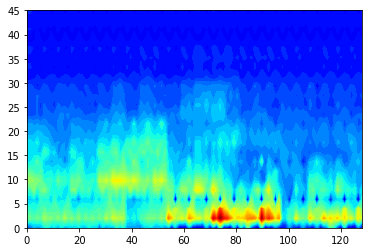

epoch [263/500], train loss:0.4488
epoch [263/500], val loss:1.6072
epoch [263/500], train accuracy:0.8190
epoch [263/500], val accuracy:0.7059


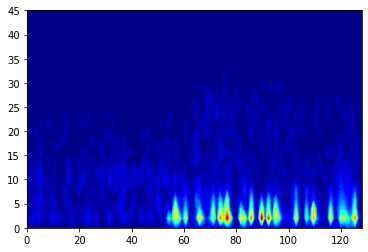

Predicted: 


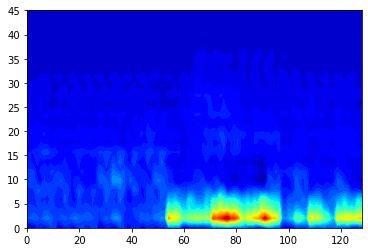

epoch [264/500], train loss:0.4517
epoch [264/500], val loss:1.6076
epoch [264/500], train accuracy:0.8190
epoch [264/500], val accuracy:0.7059


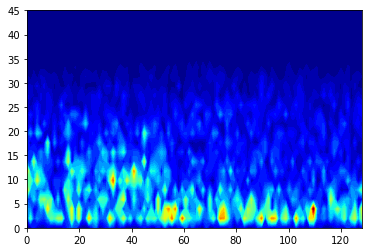

Predicted: 


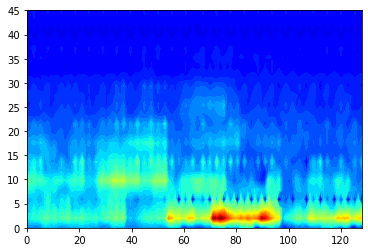

epoch [265/500], train loss:0.4498
epoch [265/500], val loss:1.6078
epoch [265/500], train accuracy:0.8147
epoch [265/500], val accuracy:0.6618


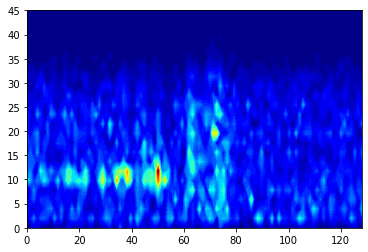

Predicted: 


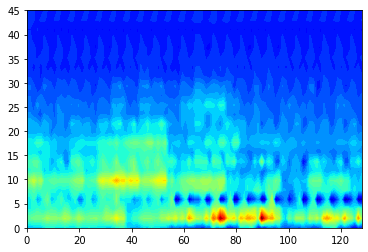

epoch [266/500], train loss:0.4470
epoch [266/500], val loss:1.6076
epoch [266/500], train accuracy:0.8233
epoch [266/500], val accuracy:0.6912


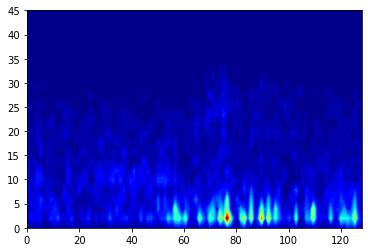

Predicted: 


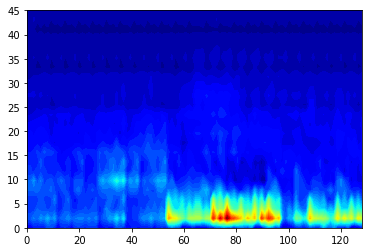

epoch [267/500], train loss:0.4510
epoch [267/500], val loss:1.6071
epoch [267/500], train accuracy:0.8103
epoch [267/500], val accuracy:0.7059


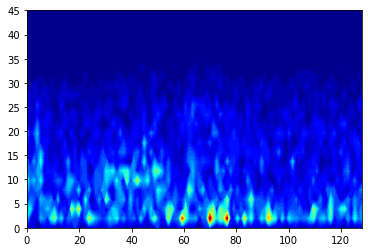

Predicted: 


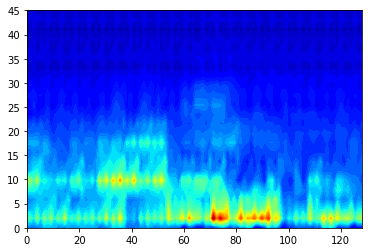

epoch [268/500], train loss:0.4492
epoch [268/500], val loss:1.6062
epoch [268/500], train accuracy:0.8233
epoch [268/500], val accuracy:0.7059


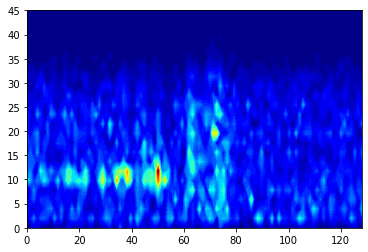

Predicted: 


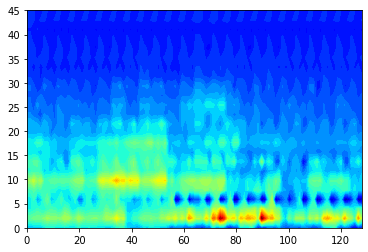

epoch [269/500], train loss:0.4542
epoch [269/500], val loss:1.6061
epoch [269/500], train accuracy:0.8319
epoch [269/500], val accuracy:0.7059


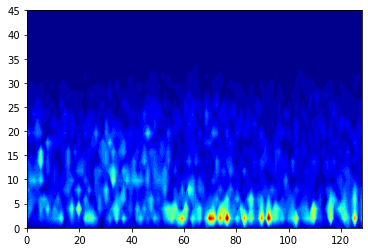

Predicted: 


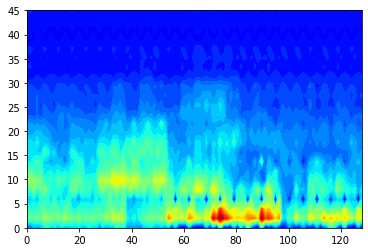

epoch [270/500], train loss:0.4530
epoch [270/500], val loss:1.6073
epoch [270/500], train accuracy:0.8362
epoch [270/500], val accuracy:0.7059


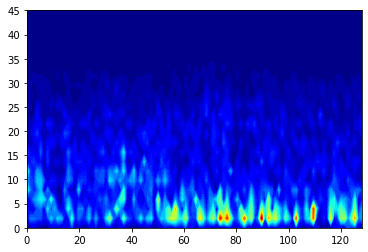

Predicted: 


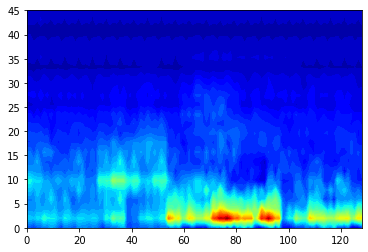

epoch [271/500], train loss:0.4480
epoch [271/500], val loss:1.6054
epoch [271/500], train accuracy:0.8362
epoch [271/500], val accuracy:0.7206


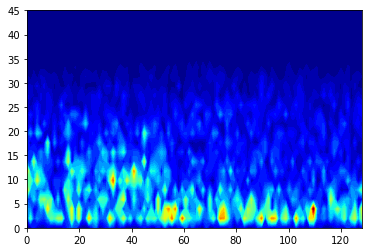

Predicted: 


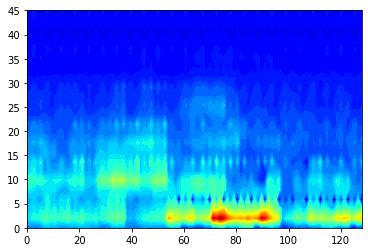

epoch [272/500], train loss:0.4519
epoch [272/500], val loss:1.6060
epoch [272/500], train accuracy:0.8060
epoch [272/500], val accuracy:0.7059


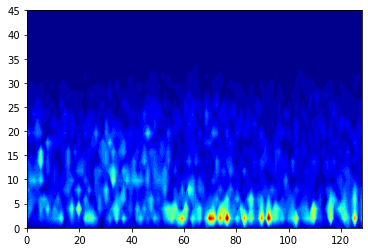

Predicted: 


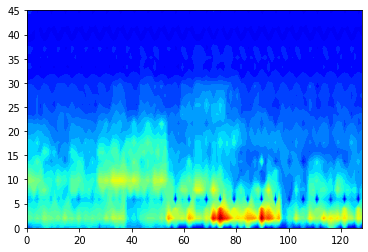

epoch [273/500], train loss:0.4451
epoch [273/500], val loss:1.6058
epoch [273/500], train accuracy:0.8491
epoch [273/500], val accuracy:0.7059


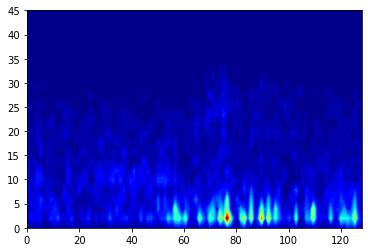

Predicted: 


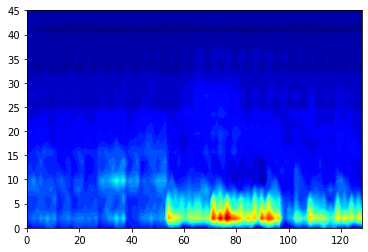

epoch [274/500], train loss:0.4463
epoch [274/500], val loss:1.6060
epoch [274/500], train accuracy:0.8362
epoch [274/500], val accuracy:0.7206


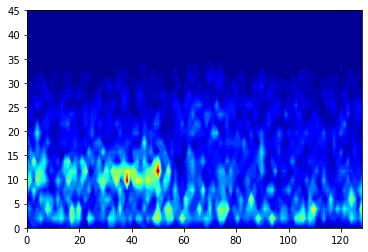

Predicted: 


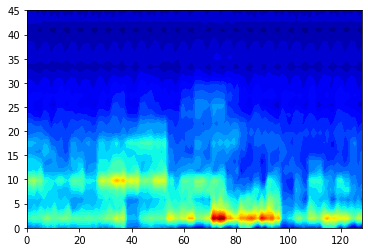

epoch [275/500], train loss:0.4473
epoch [275/500], val loss:1.6052
epoch [275/500], train accuracy:0.8362
epoch [275/500], val accuracy:0.7059


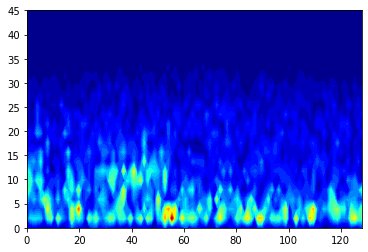

Predicted: 


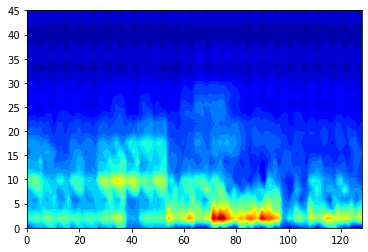

epoch [276/500], train loss:0.4450
epoch [276/500], val loss:1.6053
epoch [276/500], train accuracy:0.8319
epoch [276/500], val accuracy:0.7059


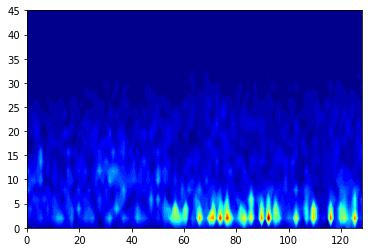

Predicted: 


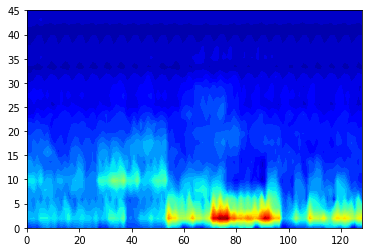

epoch [277/500], train loss:0.4445
epoch [277/500], val loss:1.6063
epoch [277/500], train accuracy:0.8405
epoch [277/500], val accuracy:0.7059


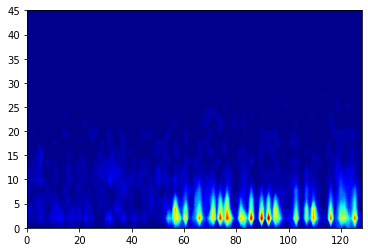

Predicted: 


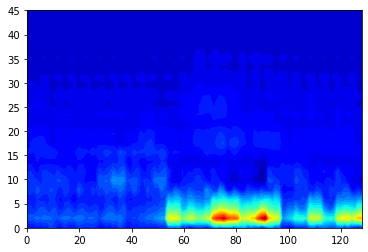

epoch [278/500], train loss:0.4437
epoch [278/500], val loss:1.6047
epoch [278/500], train accuracy:0.8664
epoch [278/500], val accuracy:0.7059


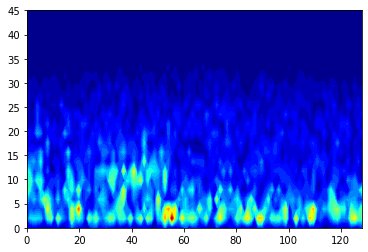

Predicted: 


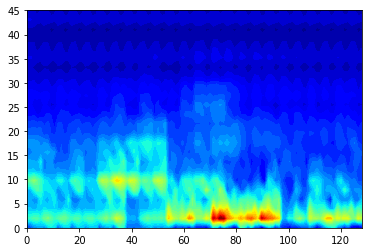

epoch [279/500], train loss:0.4438
epoch [279/500], val loss:1.6048
epoch [279/500], train accuracy:0.8319
epoch [279/500], val accuracy:0.7059


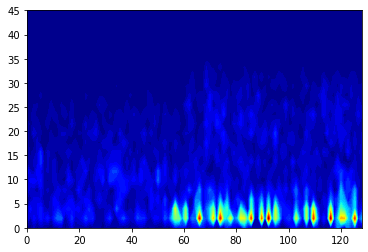

Predicted: 


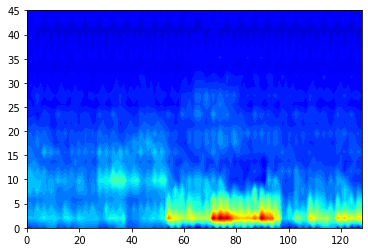

epoch [280/500], train loss:0.4447
epoch [280/500], val loss:1.6038
epoch [280/500], train accuracy:0.8276
epoch [280/500], val accuracy:0.6912


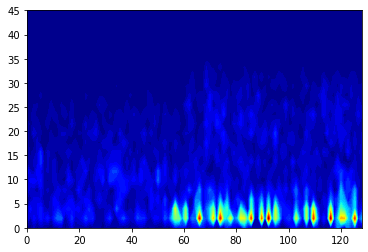

Predicted: 


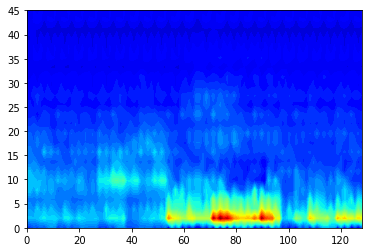

epoch [281/500], train loss:0.4397
epoch [281/500], val loss:1.6043
epoch [281/500], train accuracy:0.8362
epoch [281/500], val accuracy:0.6912


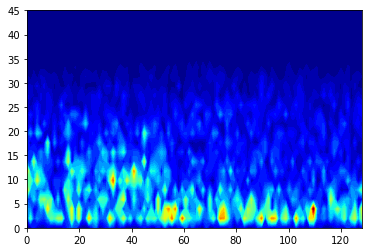

Predicted: 


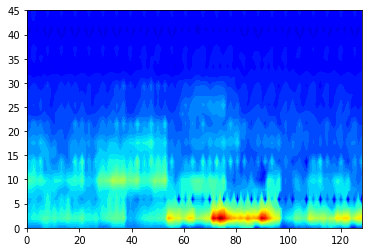

epoch [282/500], train loss:0.4422
epoch [282/500], val loss:1.6047
epoch [282/500], train accuracy:0.8491
epoch [282/500], val accuracy:0.7206


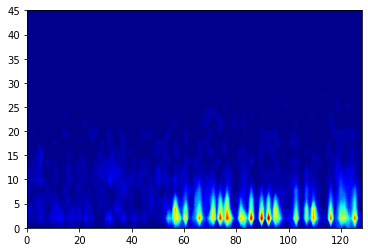

Predicted: 


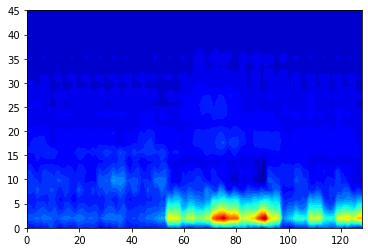

epoch [283/500], train loss:0.4448
epoch [283/500], val loss:1.6046
epoch [283/500], train accuracy:0.8276
epoch [283/500], val accuracy:0.7206


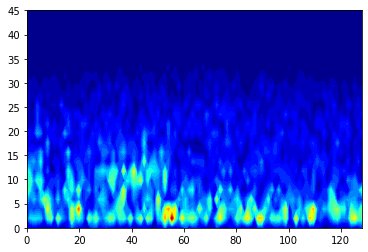

Predicted: 


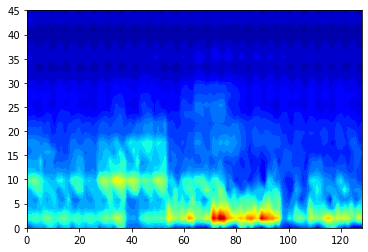

epoch [284/500], train loss:0.4418
epoch [284/500], val loss:1.6032
epoch [284/500], train accuracy:0.8276
epoch [284/500], val accuracy:0.7059


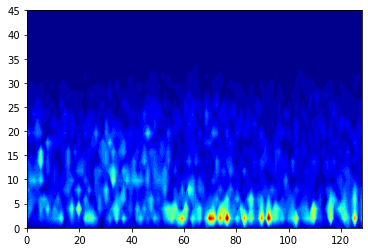

Predicted: 


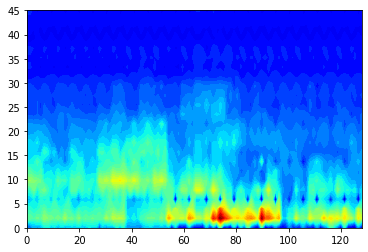

epoch [285/500], train loss:0.4403
epoch [285/500], val loss:1.6038
epoch [285/500], train accuracy:0.8362
epoch [285/500], val accuracy:0.7059


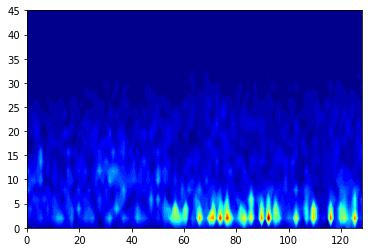

Predicted: 


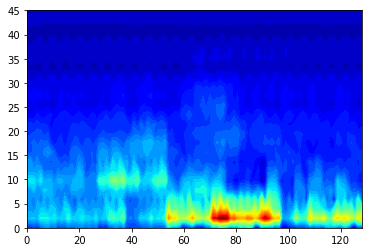

epoch [286/500], train loss:0.4423
epoch [286/500], val loss:1.6031
epoch [286/500], train accuracy:0.8147
epoch [286/500], val accuracy:0.7059


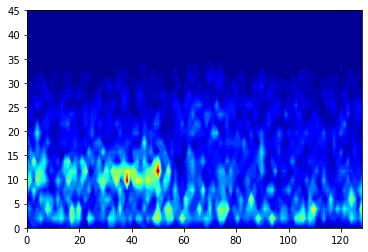

Predicted: 


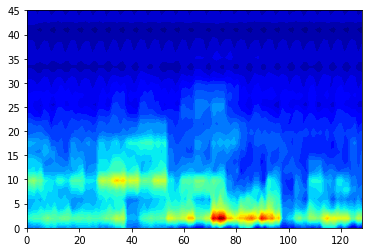

epoch [287/500], train loss:0.4979
epoch [287/500], val loss:1.6038
epoch [287/500], train accuracy:0.8319
epoch [287/500], val accuracy:0.7059


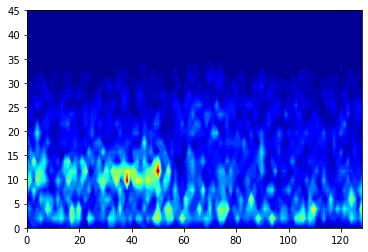

Predicted: 


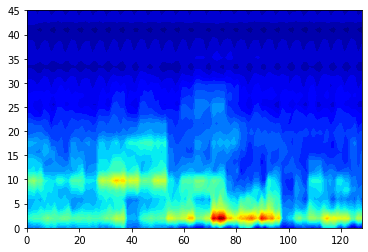

epoch [288/500], train loss:0.4410
epoch [288/500], val loss:1.6029
epoch [288/500], train accuracy:0.8448
epoch [288/500], val accuracy:0.6912


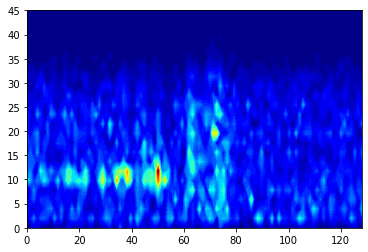

Predicted: 


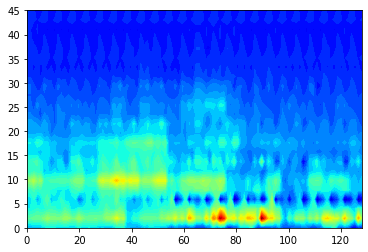

epoch [289/500], train loss:0.4421
epoch [289/500], val loss:1.6027
epoch [289/500], train accuracy:0.8621
epoch [289/500], val accuracy:0.7059


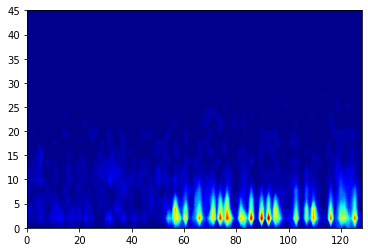

Predicted: 


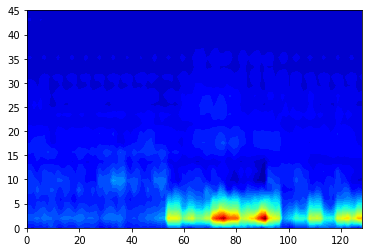

epoch [290/500], train loss:0.4419
epoch [290/500], val loss:1.6025
epoch [290/500], train accuracy:0.8448
epoch [290/500], val accuracy:0.7059


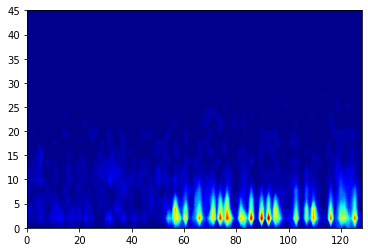

Predicted: 


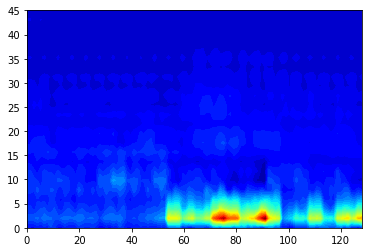

epoch [291/500], train loss:0.4403
epoch [291/500], val loss:1.6018
epoch [291/500], train accuracy:0.8405
epoch [291/500], val accuracy:0.7059


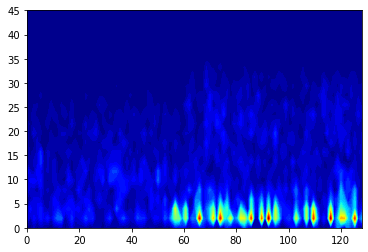

Predicted: 


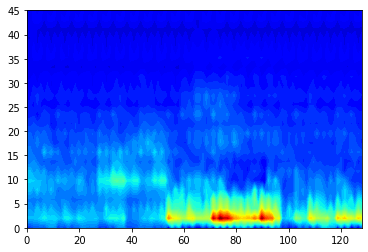

epoch [292/500], train loss:0.4450
epoch [292/500], val loss:1.6024
epoch [292/500], train accuracy:0.8448
epoch [292/500], val accuracy:0.7059


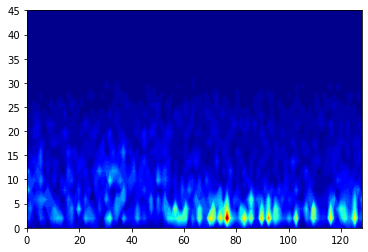

Predicted: 


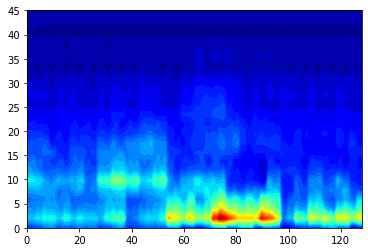

epoch [293/500], train loss:0.4399
epoch [293/500], val loss:1.6023
epoch [293/500], train accuracy:0.8448
epoch [293/500], val accuracy:0.7059


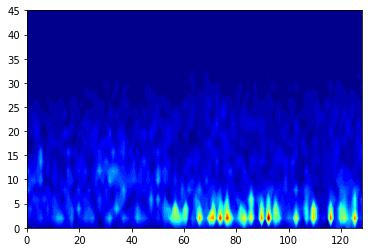

Predicted: 


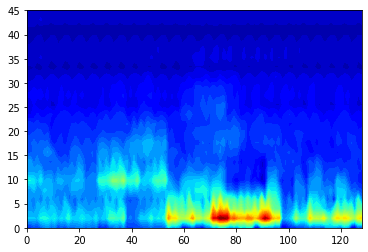

epoch [294/500], train loss:0.4420
epoch [294/500], val loss:1.6015
epoch [294/500], train accuracy:0.8448
epoch [294/500], val accuracy:0.6912


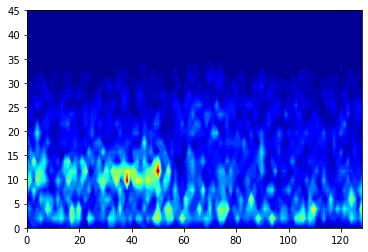

Predicted: 


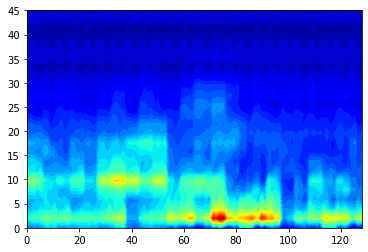

epoch [295/500], train loss:0.4396
epoch [295/500], val loss:1.6014
epoch [295/500], train accuracy:0.8405
epoch [295/500], val accuracy:0.6912


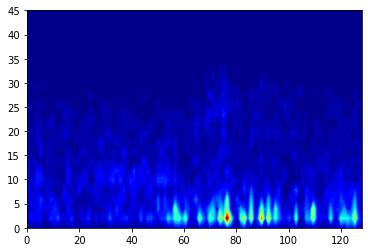

Predicted: 


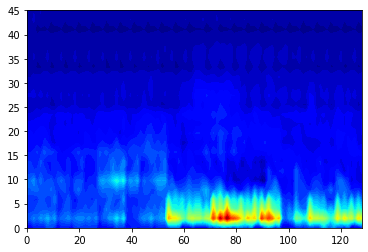

epoch [296/500], train loss:0.4367
epoch [296/500], val loss:1.6016
epoch [296/500], train accuracy:0.8276
epoch [296/500], val accuracy:0.6912


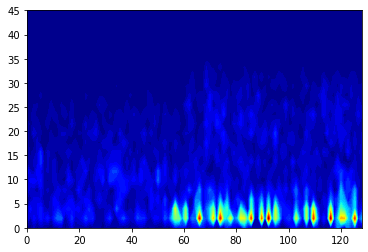

Predicted: 


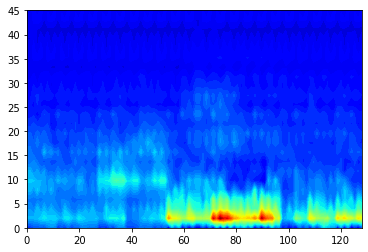

epoch [297/500], train loss:0.4373
epoch [297/500], val loss:1.6017
epoch [297/500], train accuracy:0.8491
epoch [297/500], val accuracy:0.7059


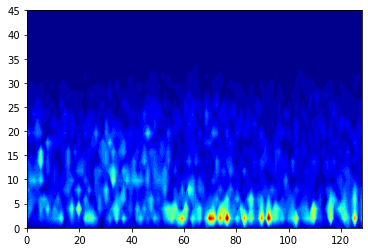

Predicted: 


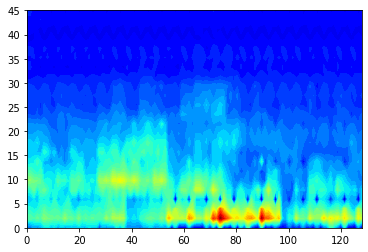

epoch [298/500], train loss:0.4402
epoch [298/500], val loss:1.6012
epoch [298/500], train accuracy:0.8491
epoch [298/500], val accuracy:0.7059


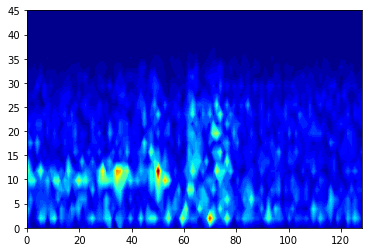

Predicted: 


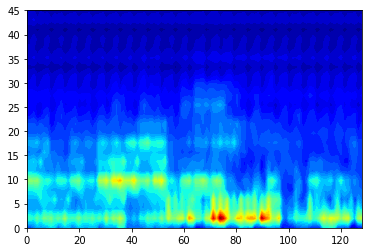

epoch [299/500], train loss:0.4418
epoch [299/500], val loss:1.6003
epoch [299/500], train accuracy:0.8362
epoch [299/500], val accuracy:0.7059


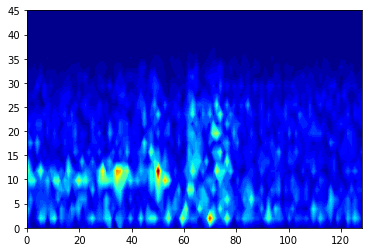

Predicted: 


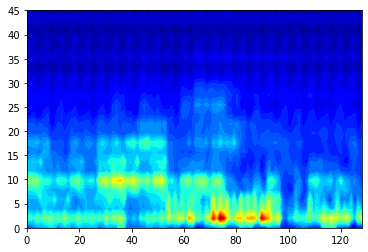

epoch [300/500], train loss:0.4347
epoch [300/500], val loss:1.6011
epoch [300/500], train accuracy:0.8491
epoch [300/500], val accuracy:0.7059


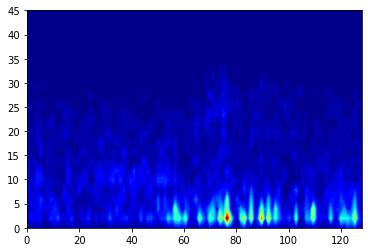

Predicted: 


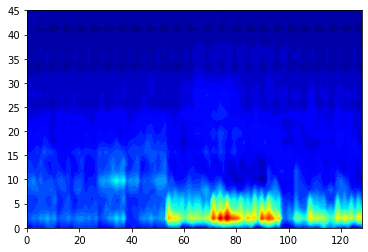

epoch [301/500], train loss:0.4369
epoch [301/500], val loss:1.6004
epoch [301/500], train accuracy:0.8319
epoch [301/500], val accuracy:0.6912


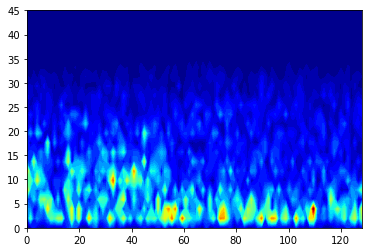

Predicted: 


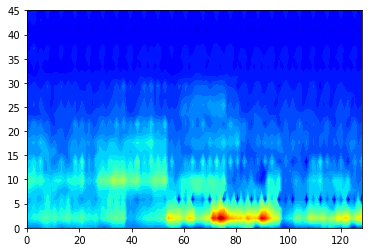

epoch [302/500], train loss:0.4391
epoch [302/500], val loss:1.6006
epoch [302/500], train accuracy:0.8319
epoch [302/500], val accuracy:0.7059


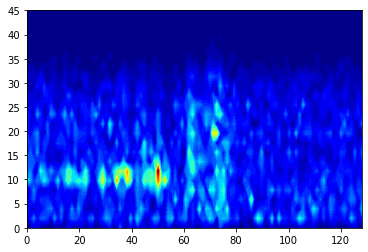

Predicted: 


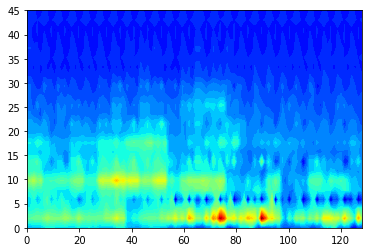

epoch [303/500], train loss:0.4347
epoch [303/500], val loss:1.6002
epoch [303/500], train accuracy:0.8448
epoch [303/500], val accuracy:0.7059


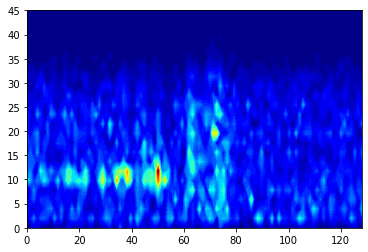

Predicted: 


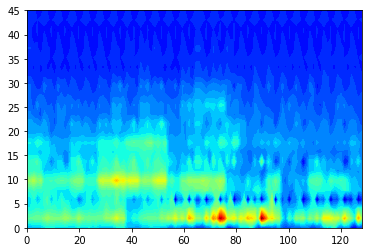

epoch [304/500], train loss:0.4373
epoch [304/500], val loss:1.6003
epoch [304/500], train accuracy:0.8534
epoch [304/500], val accuracy:0.7059


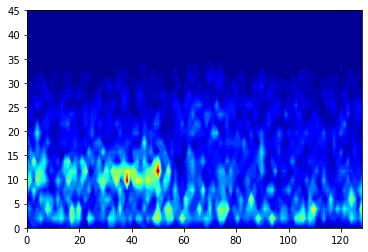

Predicted: 


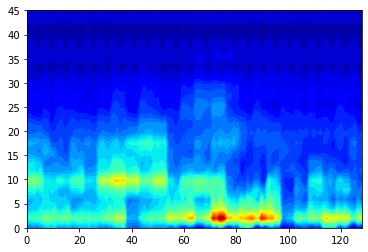

epoch [305/500], train loss:0.4400
epoch [305/500], val loss:1.6006
epoch [305/500], train accuracy:0.8233
epoch [305/500], val accuracy:0.6912


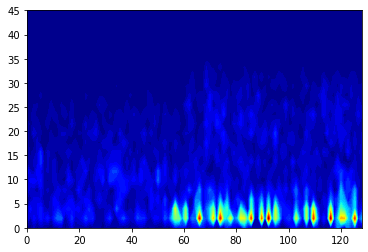

Predicted: 


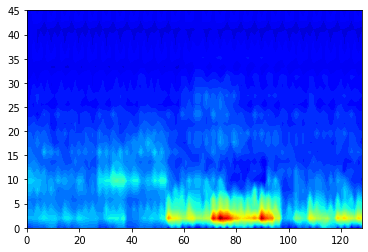

epoch [306/500], train loss:0.4344
epoch [306/500], val loss:1.6001
epoch [306/500], train accuracy:0.8664
epoch [306/500], val accuracy:0.7059


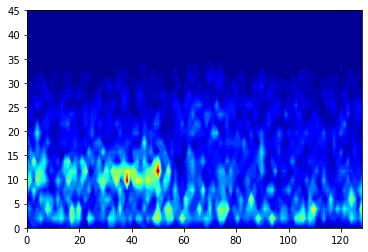

Predicted: 


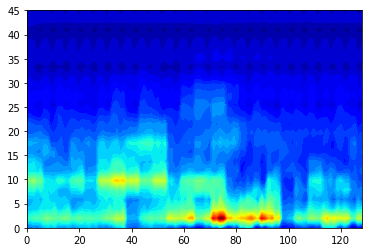

epoch [307/500], train loss:0.4390
epoch [307/500], val loss:1.5988
epoch [307/500], train accuracy:0.8621
epoch [307/500], val accuracy:0.7059


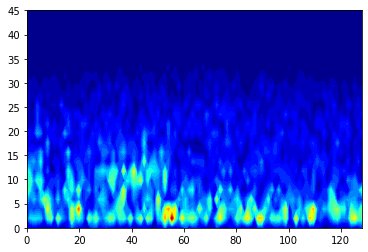

Predicted: 


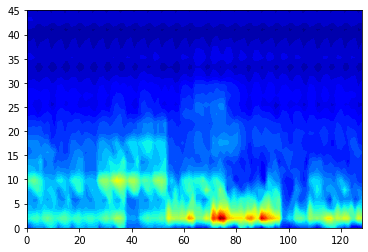

epoch [308/500], train loss:0.4339
epoch [308/500], val loss:1.5987
epoch [308/500], train accuracy:0.8276
epoch [308/500], val accuracy:0.6912


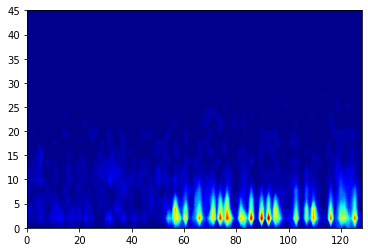

Predicted: 


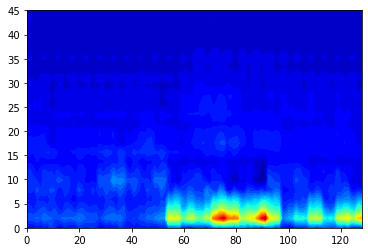

epoch [309/500], train loss:0.4380
epoch [309/500], val loss:1.5994
epoch [309/500], train accuracy:0.8276
epoch [309/500], val accuracy:0.7059


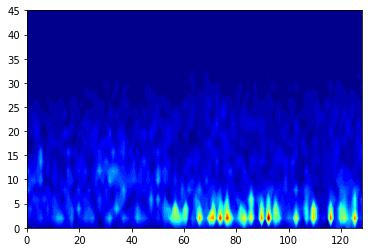

Predicted: 


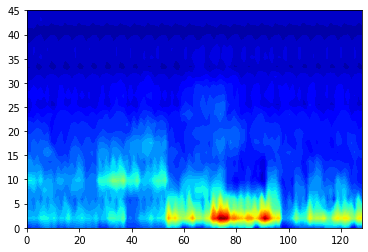

epoch [310/500], train loss:0.4350
epoch [310/500], val loss:1.5981
epoch [310/500], train accuracy:0.8448
epoch [310/500], val accuracy:0.7059


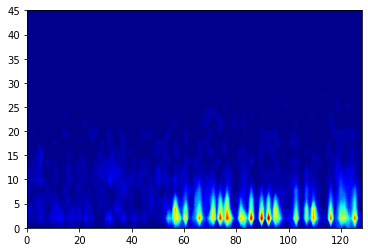

Predicted: 


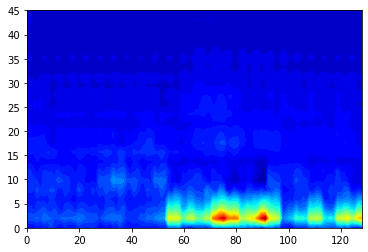

epoch [311/500], train loss:0.4332
epoch [311/500], val loss:1.5981
epoch [311/500], train accuracy:0.8491
epoch [311/500], val accuracy:0.6912


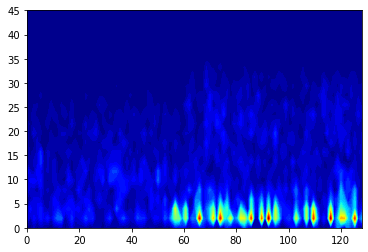

Predicted: 


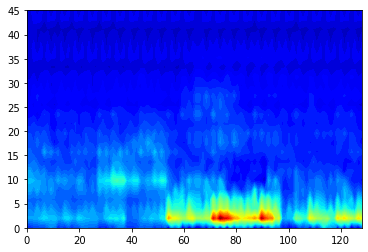

epoch [312/500], train loss:0.4318
epoch [312/500], val loss:1.5989
epoch [312/500], train accuracy:0.8621
epoch [312/500], val accuracy:0.7059


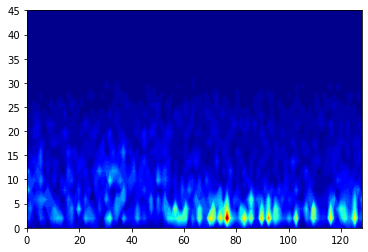

Predicted: 


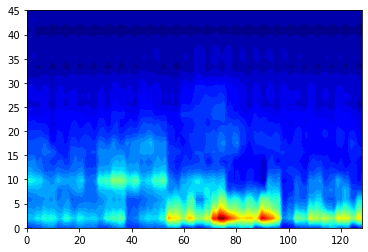

epoch [313/500], train loss:0.4404
epoch [313/500], val loss:1.5976
epoch [313/500], train accuracy:0.8319
epoch [313/500], val accuracy:0.7059


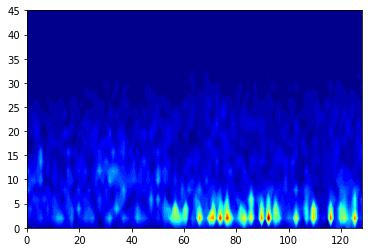

Predicted: 


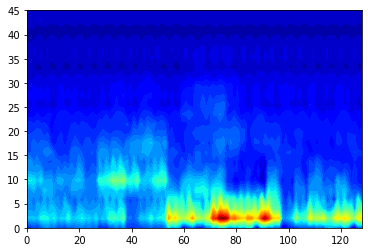

epoch [314/500], train loss:0.4330
epoch [314/500], val loss:1.5990
epoch [314/500], train accuracy:0.8621
epoch [314/500], val accuracy:0.7059


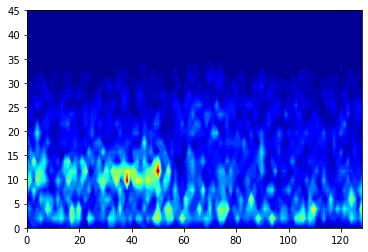

Predicted: 


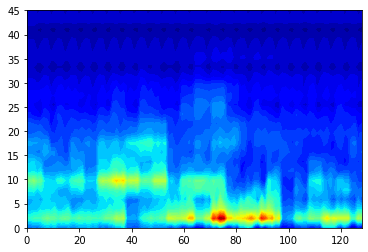

epoch [315/500], train loss:0.4329
epoch [315/500], val loss:1.5982
epoch [315/500], train accuracy:0.8362
epoch [315/500], val accuracy:0.7059


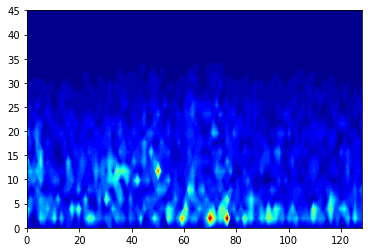

Predicted: 


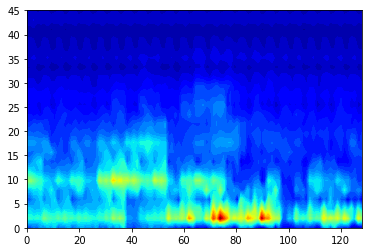

epoch [316/500], train loss:0.4321
epoch [316/500], val loss:1.5978
epoch [316/500], train accuracy:0.8405
epoch [316/500], val accuracy:0.7059


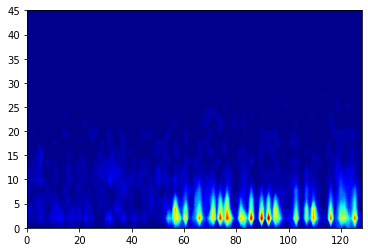

Predicted: 


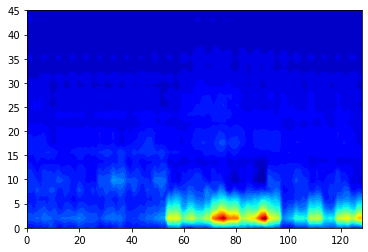

epoch [317/500], train loss:0.4346
epoch [317/500], val loss:1.5990
epoch [317/500], train accuracy:0.8448
epoch [317/500], val accuracy:0.6765


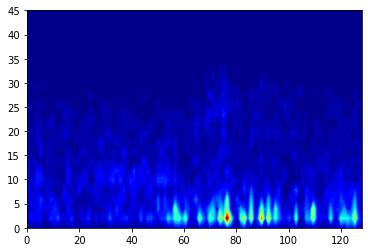

Predicted: 


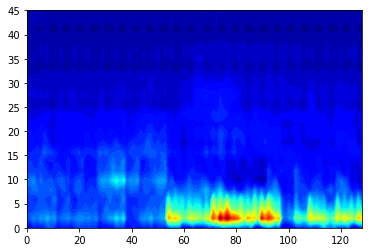

epoch [318/500], train loss:0.4314
epoch [318/500], val loss:1.5981
epoch [318/500], train accuracy:0.8448
epoch [318/500], val accuracy:0.7059


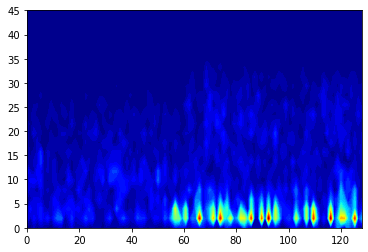

Predicted: 


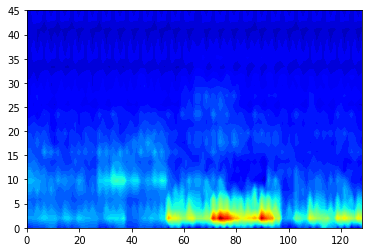

epoch [319/500], train loss:0.4304
epoch [319/500], val loss:1.5974
epoch [319/500], train accuracy:0.8405
epoch [319/500], val accuracy:0.7059


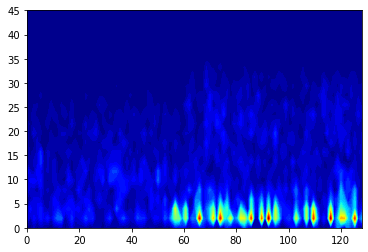

Predicted: 


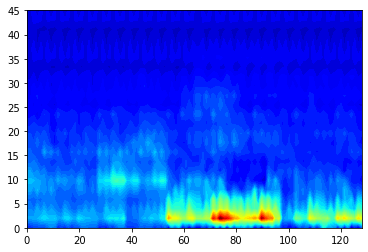

epoch [320/500], train loss:0.4498
epoch [320/500], val loss:1.5973
epoch [320/500], train accuracy:0.8534
epoch [320/500], val accuracy:0.7059


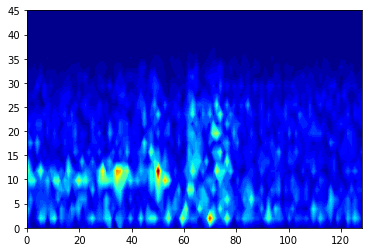

Predicted: 


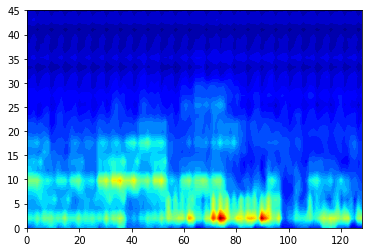

epoch [321/500], train loss:0.4317
epoch [321/500], val loss:1.5978
epoch [321/500], train accuracy:0.8578
epoch [321/500], val accuracy:0.7059


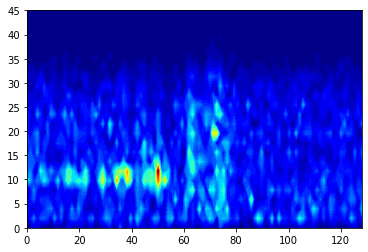

Predicted: 


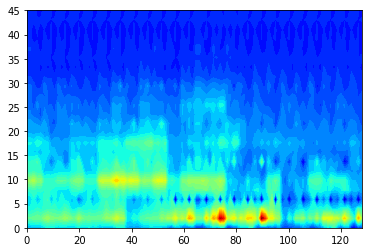

epoch [322/500], train loss:0.4298
epoch [322/500], val loss:1.5967
epoch [322/500], train accuracy:0.8534
epoch [322/500], val accuracy:0.7059


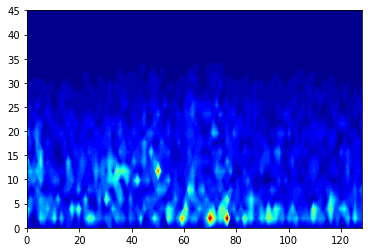

Predicted: 


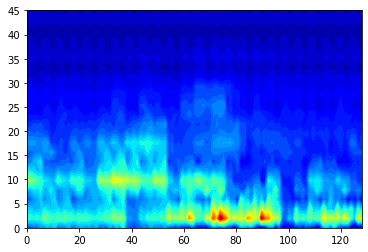

epoch [323/500], train loss:0.4296
epoch [323/500], val loss:1.5971
epoch [323/500], train accuracy:0.8664
epoch [323/500], val accuracy:0.7059


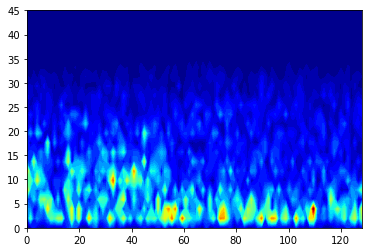

Predicted: 


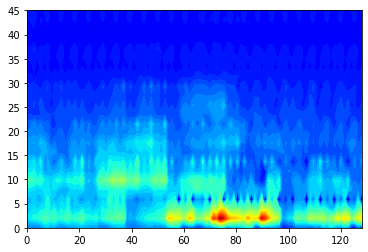

epoch [324/500], train loss:0.4290
epoch [324/500], val loss:1.5976
epoch [324/500], train accuracy:0.8621
epoch [324/500], val accuracy:0.6912


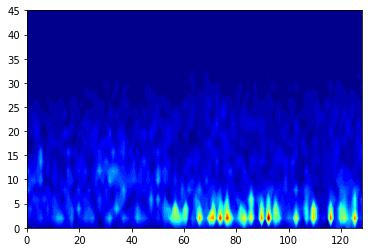

Predicted: 


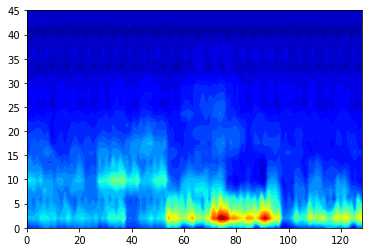

epoch [325/500], train loss:0.4299
epoch [325/500], val loss:1.5967
epoch [325/500], train accuracy:0.8664
epoch [325/500], val accuracy:0.7059


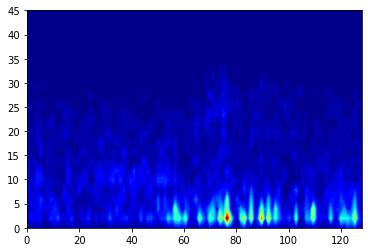

Predicted: 


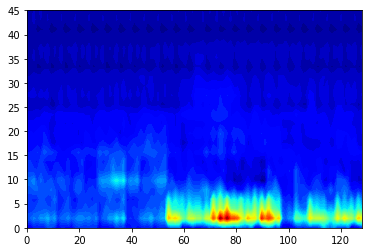

epoch [326/500], train loss:0.4289
epoch [326/500], val loss:1.5966
epoch [326/500], train accuracy:0.8448
epoch [326/500], val accuracy:0.7059


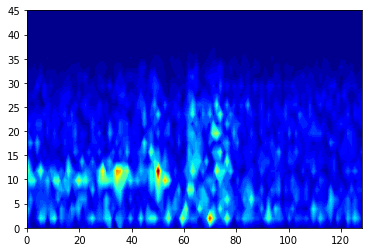

Predicted: 


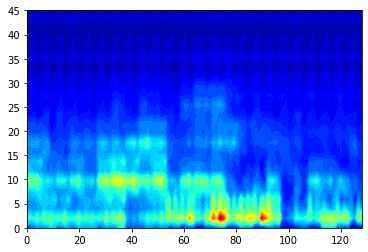

epoch [327/500], train loss:0.4298
epoch [327/500], val loss:1.5957
epoch [327/500], train accuracy:0.8491
epoch [327/500], val accuracy:0.6912


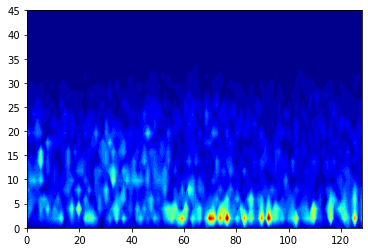

Predicted: 


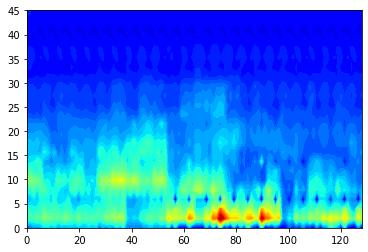

epoch [328/500], train loss:0.4287
epoch [328/500], val loss:1.5959
epoch [328/500], train accuracy:0.8578
epoch [328/500], val accuracy:0.7059


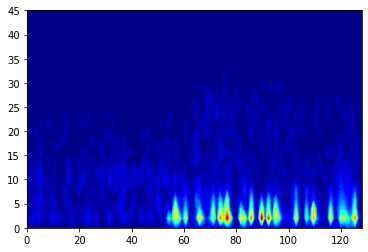

Predicted: 


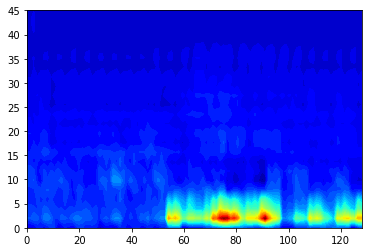

epoch [329/500], train loss:0.4291
epoch [329/500], val loss:1.5964
epoch [329/500], train accuracy:0.8534
epoch [329/500], val accuracy:0.7059


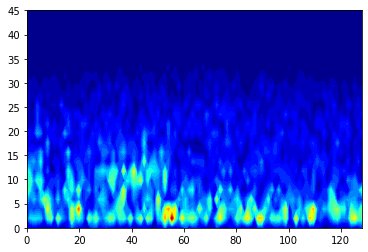

Predicted: 


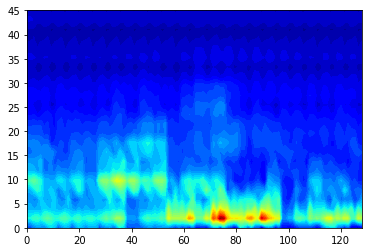

epoch [330/500], train loss:0.4286
epoch [330/500], val loss:1.5962
epoch [330/500], train accuracy:0.8664
epoch [330/500], val accuracy:0.7059


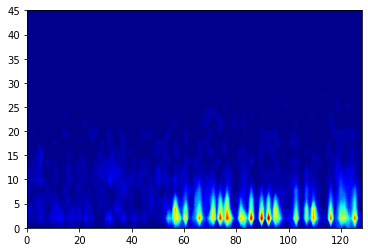

Predicted: 


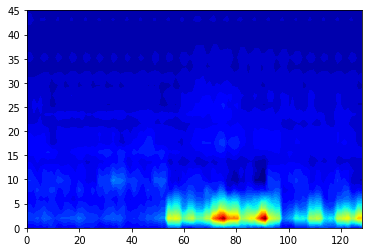

epoch [331/500], train loss:0.4283
epoch [331/500], val loss:1.5959
epoch [331/500], train accuracy:0.8362
epoch [331/500], val accuracy:0.7059


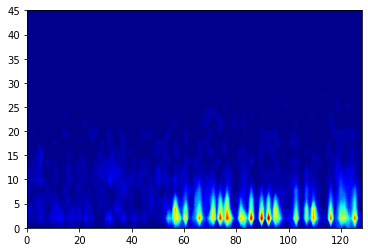

Predicted: 


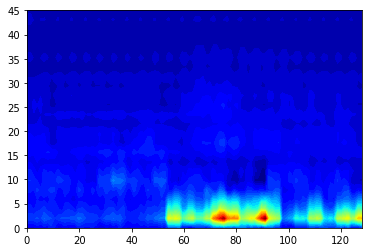

epoch [332/500], train loss:0.4262
epoch [332/500], val loss:1.5955
epoch [332/500], train accuracy:0.8750
epoch [332/500], val accuracy:0.7059


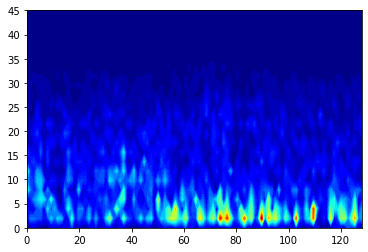

Predicted: 


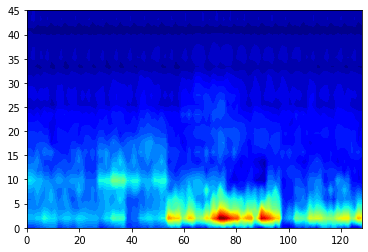

epoch [333/500], train loss:0.4263
epoch [333/500], val loss:1.5960
epoch [333/500], train accuracy:0.8750
epoch [333/500], val accuracy:0.6912


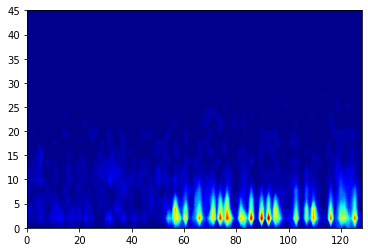

Predicted: 


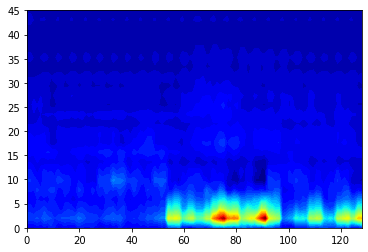

epoch [334/500], train loss:0.4325
epoch [334/500], val loss:1.5952
epoch [334/500], train accuracy:0.8664
epoch [334/500], val accuracy:0.7059


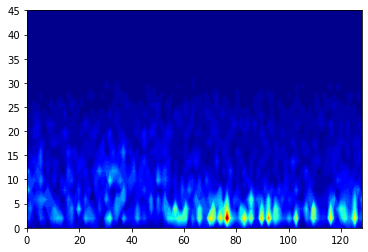

Predicted: 


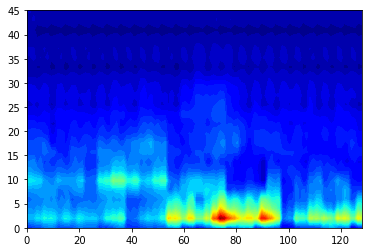

epoch [335/500], train loss:0.4275
epoch [335/500], val loss:1.5949
epoch [335/500], train accuracy:0.8448
epoch [335/500], val accuracy:0.7059


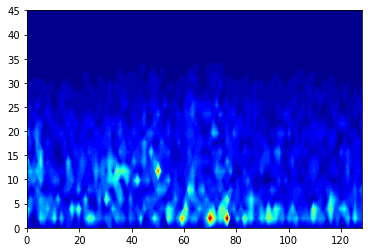

Predicted: 


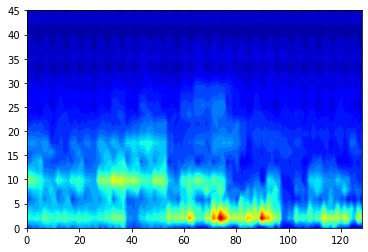

epoch [336/500], train loss:0.4391
epoch [336/500], val loss:1.5958
epoch [336/500], train accuracy:0.8578
epoch [336/500], val accuracy:0.6765


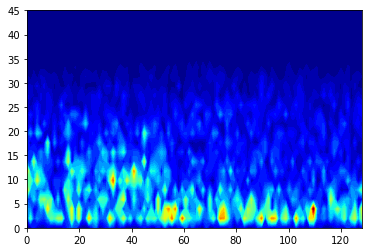

Predicted: 


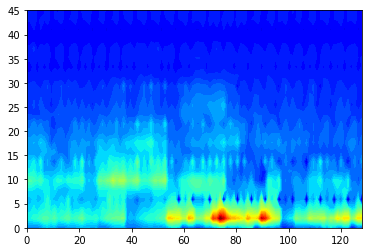

epoch [337/500], train loss:0.4284
epoch [337/500], val loss:1.5943
epoch [337/500], train accuracy:0.8491
epoch [337/500], val accuracy:0.7206


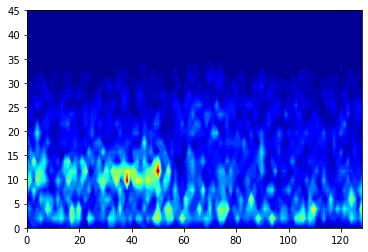

Predicted: 


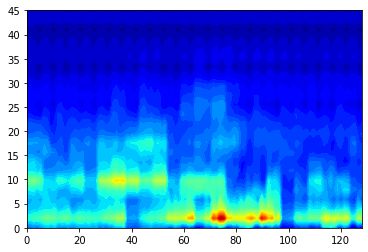

epoch [338/500], train loss:0.4248
epoch [338/500], val loss:1.5946
epoch [338/500], train accuracy:0.8836
epoch [338/500], val accuracy:0.7059


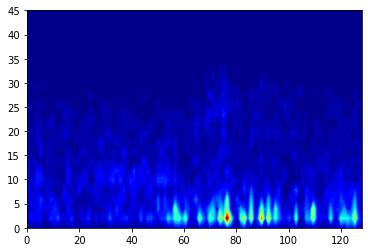

Predicted: 


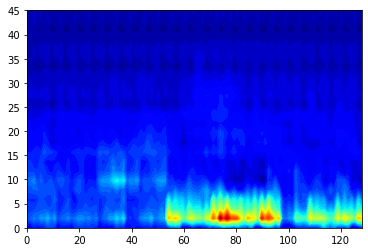

epoch [339/500], train loss:0.4269
epoch [339/500], val loss:1.5943
epoch [339/500], train accuracy:0.8578
epoch [339/500], val accuracy:0.7059


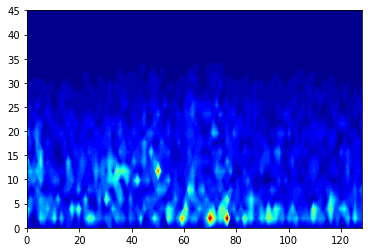

Predicted: 


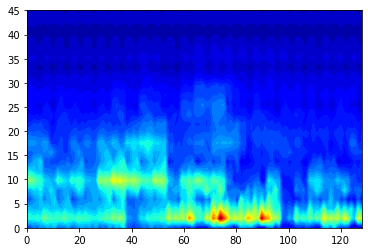

epoch [340/500], train loss:0.4255
epoch [340/500], val loss:1.5942
epoch [340/500], train accuracy:0.8793
epoch [340/500], val accuracy:0.7059


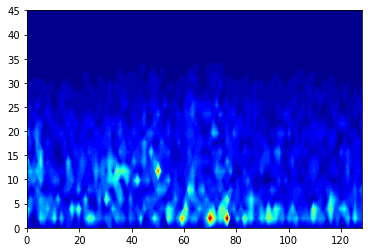

Predicted: 


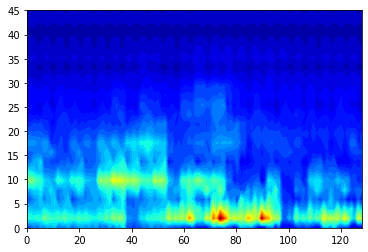

epoch [341/500], train loss:0.4791
epoch [341/500], val loss:1.5942
epoch [341/500], train accuracy:0.8750
epoch [341/500], val accuracy:0.7059


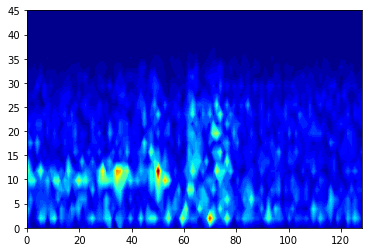

Predicted: 


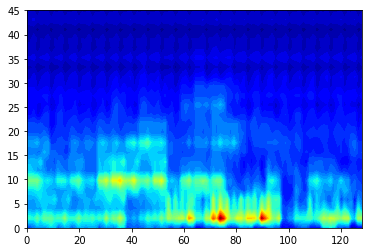

epoch [342/500], train loss:0.4248
epoch [342/500], val loss:1.5944
epoch [342/500], train accuracy:0.8448
epoch [342/500], val accuracy:0.7059


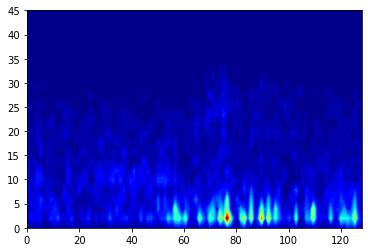

Predicted: 


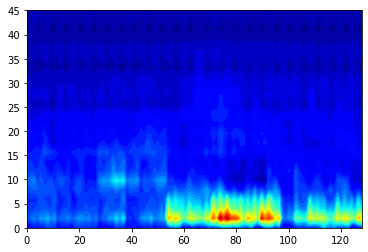

epoch [343/500], train loss:0.4239
epoch [343/500], val loss:1.5937
epoch [343/500], train accuracy:0.8534
epoch [343/500], val accuracy:0.7059


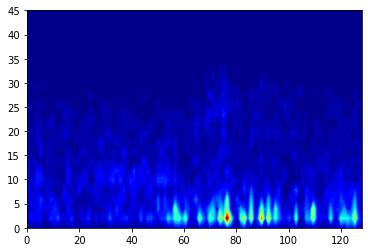

Predicted: 


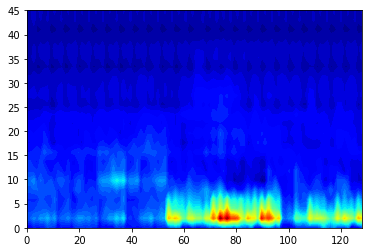

epoch [344/500], train loss:0.4255
epoch [344/500], val loss:1.5942
epoch [344/500], train accuracy:0.8707
epoch [344/500], val accuracy:0.7059


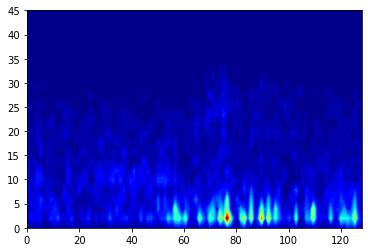

Predicted: 


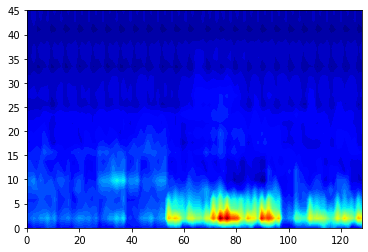

epoch [345/500], train loss:0.4240
epoch [345/500], val loss:1.5939
epoch [345/500], train accuracy:0.8448
epoch [345/500], val accuracy:0.7059


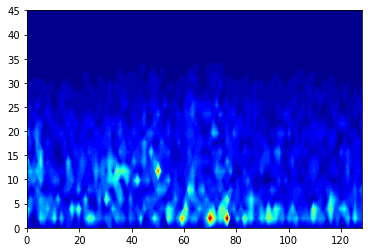

Predicted: 


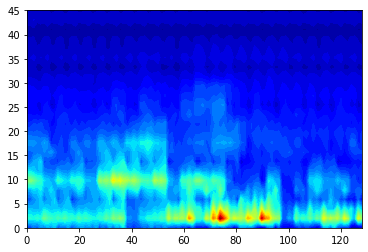

epoch [346/500], train loss:0.4227
epoch [346/500], val loss:1.5942
epoch [346/500], train accuracy:0.8362
epoch [346/500], val accuracy:0.6765


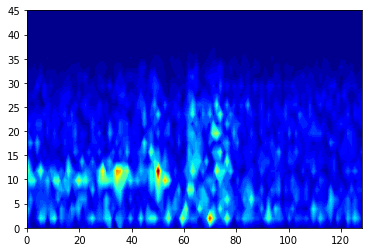

Predicted: 


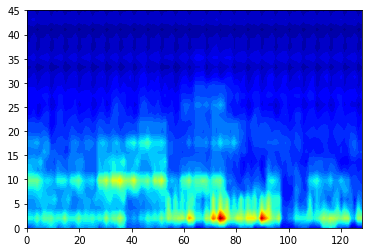

epoch [347/500], train loss:0.4203
epoch [347/500], val loss:1.5940
epoch [347/500], train accuracy:0.8621
epoch [347/500], val accuracy:0.6765


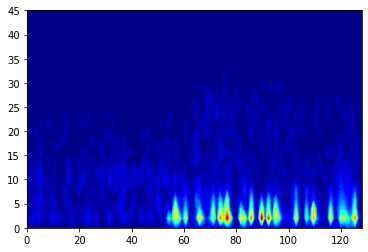

Predicted: 


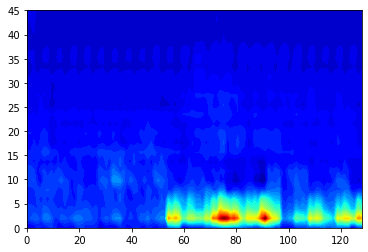

epoch [348/500], train loss:0.4220
epoch [348/500], val loss:1.5944
epoch [348/500], train accuracy:0.8405
epoch [348/500], val accuracy:0.6618


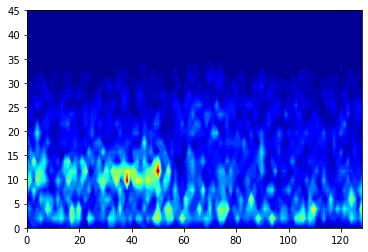

Predicted: 


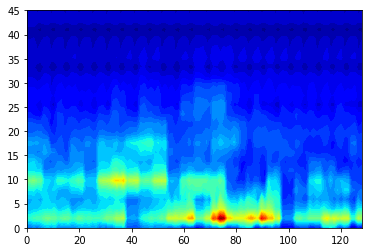

epoch [349/500], train loss:0.4227
epoch [349/500], val loss:1.5931
epoch [349/500], train accuracy:0.8491
epoch [349/500], val accuracy:0.7206


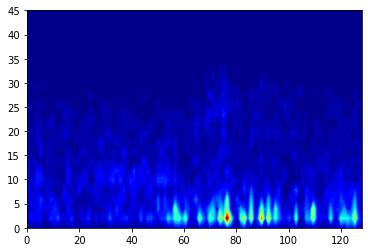

Predicted: 


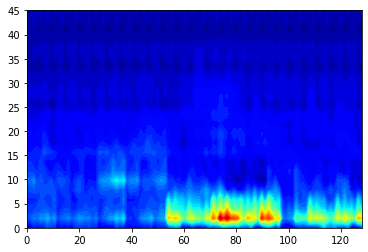

epoch [350/500], train loss:0.4231
epoch [350/500], val loss:1.5929
epoch [350/500], train accuracy:0.8578
epoch [350/500], val accuracy:0.7206


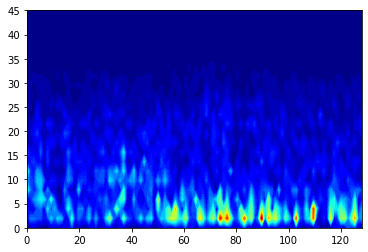

Predicted: 


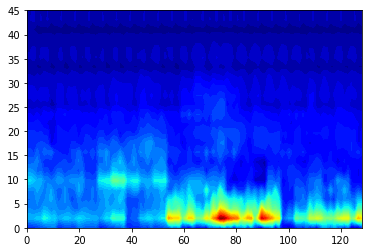

epoch [351/500], train loss:0.4207
epoch [351/500], val loss:1.5934
epoch [351/500], train accuracy:0.8491
epoch [351/500], val accuracy:0.6765


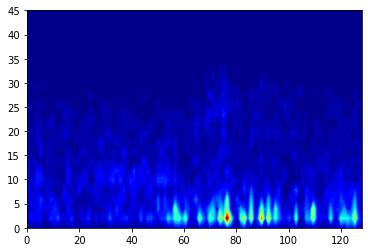

Predicted: 


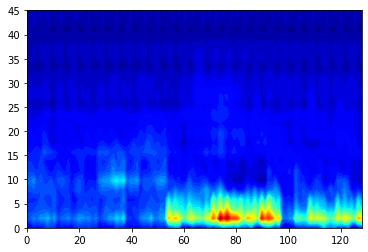

epoch [352/500], train loss:0.4200
epoch [352/500], val loss:1.5927
epoch [352/500], train accuracy:0.8534
epoch [352/500], val accuracy:0.7059


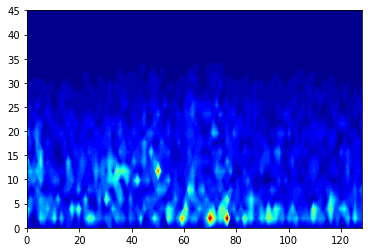

Predicted: 


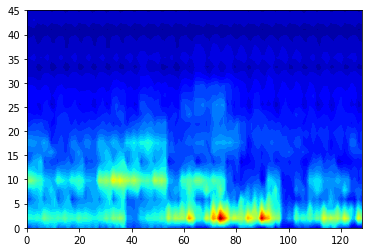

epoch [353/500], train loss:0.4232
epoch [353/500], val loss:1.5921
epoch [353/500], train accuracy:0.8578
epoch [353/500], val accuracy:0.7206


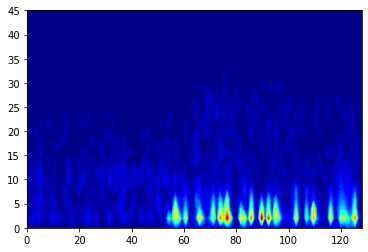

Predicted: 


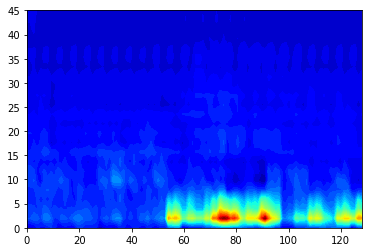

epoch [354/500], train loss:0.4192
epoch [354/500], val loss:1.5932
epoch [354/500], train accuracy:0.8750
epoch [354/500], val accuracy:0.6765


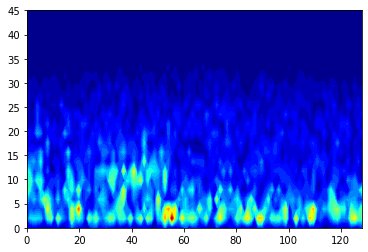

Predicted: 


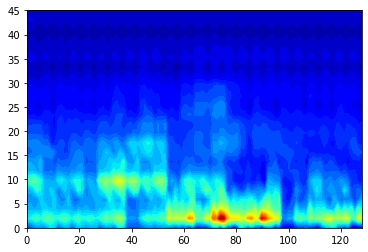

epoch [355/500], train loss:0.4159
epoch [355/500], val loss:1.5927
epoch [355/500], train accuracy:0.8750
epoch [355/500], val accuracy:0.6912


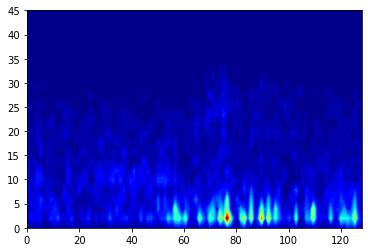

Predicted: 


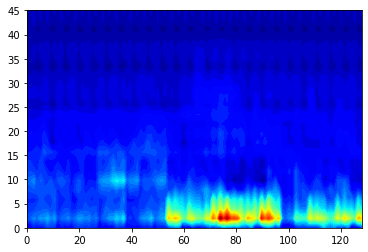

epoch [356/500], train loss:0.4195
epoch [356/500], val loss:1.5924
epoch [356/500], train accuracy:0.8707
epoch [356/500], val accuracy:0.7059


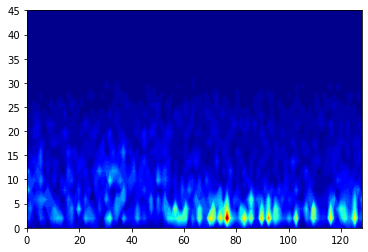

Predicted: 


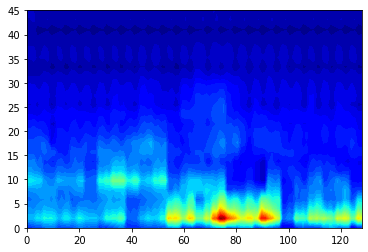

epoch [357/500], train loss:0.4219
epoch [357/500], val loss:1.5925
epoch [357/500], train accuracy:0.8750
epoch [357/500], val accuracy:0.6765


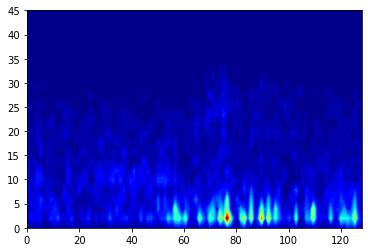

Predicted: 


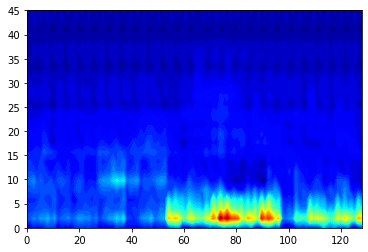

epoch [358/500], train loss:0.4176
epoch [358/500], val loss:1.5917
epoch [358/500], train accuracy:0.8276
epoch [358/500], val accuracy:0.7206


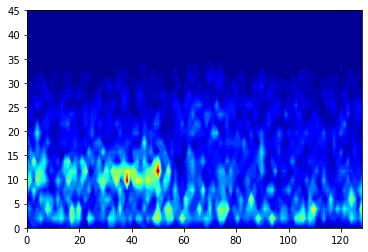

Predicted: 


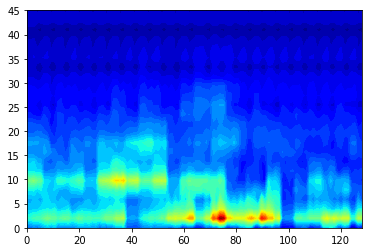

epoch [359/500], train loss:0.4200
epoch [359/500], val loss:1.5914
epoch [359/500], train accuracy:0.8491
epoch [359/500], val accuracy:0.7059


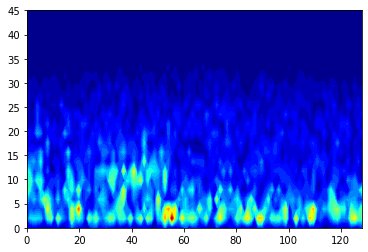

Predicted: 


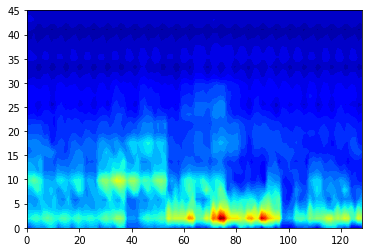

epoch [360/500], train loss:0.4160
epoch [360/500], val loss:1.5922
epoch [360/500], train accuracy:0.8664
epoch [360/500], val accuracy:0.6912


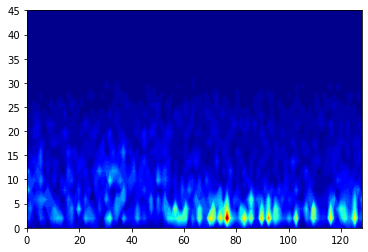

Predicted: 


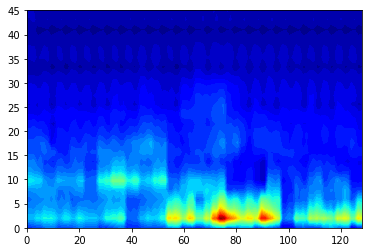

epoch [361/500], train loss:0.4194
epoch [361/500], val loss:1.5921
epoch [361/500], train accuracy:0.8707
epoch [361/500], val accuracy:0.6912


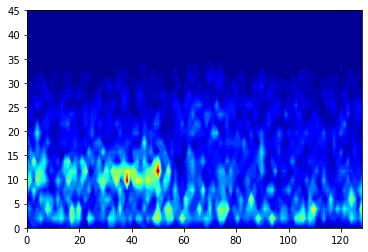

Predicted: 


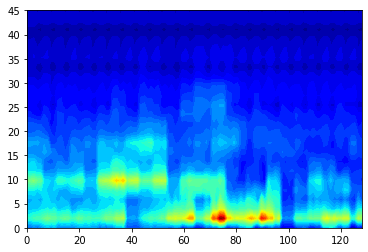

epoch [362/500], train loss:0.4203
epoch [362/500], val loss:1.5918
epoch [362/500], train accuracy:0.8534
epoch [362/500], val accuracy:0.6912


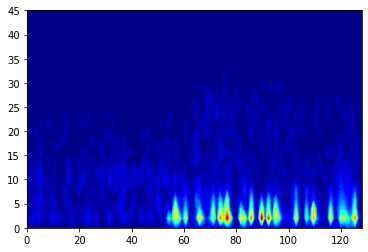

Predicted: 


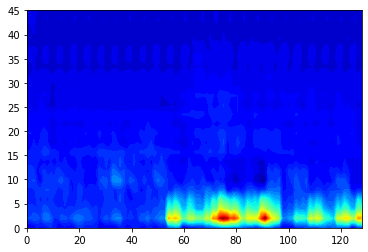

epoch [363/500], train loss:0.4221
epoch [363/500], val loss:1.5917
epoch [363/500], train accuracy:0.8793
epoch [363/500], val accuracy:0.6912


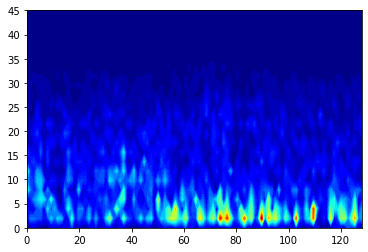

Predicted: 


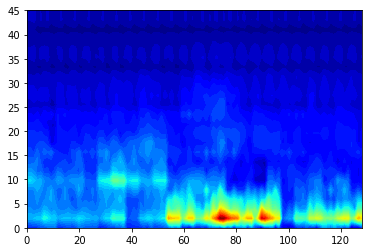

epoch [364/500], train loss:0.4186
epoch [364/500], val loss:1.5923
epoch [364/500], train accuracy:0.8750
epoch [364/500], val accuracy:0.6618


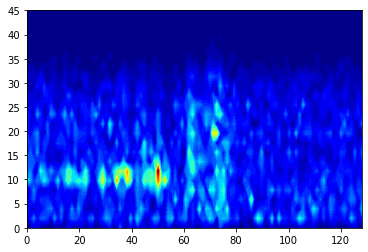

Predicted: 


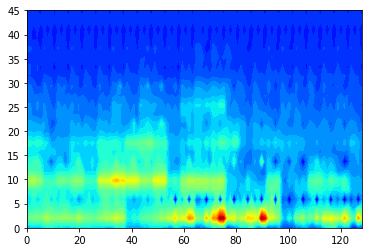

epoch [365/500], train loss:0.4236
epoch [365/500], val loss:1.5910
epoch [365/500], train accuracy:0.8578
epoch [365/500], val accuracy:0.7206


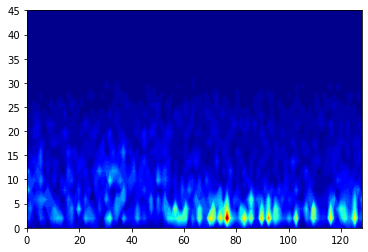

Predicted: 


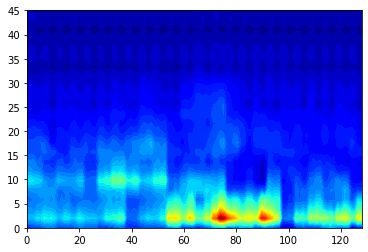

epoch [366/500], train loss:0.4231
epoch [366/500], val loss:1.5904
epoch [366/500], train accuracy:0.8836
epoch [366/500], val accuracy:0.7206


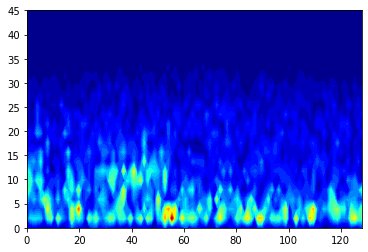

Predicted: 


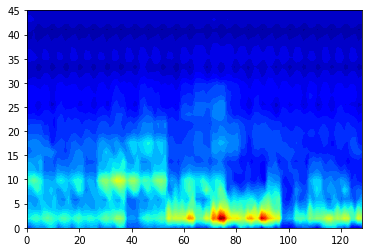

epoch [367/500], train loss:0.4147
epoch [367/500], val loss:1.5909
epoch [367/500], train accuracy:0.8836
epoch [367/500], val accuracy:0.7059


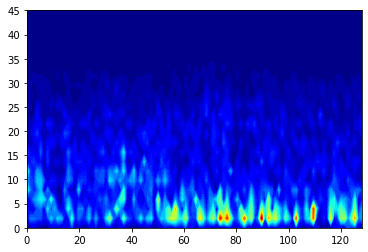

Predicted: 


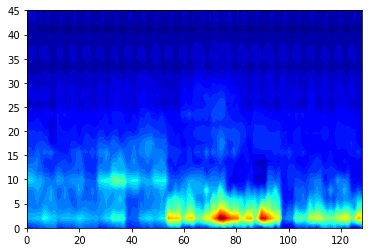

epoch [368/500], train loss:0.4158
epoch [368/500], val loss:1.5918
epoch [368/500], train accuracy:0.8707
epoch [368/500], val accuracy:0.6618


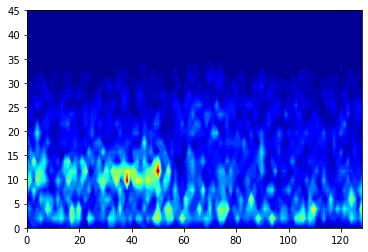

Predicted: 


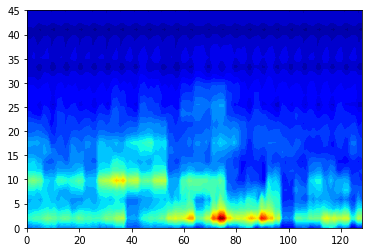

epoch [369/500], train loss:0.4191
epoch [369/500], val loss:1.5920
epoch [369/500], train accuracy:0.8578
epoch [369/500], val accuracy:0.6618


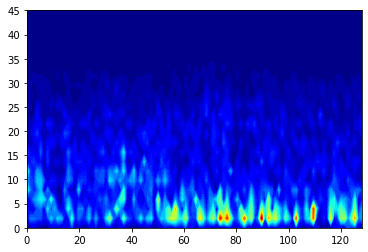

Predicted: 


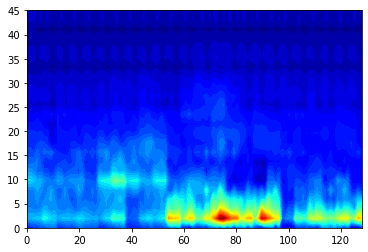

epoch [370/500], train loss:0.4181
epoch [370/500], val loss:1.5913
epoch [370/500], train accuracy:0.8578
epoch [370/500], val accuracy:0.6765


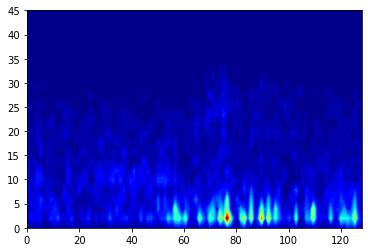

Predicted: 


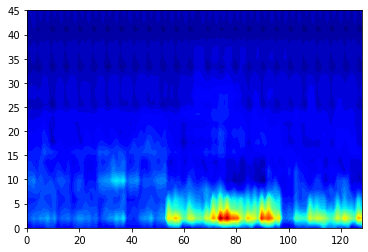

epoch [371/500], train loss:0.4149
epoch [371/500], val loss:1.5904
epoch [371/500], train accuracy:0.8578
epoch [371/500], val accuracy:0.7059


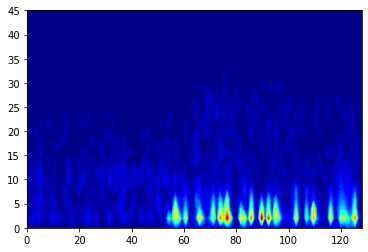

Predicted: 


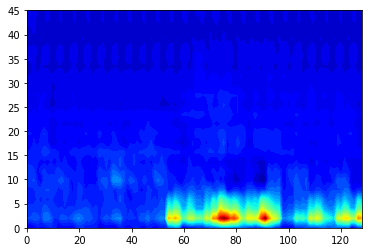

epoch [372/500], train loss:0.4135
epoch [372/500], val loss:1.5906
epoch [372/500], train accuracy:0.8621
epoch [372/500], val accuracy:0.6912


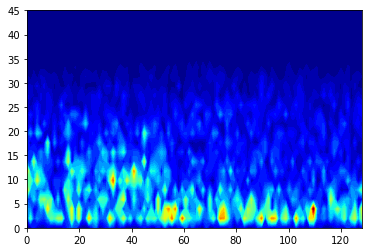

Predicted: 


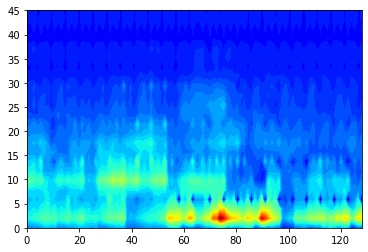

epoch [373/500], train loss:0.4136
epoch [373/500], val loss:1.5909
epoch [373/500], train accuracy:0.8793
epoch [373/500], val accuracy:0.6765


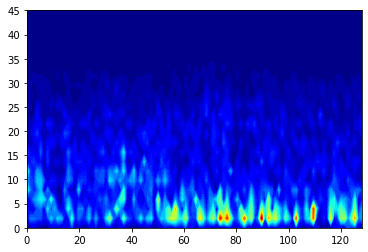

Predicted: 


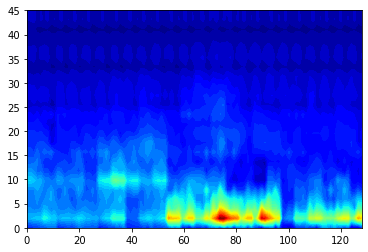

epoch [374/500], train loss:0.4108
epoch [374/500], val loss:1.5906
epoch [374/500], train accuracy:0.8793
epoch [374/500], val accuracy:0.6765


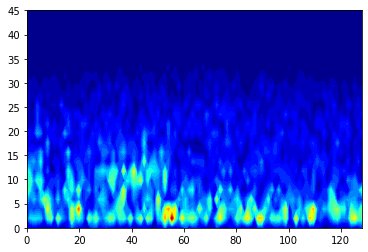

Predicted: 


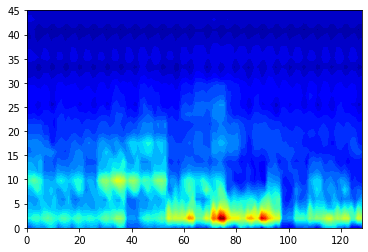

epoch [375/500], train loss:0.4119
epoch [375/500], val loss:1.5899
epoch [375/500], train accuracy:0.8793
epoch [375/500], val accuracy:0.6912


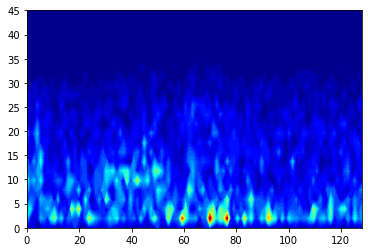

Predicted: 


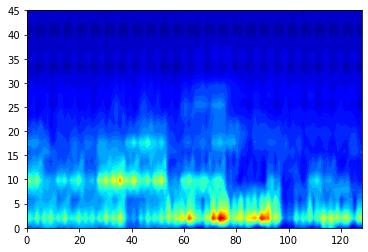

epoch [376/500], train loss:0.4200
epoch [376/500], val loss:1.5902
epoch [376/500], train accuracy:0.8534
epoch [376/500], val accuracy:0.6765


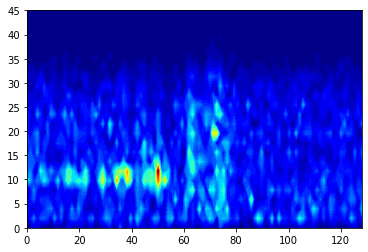

Predicted: 


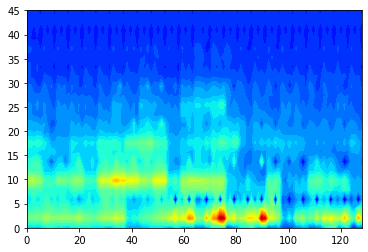

epoch [377/500], train loss:0.4139
epoch [377/500], val loss:1.5898
epoch [377/500], train accuracy:0.8707
epoch [377/500], val accuracy:0.6912


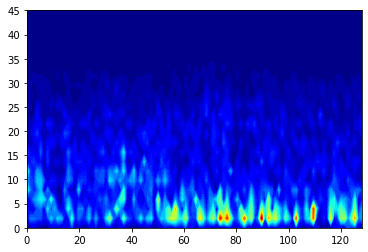

Predicted: 


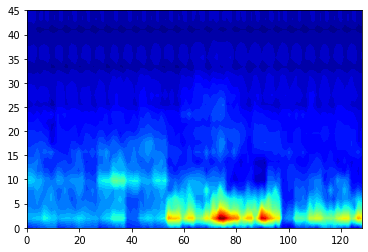

epoch [378/500], train loss:0.4120
epoch [378/500], val loss:1.5899
epoch [378/500], train accuracy:0.8750
epoch [378/500], val accuracy:0.6765


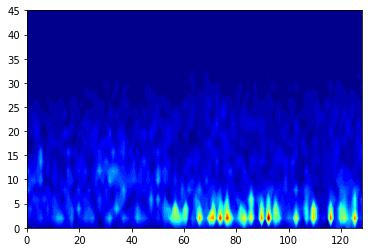

Predicted: 


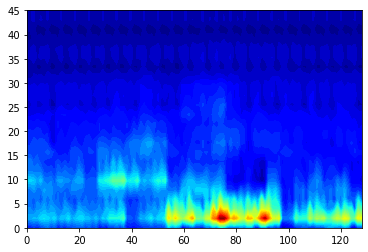

epoch [379/500], train loss:0.4154
epoch [379/500], val loss:1.5901
epoch [379/500], train accuracy:0.8621
epoch [379/500], val accuracy:0.6912


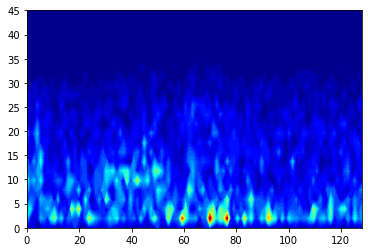

Predicted: 


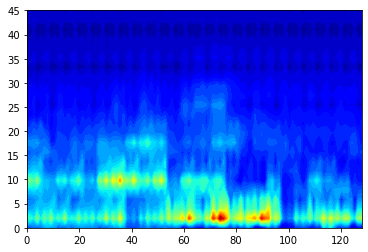

epoch [380/500], train loss:0.4122
epoch [380/500], val loss:1.5893
epoch [380/500], train accuracy:0.8664
epoch [380/500], val accuracy:0.6912


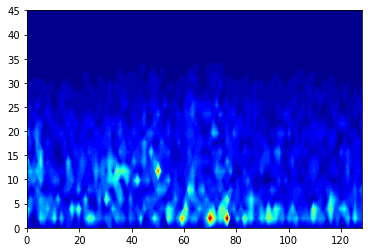

Predicted: 


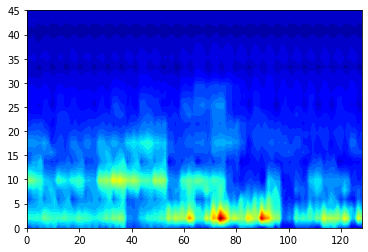

epoch [381/500], train loss:0.4140
epoch [381/500], val loss:1.5892
epoch [381/500], train accuracy:0.8621
epoch [381/500], val accuracy:0.6912


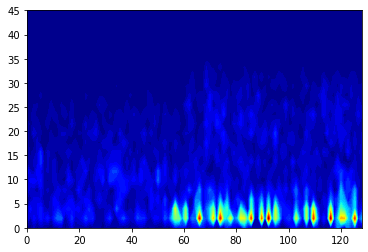

Predicted: 


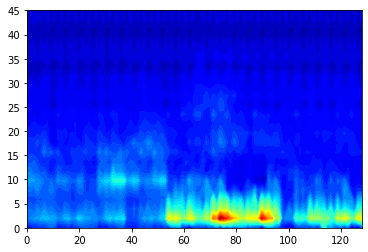

epoch [382/500], train loss:0.4141
epoch [382/500], val loss:1.5893
epoch [382/500], train accuracy:0.8664
epoch [382/500], val accuracy:0.6765


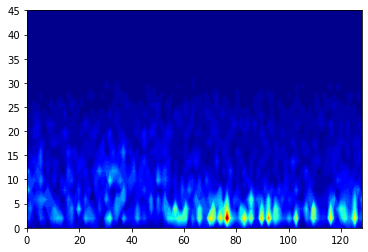

Predicted: 


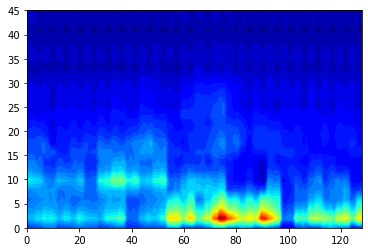

epoch [383/500], train loss:0.4117
epoch [383/500], val loss:1.5899
epoch [383/500], train accuracy:0.8836
epoch [383/500], val accuracy:0.6618


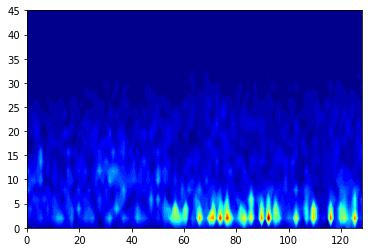

Predicted: 


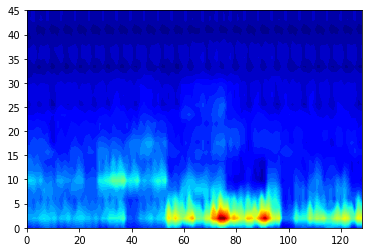

epoch [384/500], train loss:0.4121
epoch [384/500], val loss:1.5887
epoch [384/500], train accuracy:0.8621
epoch [384/500], val accuracy:0.6912


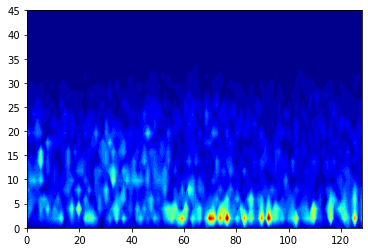

Predicted: 


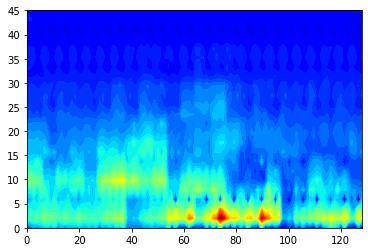

epoch [385/500], train loss:0.4194
epoch [385/500], val loss:1.5894
epoch [385/500], train accuracy:0.8621
epoch [385/500], val accuracy:0.6618


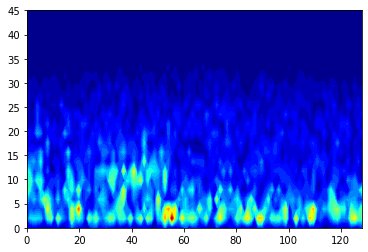

Predicted: 


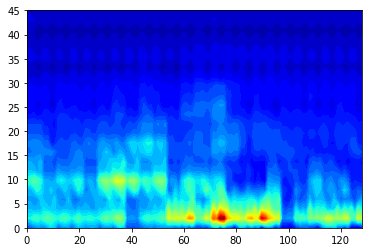

epoch [386/500], train loss:0.4116
epoch [386/500], val loss:1.5891
epoch [386/500], train accuracy:0.8707
epoch [386/500], val accuracy:0.6765


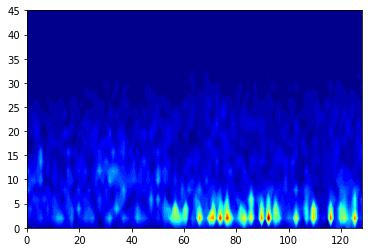

Predicted: 


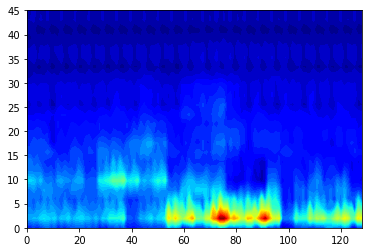

epoch [387/500], train loss:0.7285
epoch [387/500], val loss:1.5892
epoch [387/500], train accuracy:0.8664
epoch [387/500], val accuracy:0.6618


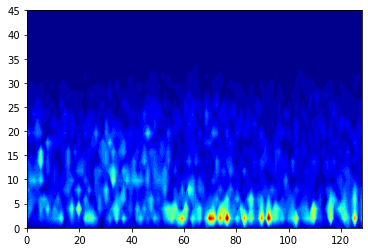

Predicted: 


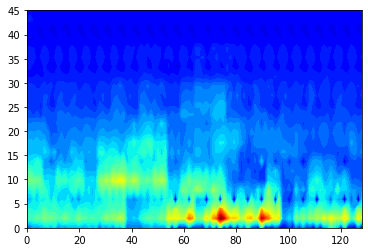

epoch [388/500], train loss:0.4113
epoch [388/500], val loss:1.5889
epoch [388/500], train accuracy:0.8491
epoch [388/500], val accuracy:0.6765


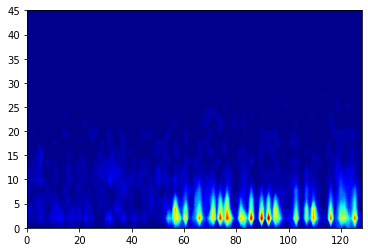

Predicted: 


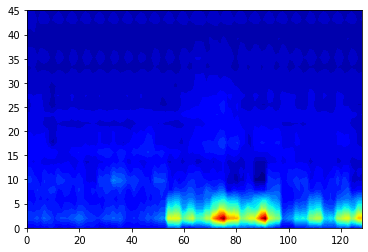

epoch [389/500], train loss:0.4152
epoch [389/500], val loss:1.5887
epoch [389/500], train accuracy:0.8922
epoch [389/500], val accuracy:0.6912


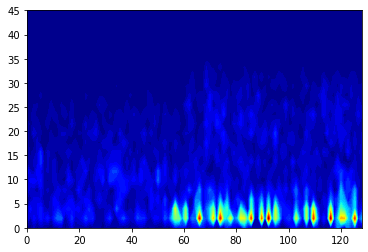

Predicted: 


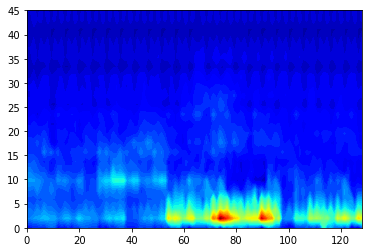

epoch [390/500], train loss:0.4127
epoch [390/500], val loss:1.5887
epoch [390/500], train accuracy:0.8836
epoch [390/500], val accuracy:0.6765


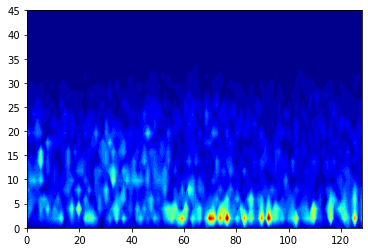

Predicted: 


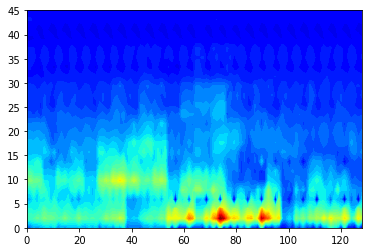

epoch [391/500], train loss:0.4101
epoch [391/500], val loss:1.5888
epoch [391/500], train accuracy:0.8750
epoch [391/500], val accuracy:0.6618


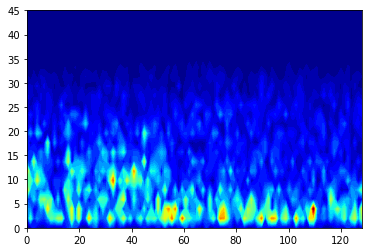

Predicted: 


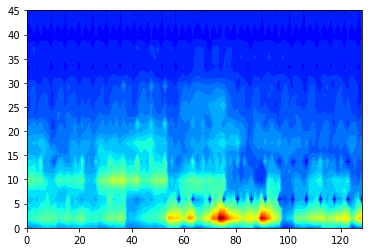

epoch [392/500], train loss:0.4078
epoch [392/500], val loss:1.5882
epoch [392/500], train accuracy:0.8750
epoch [392/500], val accuracy:0.6912


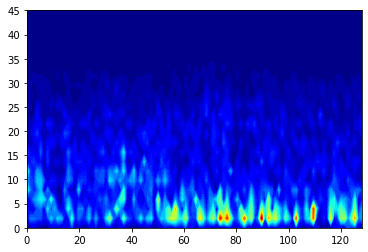

Predicted: 


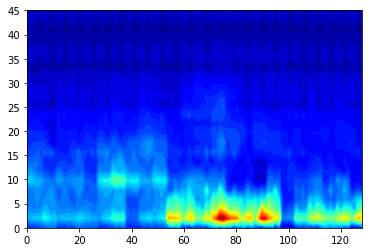

epoch [393/500], train loss:0.4081
epoch [393/500], val loss:1.5884
epoch [393/500], train accuracy:0.8664
epoch [393/500], val accuracy:0.6765


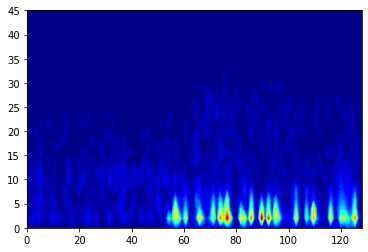

Predicted: 


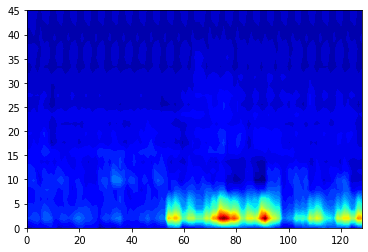

epoch [394/500], train loss:0.4108
epoch [394/500], val loss:1.5884
epoch [394/500], train accuracy:0.8750
epoch [394/500], val accuracy:0.6765


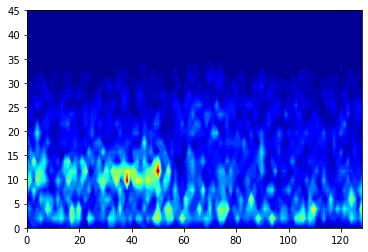

Predicted: 


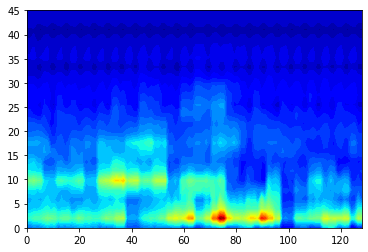

epoch [395/500], train loss:0.4099
epoch [395/500], val loss:1.5888
epoch [395/500], train accuracy:0.8966
epoch [395/500], val accuracy:0.6618


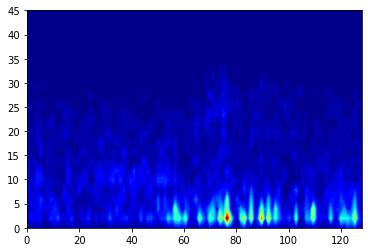

Predicted: 


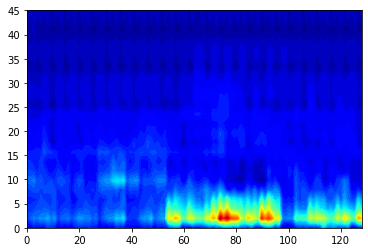

epoch [396/500], train loss:0.4095
epoch [396/500], val loss:1.5895
epoch [396/500], train accuracy:0.8750
epoch [396/500], val accuracy:0.6618


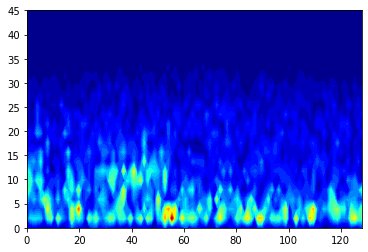

Predicted: 


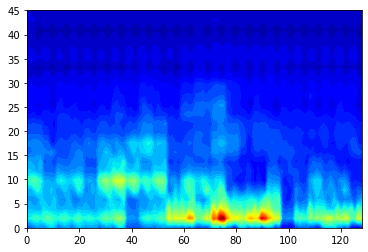

epoch [397/500], train loss:0.4302
epoch [397/500], val loss:1.5873
epoch [397/500], train accuracy:0.8750
epoch [397/500], val accuracy:0.7206


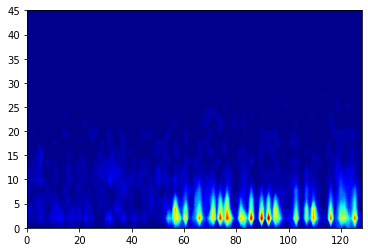

Predicted: 


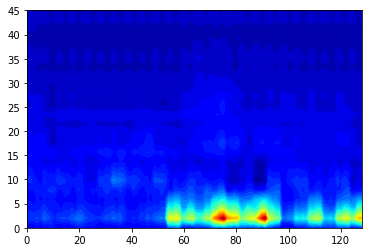

epoch [398/500], train loss:0.4092
epoch [398/500], val loss:1.5884
epoch [398/500], train accuracy:0.8750
epoch [398/500], val accuracy:0.6471


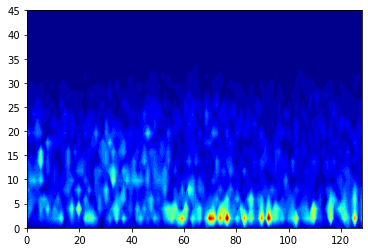

Predicted: 


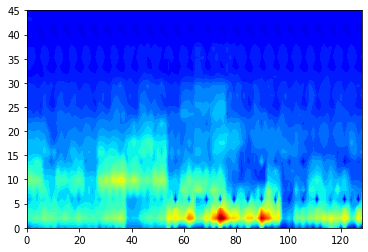

epoch [399/500], train loss:0.4101
epoch [399/500], val loss:1.5881
epoch [399/500], train accuracy:0.8793
epoch [399/500], val accuracy:0.6618


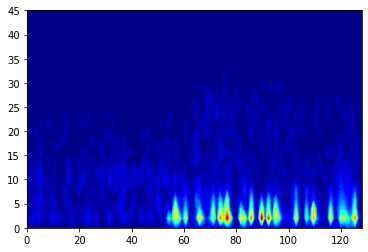

Predicted: 


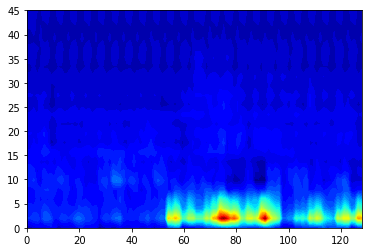

epoch [400/500], train loss:0.4053
epoch [400/500], val loss:1.5880
epoch [400/500], train accuracy:0.8750
epoch [400/500], val accuracy:0.6618


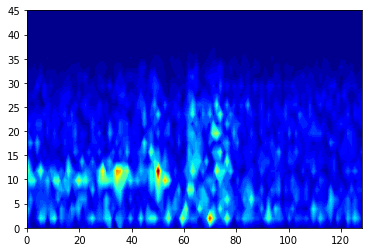

Predicted: 


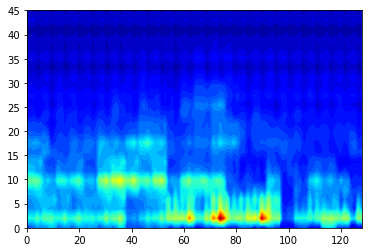

epoch [401/500], train loss:0.4088
epoch [401/500], val loss:1.5872
epoch [401/500], train accuracy:0.8621
epoch [401/500], val accuracy:0.6912


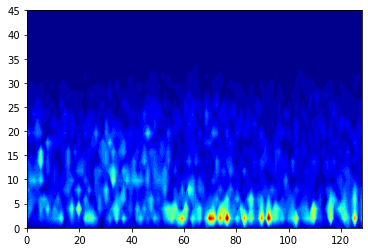

Predicted: 


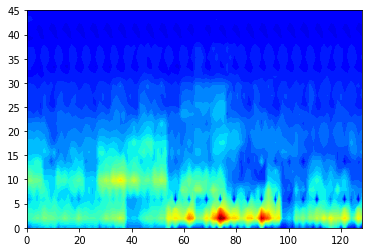

epoch [402/500], train loss:0.4070
epoch [402/500], val loss:1.5883
epoch [402/500], train accuracy:0.8836
epoch [402/500], val accuracy:0.6618


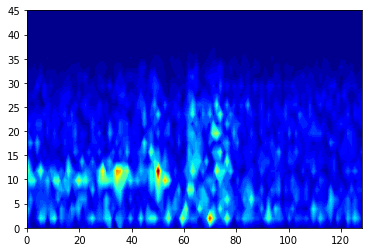

Predicted: 


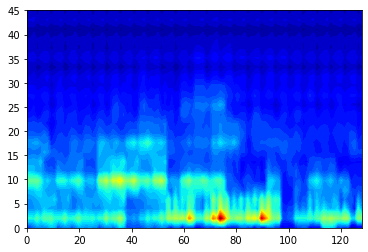

epoch [403/500], train loss:0.4634
epoch [403/500], val loss:1.5882
epoch [403/500], train accuracy:0.8836
epoch [403/500], val accuracy:0.6471


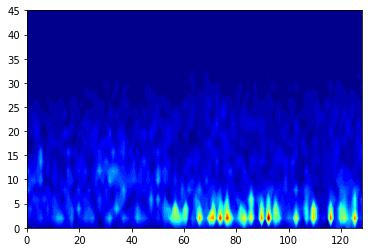

Predicted: 


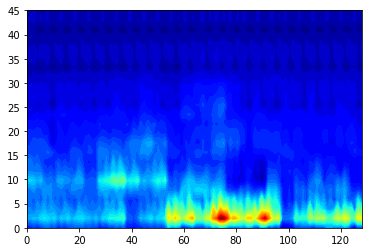

epoch [404/500], train loss:0.4053
epoch [404/500], val loss:1.5875
epoch [404/500], train accuracy:0.8707
epoch [404/500], val accuracy:0.6471


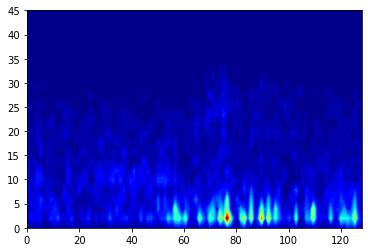

Predicted: 


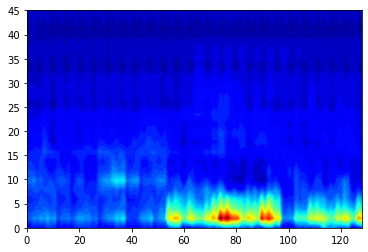

epoch [405/500], train loss:0.4075
epoch [405/500], val loss:1.5885
epoch [405/500], train accuracy:0.8879
epoch [405/500], val accuracy:0.6471


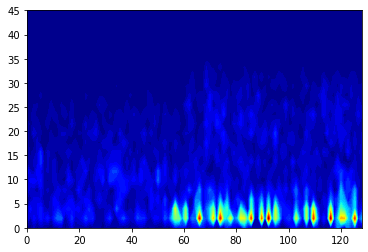

Predicted: 


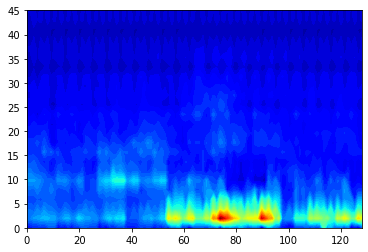

epoch [406/500], train loss:0.4027
epoch [406/500], val loss:1.5874
epoch [406/500], train accuracy:0.8836
epoch [406/500], val accuracy:0.6765


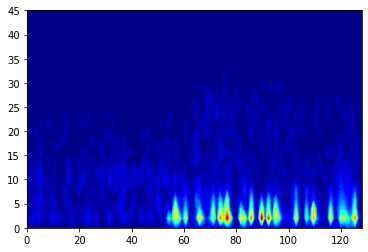

Predicted: 


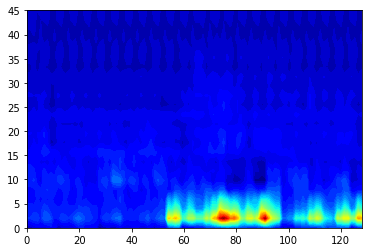

epoch [407/500], train loss:0.4059
epoch [407/500], val loss:1.5873
epoch [407/500], train accuracy:0.8664
epoch [407/500], val accuracy:0.6912


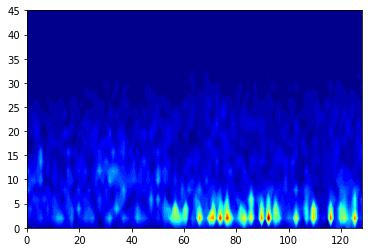

Predicted: 


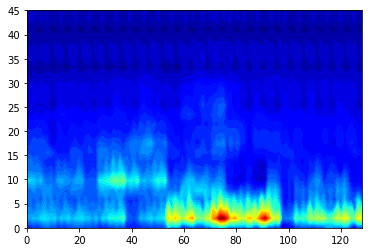

epoch [408/500], train loss:0.4047
epoch [408/500], val loss:1.5878
epoch [408/500], train accuracy:0.8879
epoch [408/500], val accuracy:0.6471


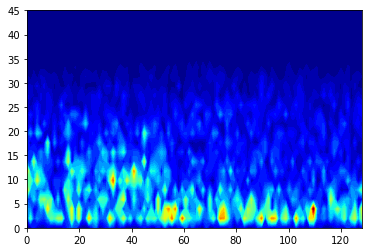

Predicted: 


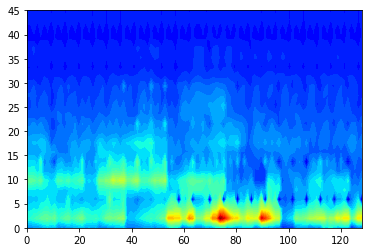

epoch [409/500], train loss:0.4062
epoch [409/500], val loss:1.5876
epoch [409/500], train accuracy:0.8879
epoch [409/500], val accuracy:0.6765


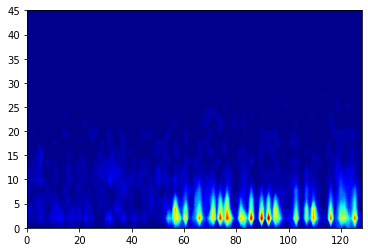

Predicted: 


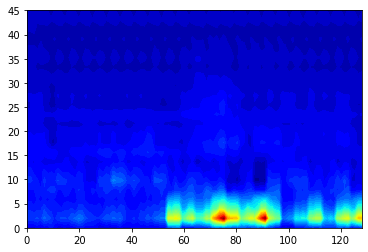

epoch [410/500], train loss:0.4053
epoch [410/500], val loss:1.5879
epoch [410/500], train accuracy:0.8578
epoch [410/500], val accuracy:0.6471


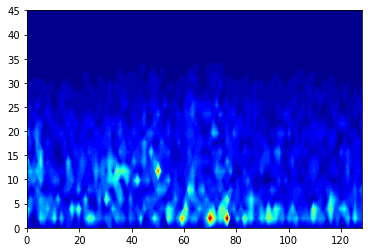

Predicted: 


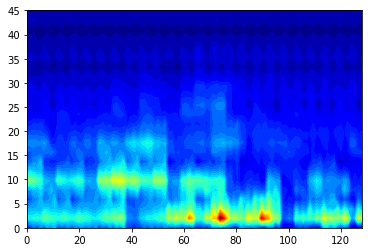

epoch [411/500], train loss:0.4082
epoch [411/500], val loss:1.5870
epoch [411/500], train accuracy:0.8664
epoch [411/500], val accuracy:0.6765


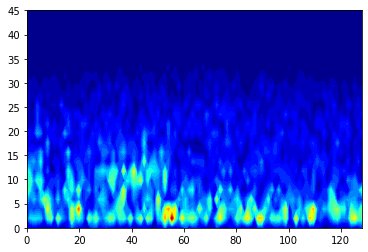

Predicted: 


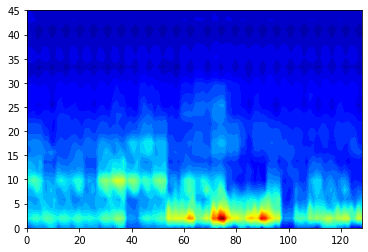

epoch [412/500], train loss:0.4022
epoch [412/500], val loss:1.5872
epoch [412/500], train accuracy:0.8966
epoch [412/500], val accuracy:0.6618


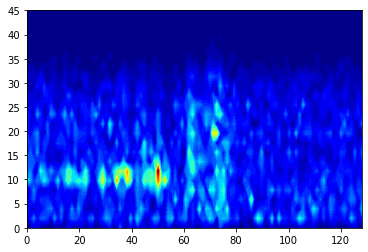

Predicted: 


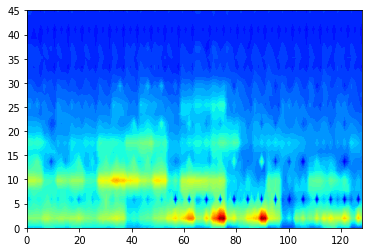

epoch [413/500], train loss:0.4097
epoch [413/500], val loss:1.5869
epoch [413/500], train accuracy:0.8664
epoch [413/500], val accuracy:0.6912


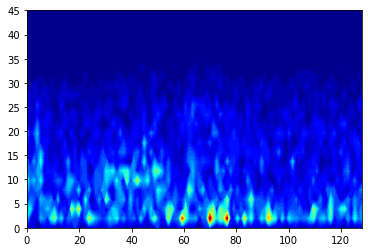

Predicted: 


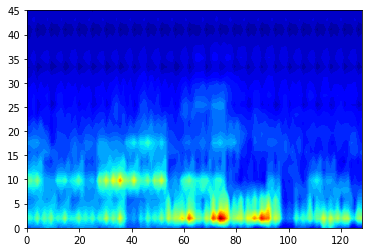

epoch [414/500], train loss:0.4022
epoch [414/500], val loss:1.5879
epoch [414/500], train accuracy:0.8836
epoch [414/500], val accuracy:0.6471


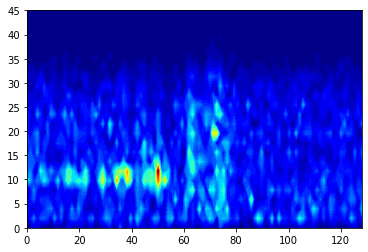

Predicted: 


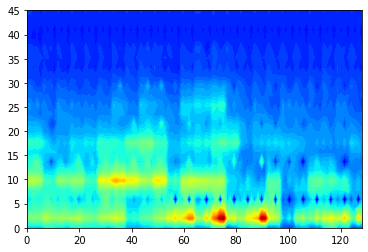

epoch [415/500], train loss:0.4087
epoch [415/500], val loss:1.5876
epoch [415/500], train accuracy:0.8707
epoch [415/500], val accuracy:0.6471


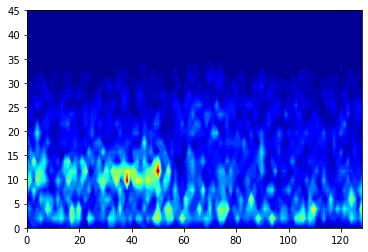

Predicted: 


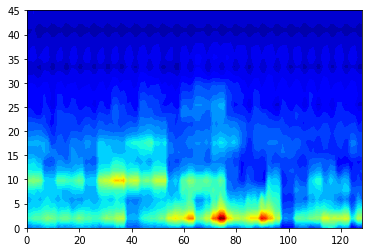

epoch [416/500], train loss:0.4063
epoch [416/500], val loss:1.5878
epoch [416/500], train accuracy:0.8966
epoch [416/500], val accuracy:0.6471


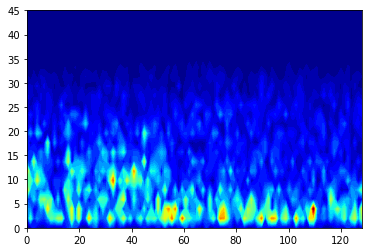

Predicted: 


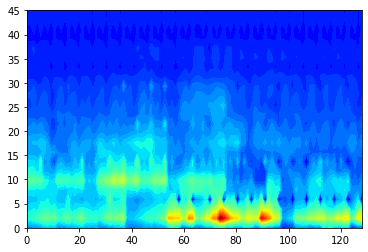

epoch [417/500], train loss:0.4038
epoch [417/500], val loss:1.5865
epoch [417/500], train accuracy:0.8750
epoch [417/500], val accuracy:0.6912


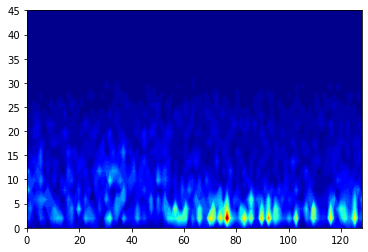

Predicted: 


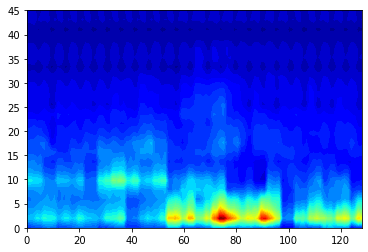

epoch [418/500], train loss:0.4033
epoch [418/500], val loss:1.5869
epoch [418/500], train accuracy:0.8879
epoch [418/500], val accuracy:0.6471


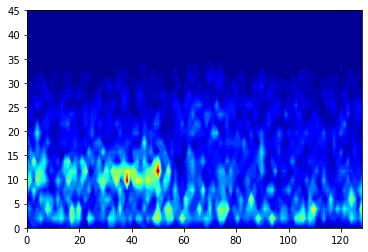

Predicted: 


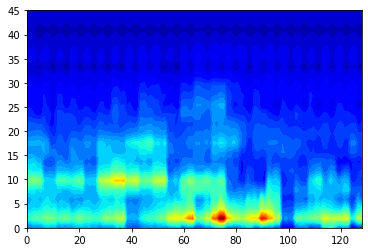

epoch [419/500], train loss:0.4034
epoch [419/500], val loss:1.5865
epoch [419/500], train accuracy:0.8922
epoch [419/500], val accuracy:0.6471


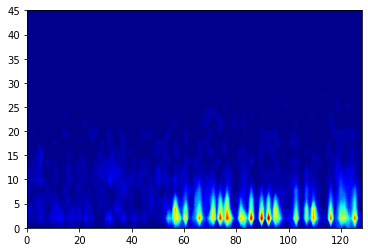

Predicted: 


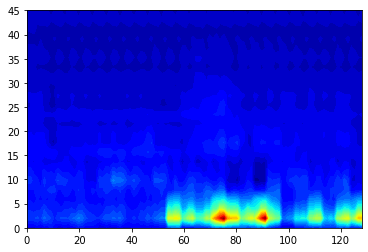

epoch [420/500], train loss:0.4063
epoch [420/500], val loss:1.5866
epoch [420/500], train accuracy:0.8793
epoch [420/500], val accuracy:0.6471


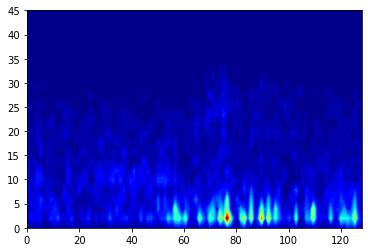

Predicted: 


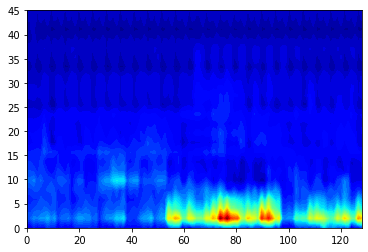

epoch [421/500], train loss:0.4006
epoch [421/500], val loss:1.5864
epoch [421/500], train accuracy:0.8922
epoch [421/500], val accuracy:0.6912


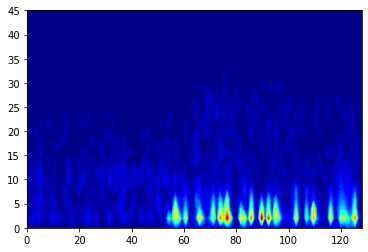

Predicted: 


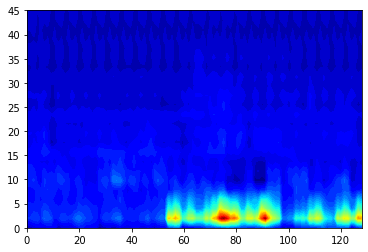

epoch [422/500], train loss:0.4042
epoch [422/500], val loss:1.5864
epoch [422/500], train accuracy:0.8750
epoch [422/500], val accuracy:0.6618


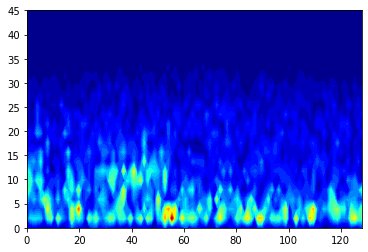

Predicted: 


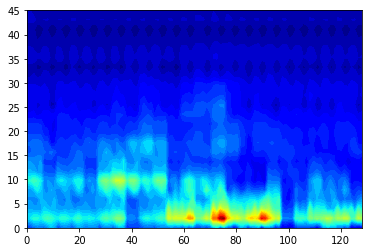

epoch [423/500], train loss:0.3995
epoch [423/500], val loss:1.5862
epoch [423/500], train accuracy:0.8707
epoch [423/500], val accuracy:0.6912


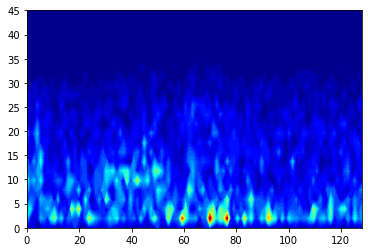

Predicted: 


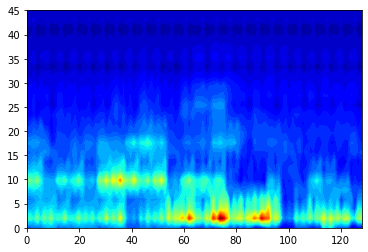

epoch [424/500], train loss:0.4018
epoch [424/500], val loss:1.5860
epoch [424/500], train accuracy:0.8879
epoch [424/500], val accuracy:0.7059


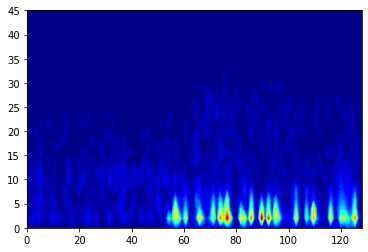

Predicted: 


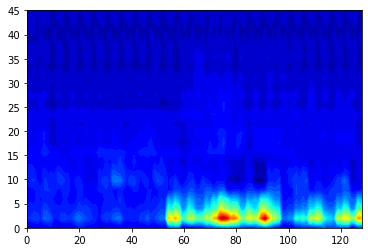

epoch [425/500], train loss:0.4034
epoch [425/500], val loss:1.5865
epoch [425/500], train accuracy:0.8750
epoch [425/500], val accuracy:0.6471


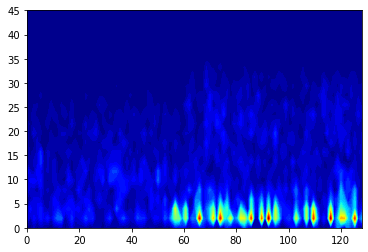

Predicted: 


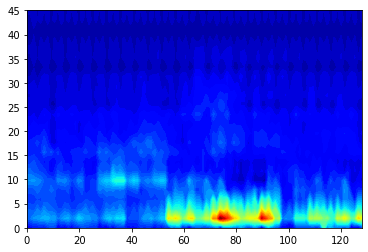

epoch [426/500], train loss:0.3981
epoch [426/500], val loss:1.5866
epoch [426/500], train accuracy:0.8879
epoch [426/500], val accuracy:0.6471


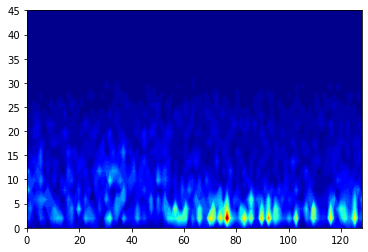

Predicted: 


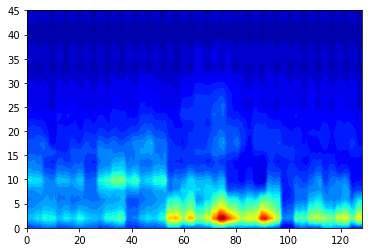

epoch [427/500], train loss:0.4022
epoch [427/500], val loss:1.5868
epoch [427/500], train accuracy:0.8664
epoch [427/500], val accuracy:0.6471


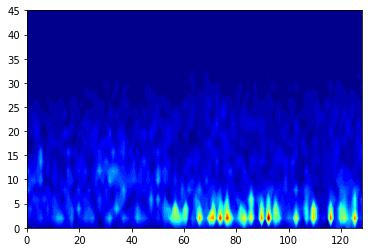

Predicted: 


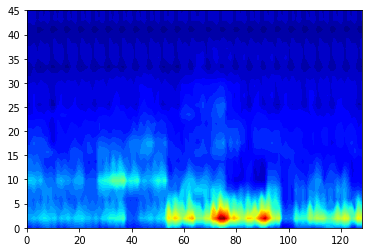

epoch [428/500], train loss:0.4047
epoch [428/500], val loss:1.5858
epoch [428/500], train accuracy:0.8750
epoch [428/500], val accuracy:0.6765


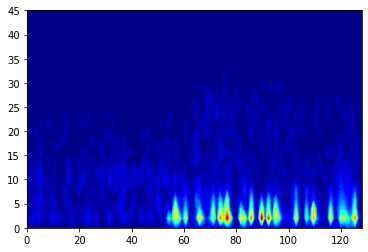

Predicted: 


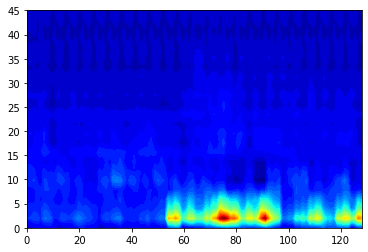

epoch [429/500], train loss:0.4060
epoch [429/500], val loss:1.5864
epoch [429/500], train accuracy:0.8793
epoch [429/500], val accuracy:0.6471


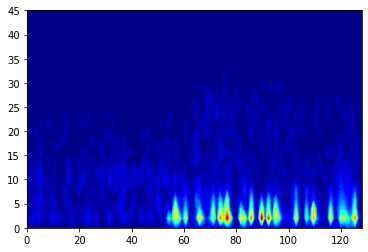

Predicted: 


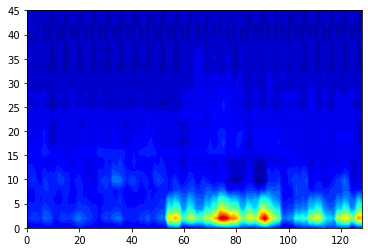

epoch [430/500], train loss:0.3995
epoch [430/500], val loss:1.5854
epoch [430/500], train accuracy:0.8750
epoch [430/500], val accuracy:0.6618


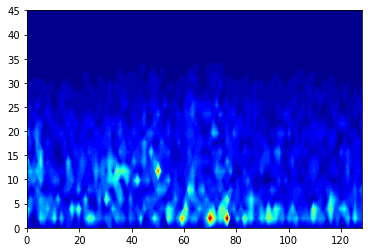

Predicted: 


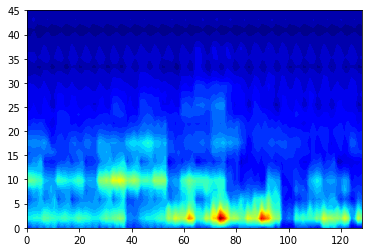

epoch [431/500], train loss:0.4004
epoch [431/500], val loss:1.5869
epoch [431/500], train accuracy:0.8879
epoch [431/500], val accuracy:0.6471


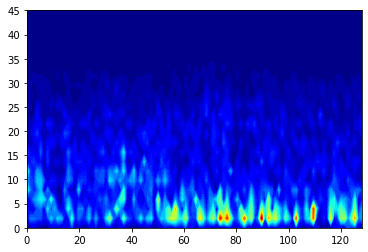

Predicted: 


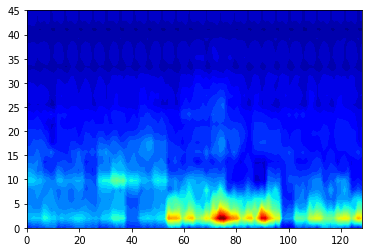

epoch [432/500], train loss:0.4013
epoch [432/500], val loss:1.5857
epoch [432/500], train accuracy:0.8707
epoch [432/500], val accuracy:0.6471


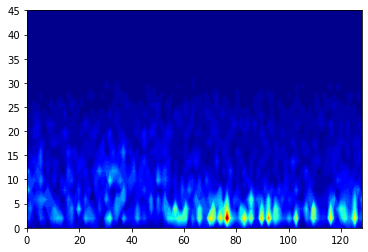

Predicted: 


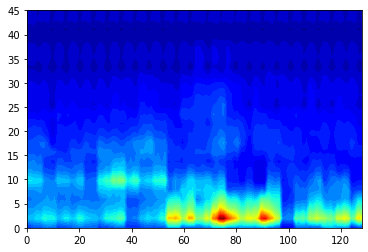

epoch [433/500], train loss:0.3999
epoch [433/500], val loss:1.5849
epoch [433/500], train accuracy:0.8879
epoch [433/500], val accuracy:0.7059


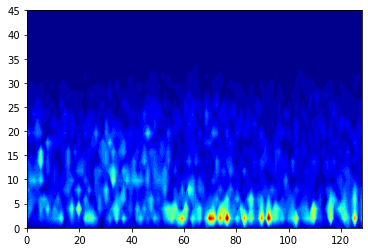

Predicted: 


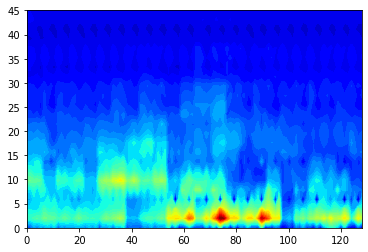

epoch [434/500], train loss:0.3982
epoch [434/500], val loss:1.5856
epoch [434/500], train accuracy:0.8793
epoch [434/500], val accuracy:0.6618


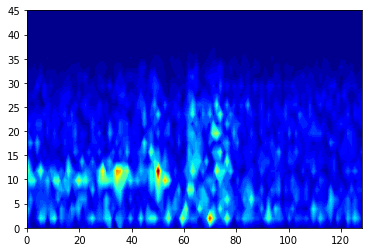

Predicted: 


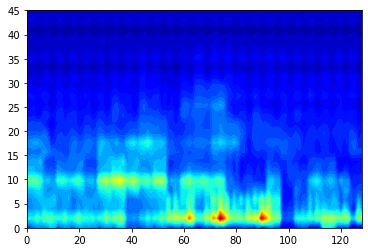

epoch [435/500], train loss:0.3956
epoch [435/500], val loss:1.5856
epoch [435/500], train accuracy:0.8966
epoch [435/500], val accuracy:0.6618


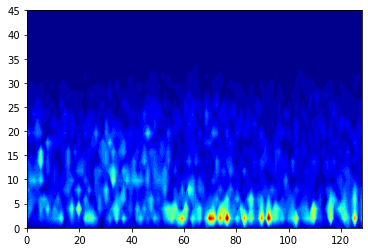

Predicted: 


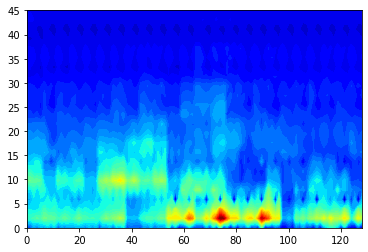

epoch [436/500], train loss:0.3989
epoch [436/500], val loss:1.5852
epoch [436/500], train accuracy:0.8966
epoch [436/500], val accuracy:0.6765


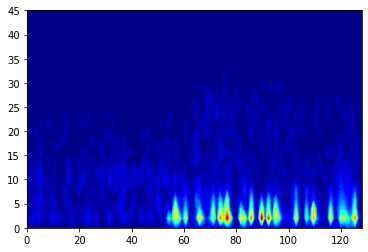

Predicted: 


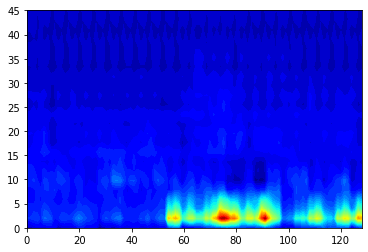

epoch [437/500], train loss:0.4088
epoch [437/500], val loss:1.5847
epoch [437/500], train accuracy:0.8966
epoch [437/500], val accuracy:0.7059


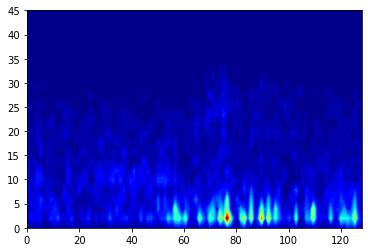

Predicted: 


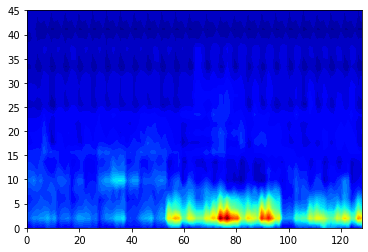

epoch [438/500], train loss:0.4181
epoch [438/500], val loss:1.5853
epoch [438/500], train accuracy:0.8793
epoch [438/500], val accuracy:0.6765


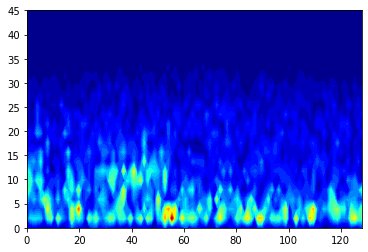

Predicted: 


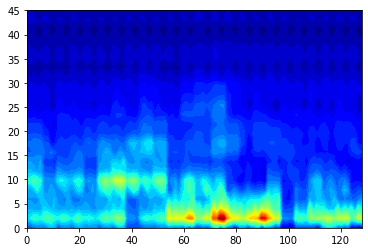

epoch [439/500], train loss:0.3996
epoch [439/500], val loss:1.5867
epoch [439/500], train accuracy:0.8836
epoch [439/500], val accuracy:0.6471


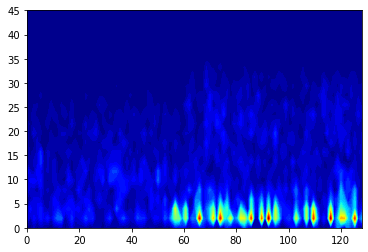

Predicted: 


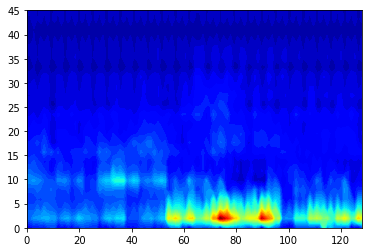

epoch [440/500], train loss:0.3973
epoch [440/500], val loss:1.5848
epoch [440/500], train accuracy:0.8879
epoch [440/500], val accuracy:0.7059


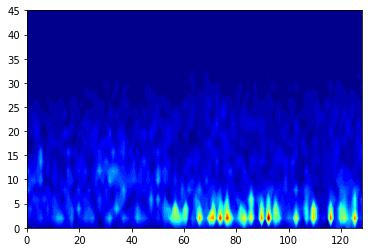

Predicted: 


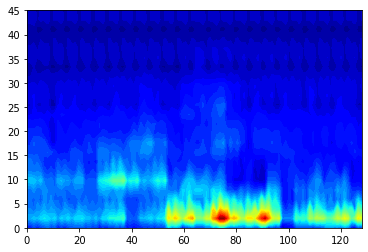

epoch [441/500], train loss:0.3979
epoch [441/500], val loss:1.5868
epoch [441/500], train accuracy:0.8793
epoch [441/500], val accuracy:0.6471


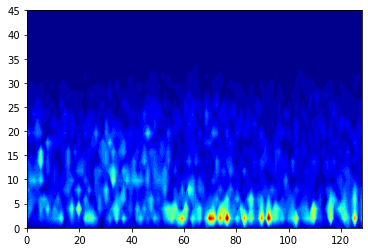

Predicted: 


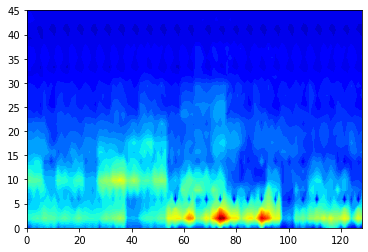

epoch [442/500], train loss:0.4011
epoch [442/500], val loss:1.5850
epoch [442/500], train accuracy:0.8664
epoch [442/500], val accuracy:0.6765


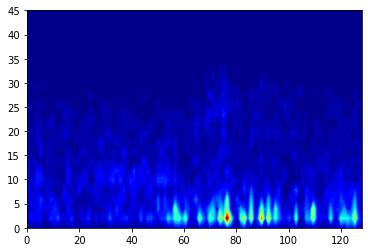

Predicted: 


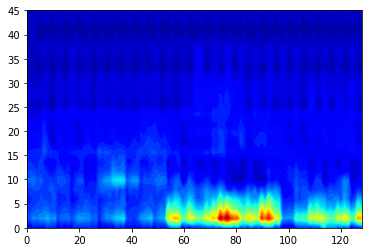

epoch [443/500], train loss:0.3981
epoch [443/500], val loss:1.5861
epoch [443/500], train accuracy:0.8922
epoch [443/500], val accuracy:0.6471


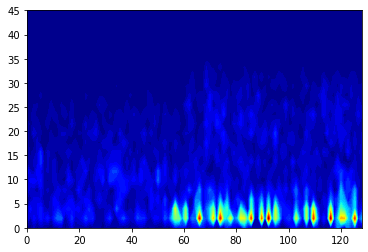

Predicted: 


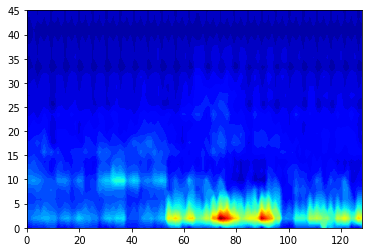

epoch [444/500], train loss:0.3988
epoch [444/500], val loss:1.5855
epoch [444/500], train accuracy:0.8793
epoch [444/500], val accuracy:0.6471


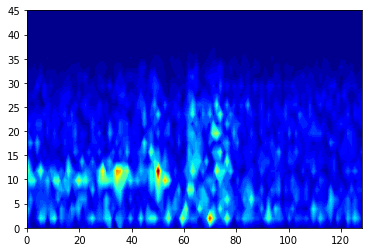

Predicted: 


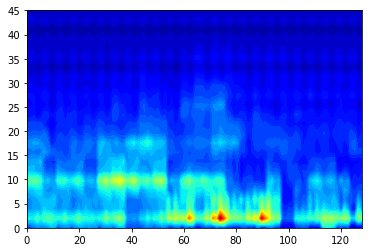

epoch [445/500], train loss:0.3970
epoch [445/500], val loss:1.5841
epoch [445/500], train accuracy:0.8707
epoch [445/500], val accuracy:0.7059


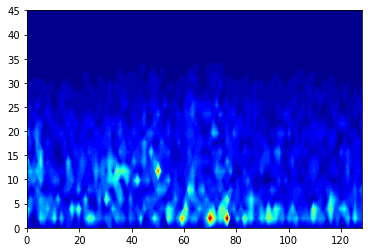

Predicted: 


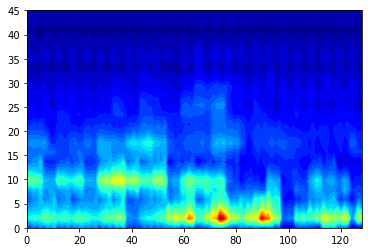

epoch [446/500], train loss:0.3965
epoch [446/500], val loss:1.5859
epoch [446/500], train accuracy:0.8966
epoch [446/500], val accuracy:0.6471


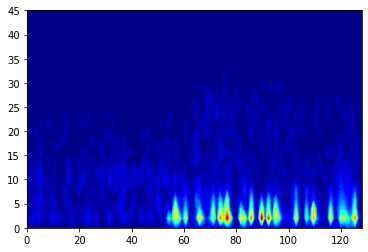

Predicted: 


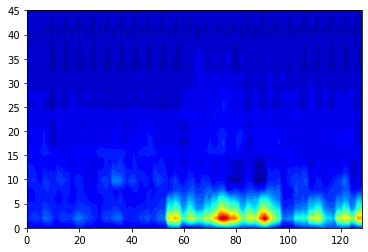

epoch [447/500], train loss:0.3968
epoch [447/500], val loss:1.5845
epoch [447/500], train accuracy:0.8578
epoch [447/500], val accuracy:0.6912


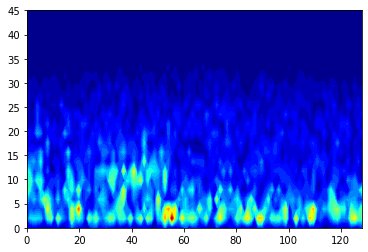

Predicted: 


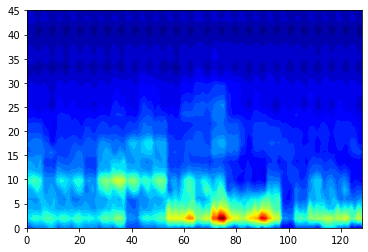

epoch [448/500], train loss:0.4083
epoch [448/500], val loss:1.5845
epoch [448/500], train accuracy:0.8966
epoch [448/500], val accuracy:0.6765


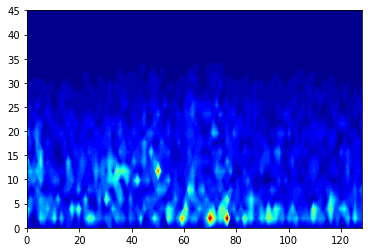

Predicted: 


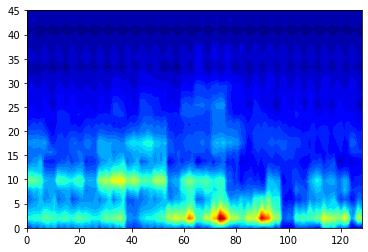

epoch [449/500], train loss:0.3954
epoch [449/500], val loss:1.5845
epoch [449/500], train accuracy:0.8664
epoch [449/500], val accuracy:0.6765


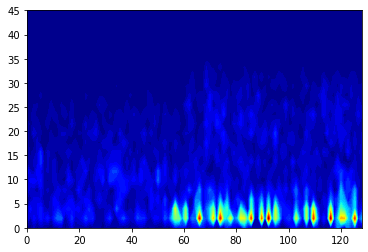

Predicted: 


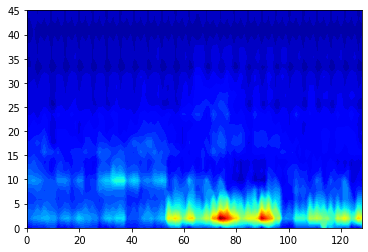

epoch [450/500], train loss:0.3936
epoch [450/500], val loss:1.5847
epoch [450/500], train accuracy:0.9095
epoch [450/500], val accuracy:0.6618


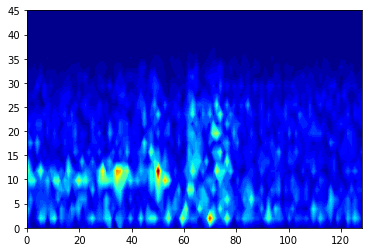

Predicted: 


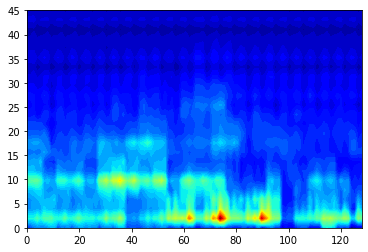

epoch [451/500], train loss:0.3929
epoch [451/500], val loss:1.5847
epoch [451/500], train accuracy:0.8922
epoch [451/500], val accuracy:0.6618


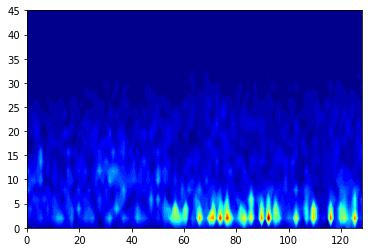

Predicted: 


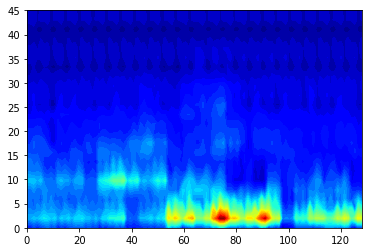

epoch [452/500], train loss:0.3963
epoch [452/500], val loss:1.5863
epoch [452/500], train accuracy:0.8707
epoch [452/500], val accuracy:0.6471


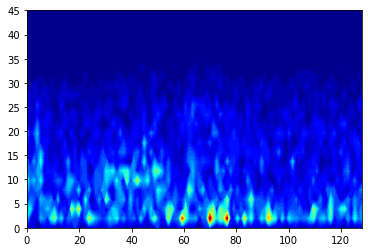

Predicted: 


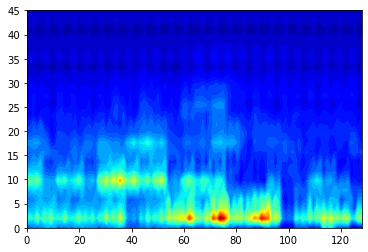

epoch [453/500], train loss:0.3930
epoch [453/500], val loss:1.5841
epoch [453/500], train accuracy:0.9224
epoch [453/500], val accuracy:0.6765


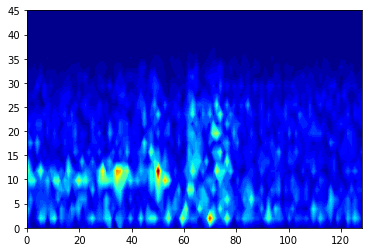

Predicted: 


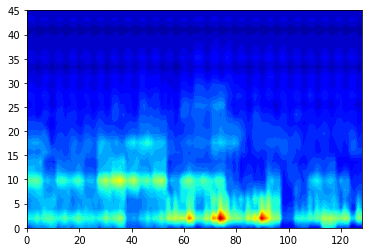

epoch [454/500], train loss:0.3915
epoch [454/500], val loss:1.5854
epoch [454/500], train accuracy:0.8879
epoch [454/500], val accuracy:0.6471


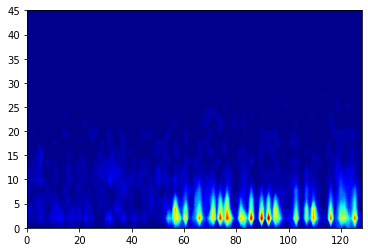

Predicted: 


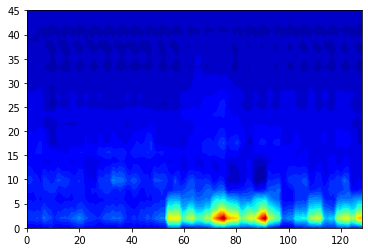

epoch [455/500], train loss:0.3970
epoch [455/500], val loss:1.5848
epoch [455/500], train accuracy:0.9009
epoch [455/500], val accuracy:0.6471


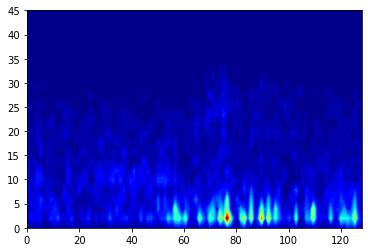

Predicted: 


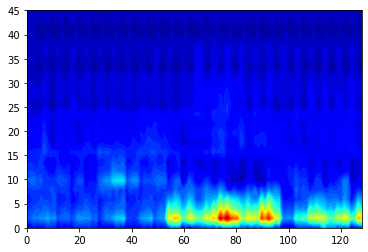

epoch [456/500], train loss:0.3937
epoch [456/500], val loss:1.5837
epoch [456/500], train accuracy:0.8836
epoch [456/500], val accuracy:0.6765


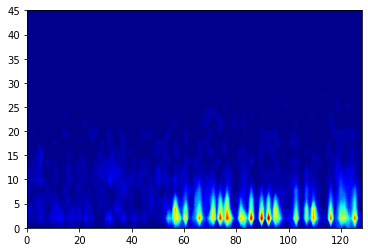

Predicted: 


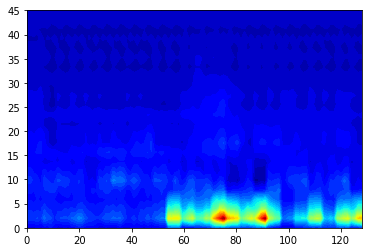

epoch [457/500], train loss:0.3980
epoch [457/500], val loss:1.5837
epoch [457/500], train accuracy:0.8879
epoch [457/500], val accuracy:0.6912


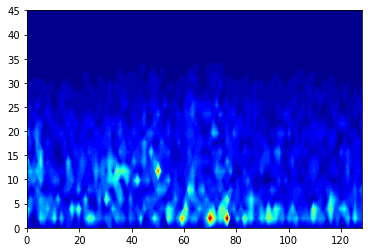

Predicted: 


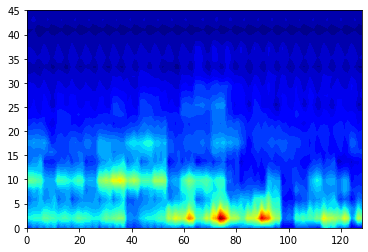

epoch [458/500], train loss:0.3965
epoch [458/500], val loss:1.5839
epoch [458/500], train accuracy:0.8836
epoch [458/500], val accuracy:0.6765


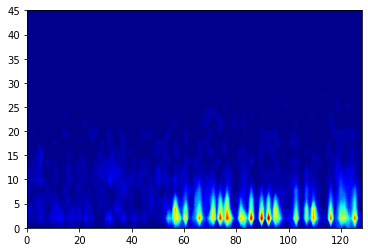

Predicted: 


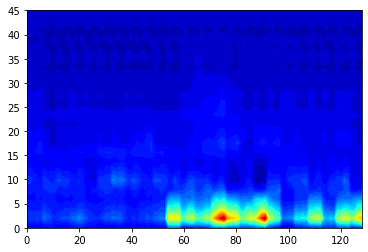

epoch [459/500], train loss:0.3928
epoch [459/500], val loss:1.5841
epoch [459/500], train accuracy:0.8966
epoch [459/500], val accuracy:0.6618


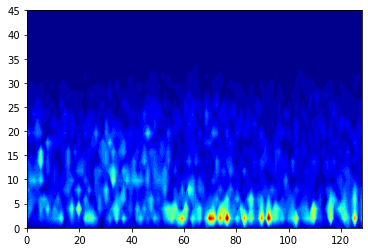

Predicted: 


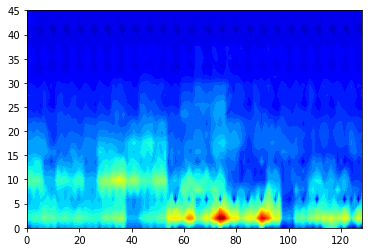

epoch [460/500], train loss:0.3956
epoch [460/500], val loss:1.5834
epoch [460/500], train accuracy:0.8922
epoch [460/500], val accuracy:0.6765


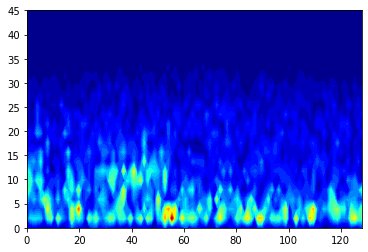

Predicted: 


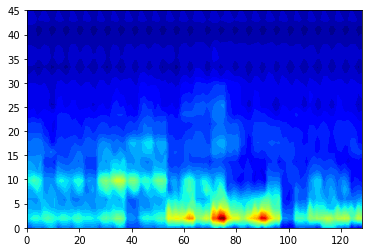

epoch [461/500], train loss:0.3914
epoch [461/500], val loss:1.5842
epoch [461/500], train accuracy:0.8922
epoch [461/500], val accuracy:0.6471


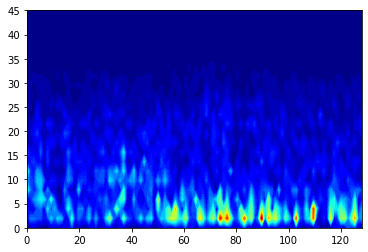

Predicted: 


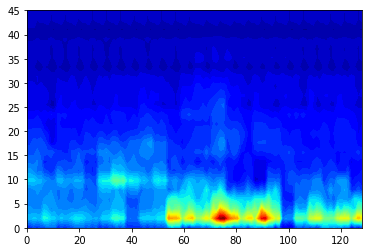

epoch [462/500], train loss:0.3958
epoch [462/500], val loss:1.5841
epoch [462/500], train accuracy:0.8836
epoch [462/500], val accuracy:0.6618


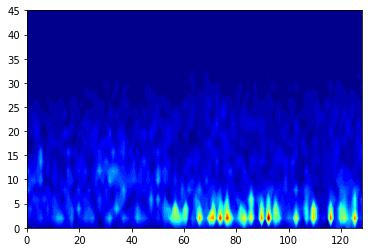

Predicted: 


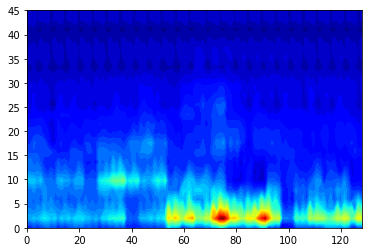

epoch [463/500], train loss:0.4000
epoch [463/500], val loss:1.5846
epoch [463/500], train accuracy:0.8664
epoch [463/500], val accuracy:0.6471


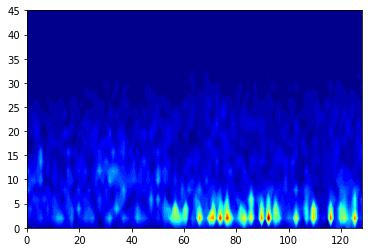

Predicted: 


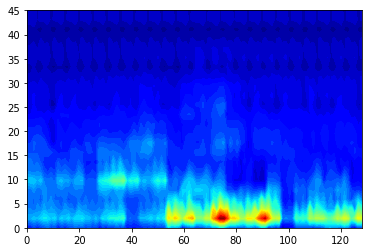

epoch [464/500], train loss:0.3951
epoch [464/500], val loss:1.5840
epoch [464/500], train accuracy:0.8750
epoch [464/500], val accuracy:0.6618


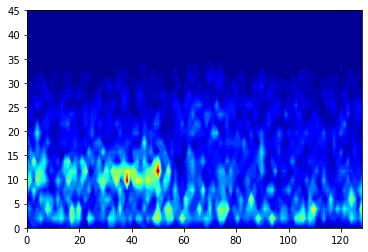

Predicted: 


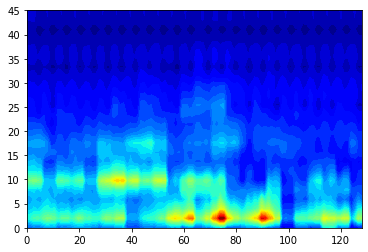

epoch [465/500], train loss:0.3939
epoch [465/500], val loss:1.5842
epoch [465/500], train accuracy:0.8966
epoch [465/500], val accuracy:0.6765


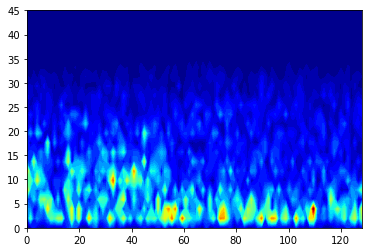

Predicted: 


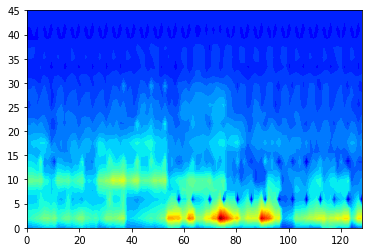

epoch [466/500], train loss:0.4464
epoch [466/500], val loss:1.5843
epoch [466/500], train accuracy:0.9138
epoch [466/500], val accuracy:0.6618


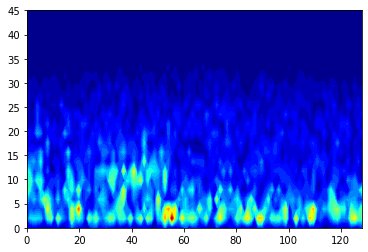

Predicted: 


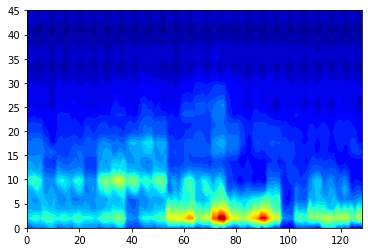

epoch [467/500], train loss:0.3908
epoch [467/500], val loss:1.5833
epoch [467/500], train accuracy:0.8750
epoch [467/500], val accuracy:0.6912


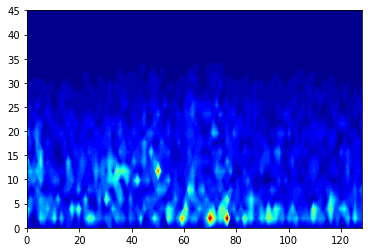

Predicted: 


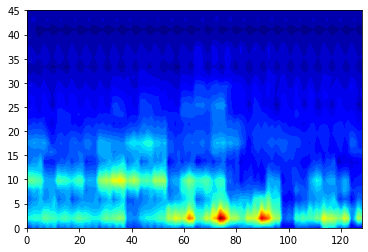

epoch [468/500], train loss:0.3912
epoch [468/500], val loss:1.5851
epoch [468/500], train accuracy:0.9009
epoch [468/500], val accuracy:0.6471


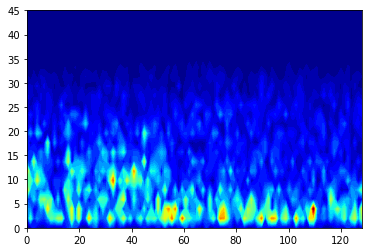

Predicted: 


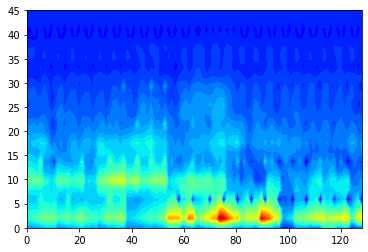

epoch [469/500], train loss:0.3903
epoch [469/500], val loss:1.5846
epoch [469/500], train accuracy:0.9138
epoch [469/500], val accuracy:0.6471


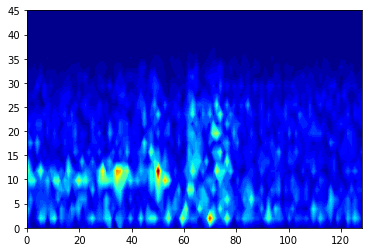

Predicted: 


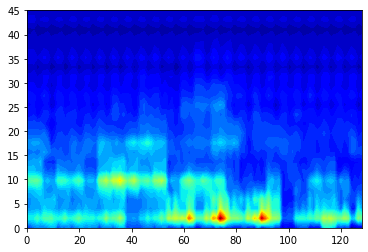

epoch [470/500], train loss:0.3917
epoch [470/500], val loss:1.5836
epoch [470/500], train accuracy:0.8922
epoch [470/500], val accuracy:0.6765


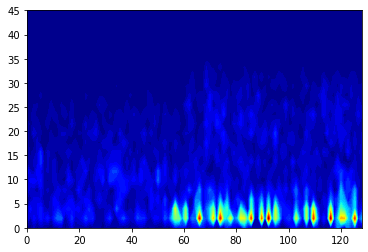

Predicted: 


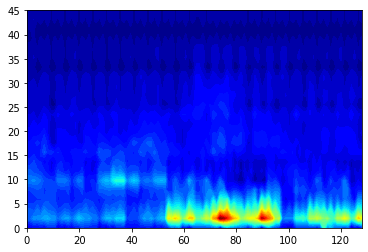

epoch [471/500], train loss:0.3905
epoch [471/500], val loss:1.5836
epoch [471/500], train accuracy:0.9052
epoch [471/500], val accuracy:0.6765


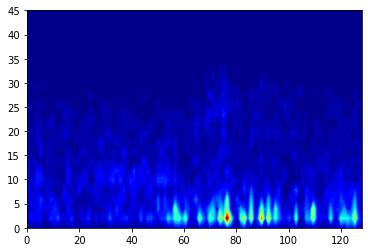

Predicted: 


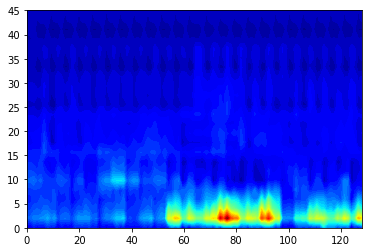

epoch [472/500], train loss:0.3965
epoch [472/500], val loss:1.5838
epoch [472/500], train accuracy:0.8922
epoch [472/500], val accuracy:0.6765


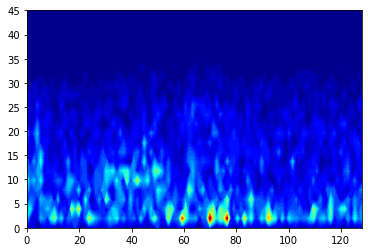

Predicted: 


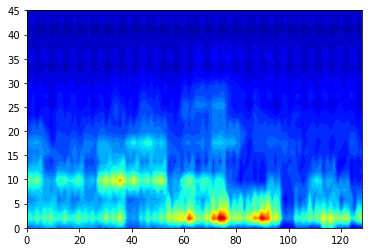

epoch [473/500], train loss:0.3965
epoch [473/500], val loss:1.5842
epoch [473/500], train accuracy:0.8966
epoch [473/500], val accuracy:0.6471


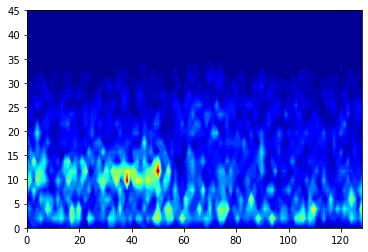

Predicted: 


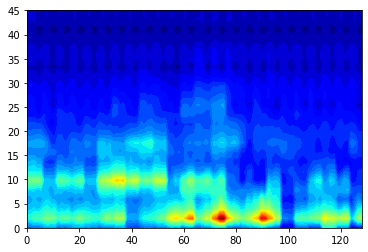

epoch [474/500], train loss:0.3916
epoch [474/500], val loss:1.5839
epoch [474/500], train accuracy:0.8879
epoch [474/500], val accuracy:0.6618


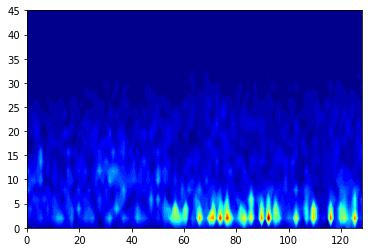

Predicted: 


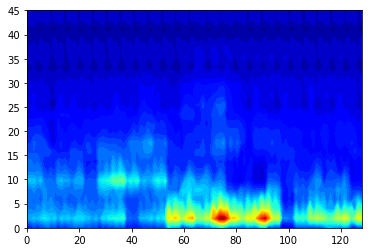

epoch [475/500], train loss:0.3909
epoch [475/500], val loss:1.5836
epoch [475/500], train accuracy:0.8707
epoch [475/500], val accuracy:0.6618


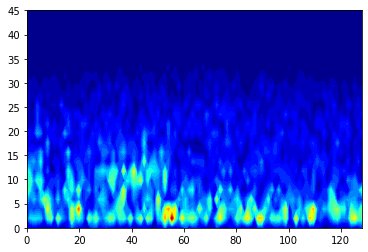

Predicted: 


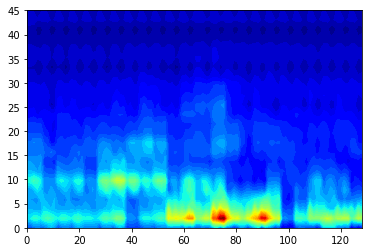

epoch [476/500], train loss:0.3903
epoch [476/500], val loss:1.5841
epoch [476/500], train accuracy:0.9095
epoch [476/500], val accuracy:0.6618


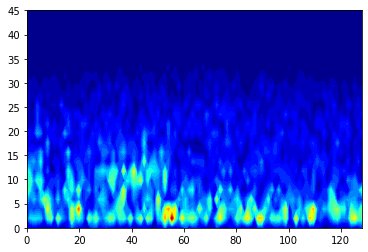

Predicted: 


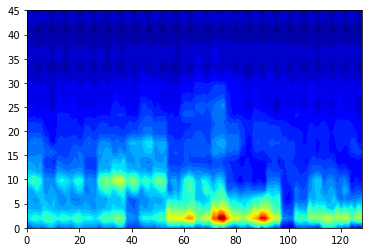

epoch [477/500], train loss:0.3892
epoch [477/500], val loss:1.5842
epoch [477/500], train accuracy:0.9095
epoch [477/500], val accuracy:0.6471


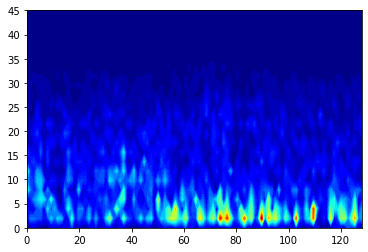

Predicted: 


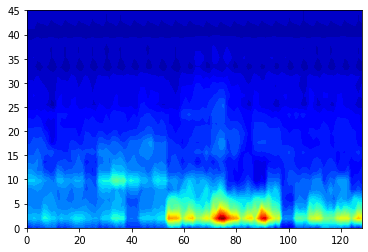

epoch [478/500], train loss:0.3902
epoch [478/500], val loss:1.5833
epoch [478/500], train accuracy:0.9009
epoch [478/500], val accuracy:0.6765


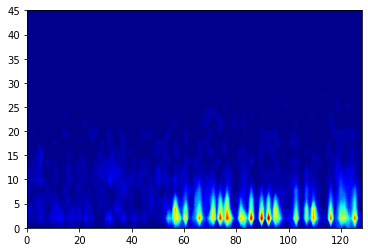

Predicted: 


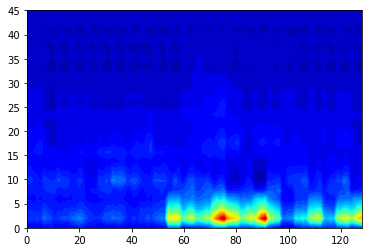

epoch [479/500], train loss:0.3874
epoch [479/500], val loss:1.5837
epoch [479/500], train accuracy:0.9009
epoch [479/500], val accuracy:0.6618


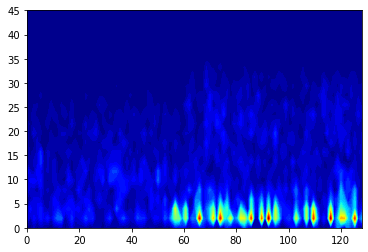

Predicted: 


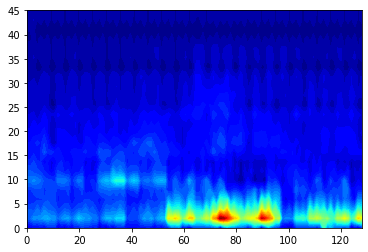

epoch [480/500], train loss:0.3870
epoch [480/500], val loss:1.5834
epoch [480/500], train accuracy:0.8966
epoch [480/500], val accuracy:0.6765


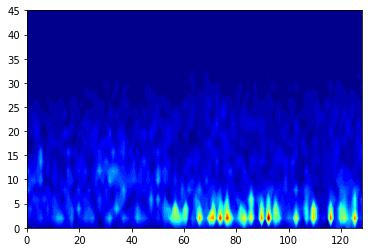

Predicted: 


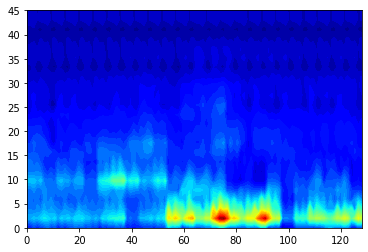

epoch [481/500], train loss:0.3893
epoch [481/500], val loss:1.5839
epoch [481/500], train accuracy:0.8966
epoch [481/500], val accuracy:0.6618


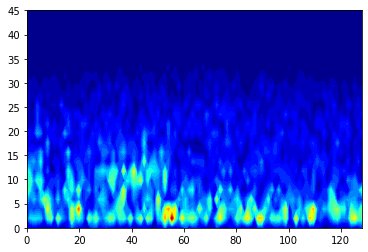

Predicted: 


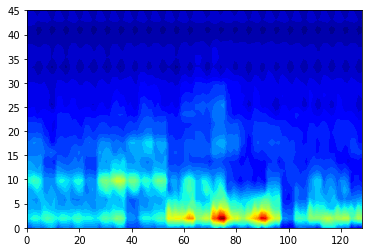

epoch [482/500], train loss:0.3873
epoch [482/500], val loss:1.5838
epoch [482/500], train accuracy:0.9009
epoch [482/500], val accuracy:0.6618


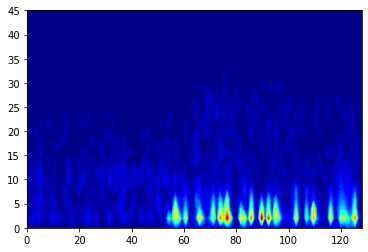

Predicted: 


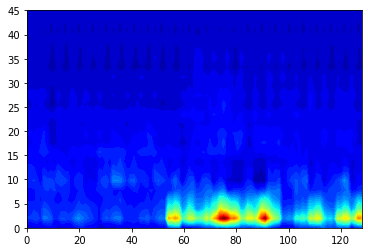

epoch [483/500], train loss:0.3873
epoch [483/500], val loss:1.5844
epoch [483/500], train accuracy:0.8966
epoch [483/500], val accuracy:0.6471


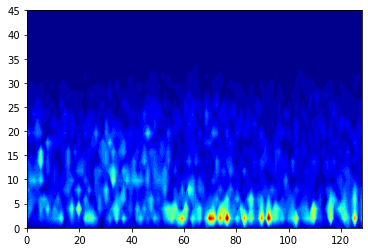

Predicted: 


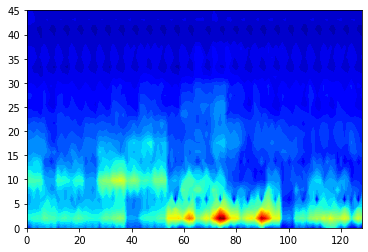

epoch [484/500], train loss:0.3842
epoch [484/500], val loss:1.5829
epoch [484/500], train accuracy:0.8922
epoch [484/500], val accuracy:0.6765


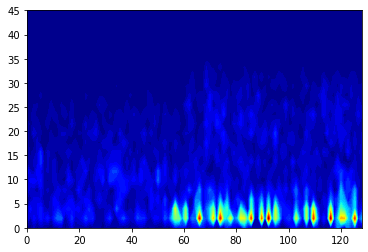

Predicted: 


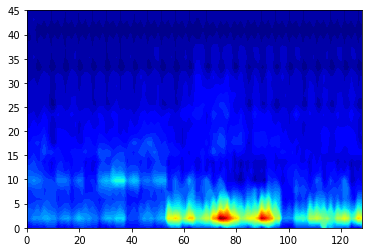

epoch [485/500], train loss:0.3900
epoch [485/500], val loss:1.5833
epoch [485/500], train accuracy:0.8966
epoch [485/500], val accuracy:0.6765


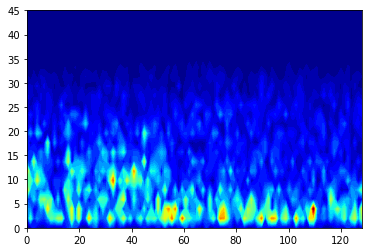

Predicted: 


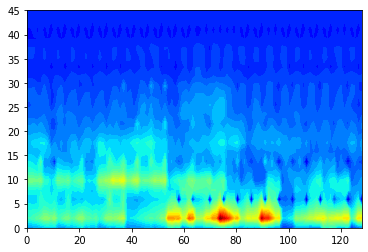

epoch [486/500], train loss:0.3888
epoch [486/500], val loss:1.5836
epoch [486/500], train accuracy:0.9009
epoch [486/500], val accuracy:0.6618


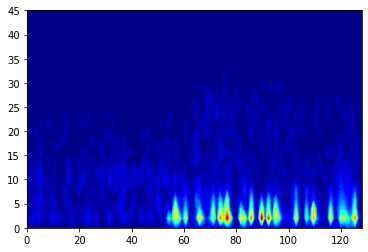

Predicted: 


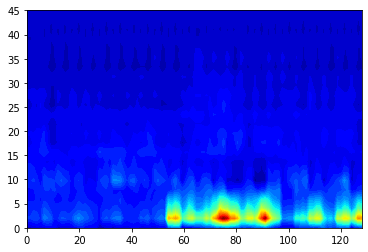

epoch [487/500], train loss:0.3939
epoch [487/500], val loss:1.5830
epoch [487/500], train accuracy:0.8879
epoch [487/500], val accuracy:0.6765


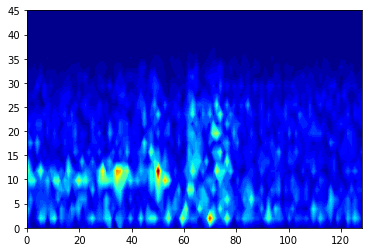

Predicted: 


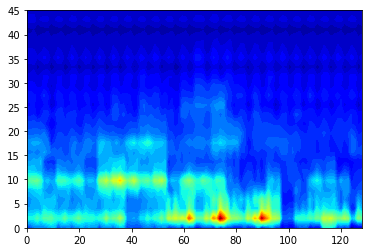

epoch [488/500], train loss:0.3935
epoch [488/500], val loss:1.5831
epoch [488/500], train accuracy:0.9052
epoch [488/500], val accuracy:0.6765


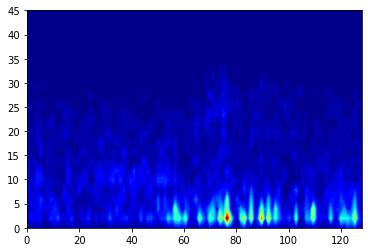

Predicted: 


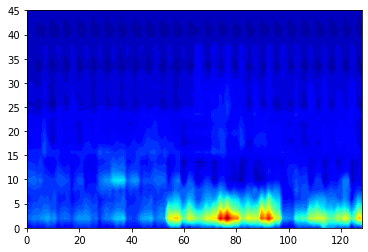

epoch [489/500], train loss:0.3901
epoch [489/500], val loss:1.5836
epoch [489/500], train accuracy:0.8966
epoch [489/500], val accuracy:0.6471


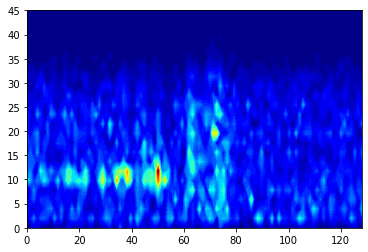

Predicted: 


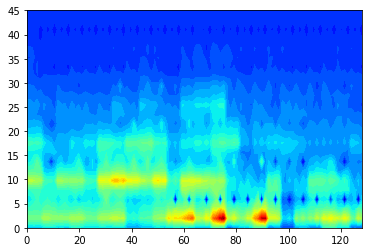

epoch [490/500], train loss:0.3864
epoch [490/500], val loss:1.5828
epoch [490/500], train accuracy:0.9181
epoch [490/500], val accuracy:0.6765


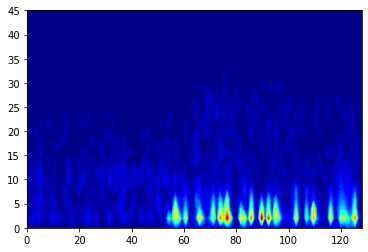

Predicted: 


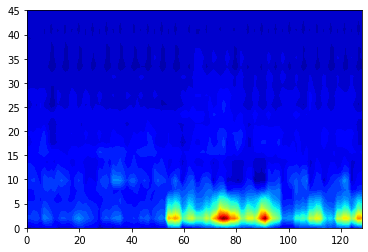

epoch [491/500], train loss:0.3873
epoch [491/500], val loss:1.5827
epoch [491/500], train accuracy:0.8836
epoch [491/500], val accuracy:0.6765


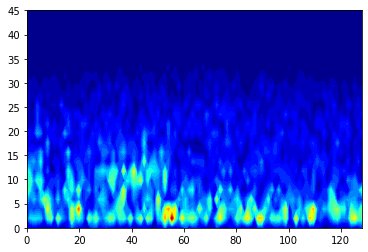

Predicted: 


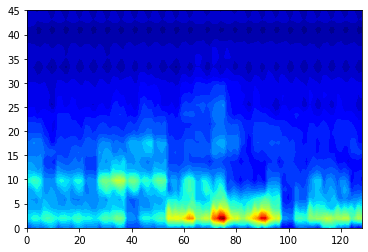

epoch [492/500], train loss:0.3877
epoch [492/500], val loss:1.5823
epoch [492/500], train accuracy:0.8966
epoch [492/500], val accuracy:0.6912


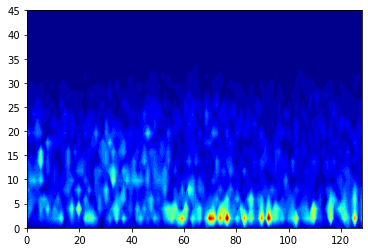

Predicted: 


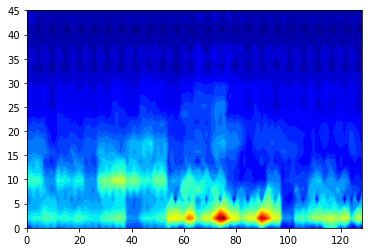

epoch [493/500], train loss:0.3880
epoch [493/500], val loss:1.5831
epoch [493/500], train accuracy:0.9224
epoch [493/500], val accuracy:0.6765


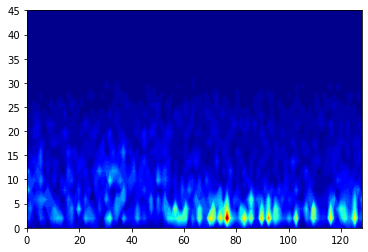

Predicted: 


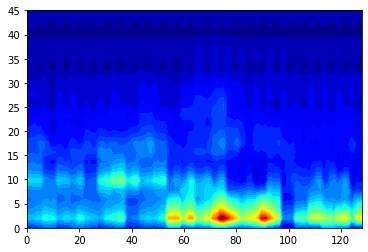

epoch [494/500], train loss:0.3881
epoch [494/500], val loss:1.5841
epoch [494/500], train accuracy:0.9095
epoch [494/500], val accuracy:0.6618


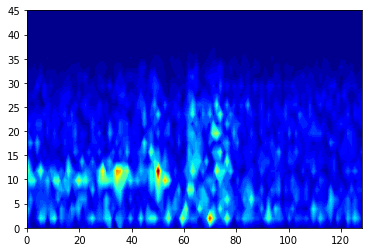

Predicted: 


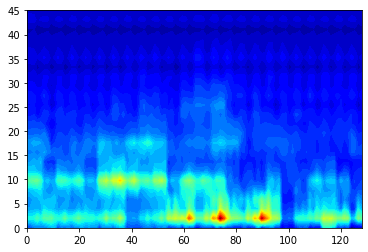

epoch [495/500], train loss:0.3865
epoch [495/500], val loss:1.5819
epoch [495/500], train accuracy:0.8922
epoch [495/500], val accuracy:0.6912


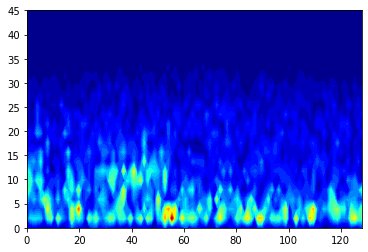

Predicted: 


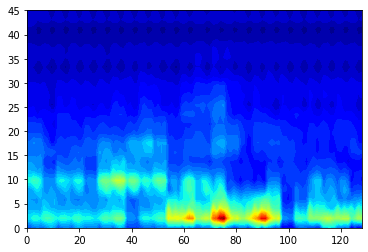

epoch [496/500], train loss:0.3817
epoch [496/500], val loss:1.5820
epoch [496/500], train accuracy:0.9138
epoch [496/500], val accuracy:0.6765


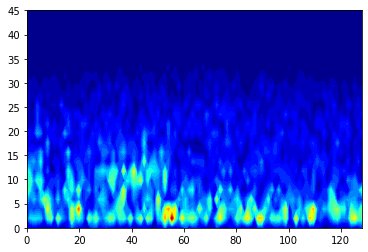

Predicted: 


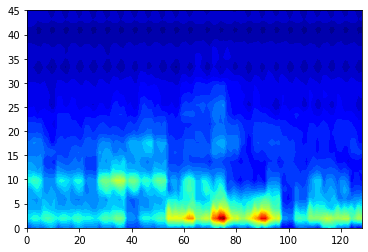

epoch [497/500], train loss:0.3871
epoch [497/500], val loss:1.5823
epoch [497/500], train accuracy:0.9095
epoch [497/500], val accuracy:0.6765


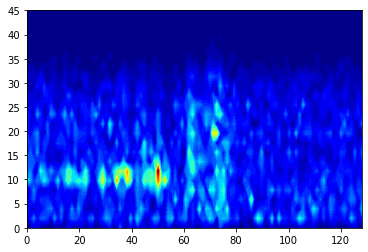

Predicted: 


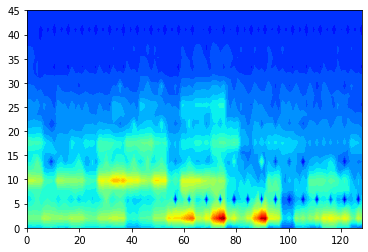

epoch [498/500], train loss:0.3883
epoch [498/500], val loss:1.5826
epoch [498/500], train accuracy:0.8879
epoch [498/500], val accuracy:0.6765


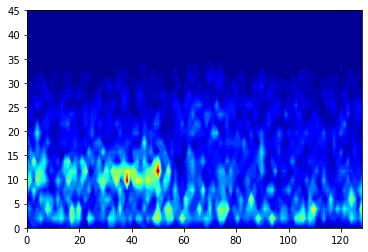

Predicted: 


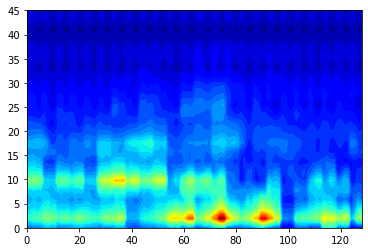

epoch [499/500], train loss:0.3856
epoch [499/500], val loss:1.5814
epoch [499/500], train accuracy:0.8922
epoch [499/500], val accuracy:0.6912


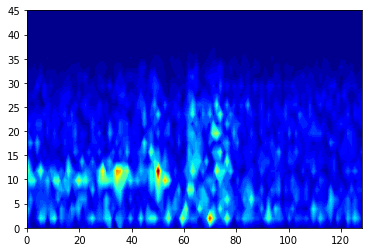

Predicted: 


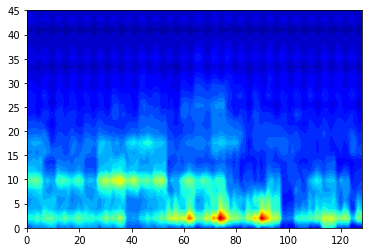

epoch [500/500], train loss:0.3843
epoch [500/500], val loss:1.5816
epoch [500/500], train accuracy:0.9095
epoch [500/500], val accuracy:0.6912


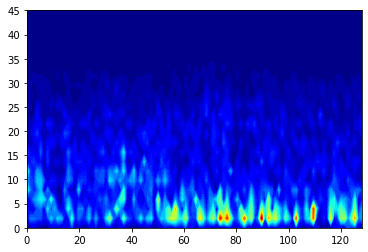

Predicted: 


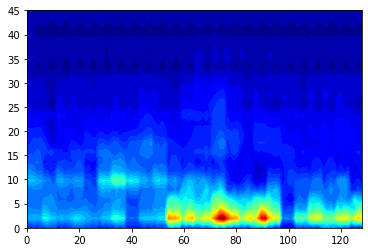

In [102]:
for epoch in range(num_epochs):
    train_loss = 0
    train_correct =0
    train_total =0
    for data in train_loader:
        img, label = data
        img = img.float().cuda()
        label=label.long().cuda()
        # ===================forward=====================
        codes, output, preds = model(img)
        _, predicted = torch.max(preds.data, 1)
        train_correct += (predicted == label).sum().item()
        train_total+= labels.size(0)
        l2_loss = criterion(output, img)
        cr_loss1 =cr_loss(preds,label)
        loss =l2_loss+cr_loss1
        # ===================backward====================
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        train_loss += loss.data
    # ===================log========================
    if epoch % 1 == 0:
        with torch.no_grad():
            val_loss =0
            val_correct =0
            val_total =0
            for data in val_loader: 
                img, label = data
                img = img.float().cuda()
                label=label.long().cuda()
                codes,output, preds  = model(img)
                _, predicted = torch.max(preds.data, 1)
                val_correct += (predicted == label).sum().item()
                val_total+= labels.size(0)
                l2_loss = criterion(output, img)
                cr_loss1 =cr_loss(preds,label)
                loss =l2_loss+cr_loss1
                val_loss += loss.data
            
            writer.add_scalar('training loss',
                            train_loss/train_total,
                            epoch)
            writer.add_scalar('validation loss',
                            val_loss/val_total,
                            epoch)
            writer.add_scalar('train accuracy',
                            train_correct/ train_total,
                            epoch)
            writer.add_scalar('val accuracy',
                            val_correct/ val_total,
                            epoch)
            print('epoch [{}/{}], train loss:{:.4f}'.format(epoch+1, num_epochs, train_loss/train_total))    
            print('epoch [{}/{}], val loss:{:.4f}'.format(epoch+1, num_epochs,val_loss/ val_total))
            print('epoch [{}/{}], train accuracy:{:.4f}'.format(epoch+1, num_epochs, train_correct/ train_total)) 
            print('epoch [{}/{}], val accuracy:{:.4f}'.format(epoch+1, num_epochs, val_correct/ val_total)) 
            plot_batch_and_outputs(img, output,show_type ='c')


## Test autoencoder's embeddings

In [89]:
codes_data =[]
labels_data =[]

In [50]:
for data in train_loader:
    img, label = data
    img = img.float().cuda()
    codes,output,preds = model(img)
    codes_data.append(codes.detach().cpu().numpy())
    labels_data.append(label.detach().cpu().numpy())
with torch.no_grad():
    for data in val_loader: 
        img, label = data
        img = img.float().cuda()
        codes,output,preds = model(img)
        codes_data.append(codes.detach().cpu().numpy())
        labels_data.append(label.detach().cpu().numpy())
       

In [34]:
X=np.concatenate(codes_data)
X =X.reshape(158,-1)
y=np.concatenate(labels_data)

In [35]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
import pandas as pd
from sklearn.model_selection import cross_val_score
from sklearn import svm
from sklearn.preprocessing import LabelEncoder
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.linear_model import ElasticNet
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from pathlib import Path

In [36]:
def build_models(X,y):    
    models = {
        'lr_l1': LogisticRegression(penalty='l1',solver='liblinear',C =1),
        'lr_l2': LogisticRegression(penalty='l2',solver='liblinear',C =1),
        'rf_7': RandomForestClassifier(n_estimators=100, max_depth=7),
        'rf_5': RandomForestClassifier(n_estimators=100, max_depth=5),
        'svm_stand_0.1': svm.SVC(C=0.1),
        'svm_stand_0.01': svm.SVC(C=0.01),
        'knn': KNeighborsClassifier(n_neighbors=10),
        'gb': GradientBoostingClassifier(max_depth=5)
    }
    for name, model in models.items():
        scores = cross_val_score(model, X, y, cv=10, scoring='roc_auc')
        print(name, f"{scores.mean():.3f}+/-{scores.std():.3f}")
    

In [37]:
build_models(X,y)

lr_l1 0.544+/-0.159
lr_l2 0.580+/-0.111
rf_7 0.547+/-0.118
rf_5 0.563+/-0.125
svm_stand_0.1 0.490+/-0.135
svm_stand_0.01 0.487+/-0.135
knn 0.480+/-0.151
gb 0.583+/-0.108


In [62]:
y.shape

(158,)